In [1242]:
import math
import pandas as pd
import numpy as np
import seaborn as sns
import matplotlib.pyplot as plt
from matplotlib import style
import matplotlib as mpl
import paste
import scipy
import anndata
import os
import umap
from sklearn.decomposition import PCA
import scanpy as sc
import warnings
import json
from PIL import Image
import torch
import seaborn
from torch import nn
import torch.nn.functional as F
import cv2
from tqdm import tqdm
from matplotlib.colors import rgb2hex
import random
from scipy import stats
from scipy.stats import wilcoxon
from sklearn.metrics import mean_squared_error
from sklearn.metrics import root_mean_squared_error
from scipy.stats import ranksums
from scipy.spatial import distance_matrix
from scipy.spatial import distance

In [2]:
import pycpd
from builtins import super
import numbers

In [93]:
import paste 
import matplotlib.patches as mpatches

In [3]:
class EMRegistration(object):
    """
    Expectation maximization point cloud registration.

    Attributes
    ----------
    X: numpy array
        NxD array of target points.

    Y: numpy array
        MxD array of source points.

    TY: numpy array
        MxD array of transformed source points.

    sigma2: float (positive)
        Initial variance of the Gaussian mixture model.

    N: int
        Number of target points.

    M: int
        Number of source points.

    D: int
        Dimensionality of source and target points

    iteration: int
        The current iteration throughout registration.

    max_iterations: int
        Registration will terminate once the algorithm has taken this
        many iterations.

    tolerance: float (positive)
        Registration will terminate once the difference between
        consecutive objective function values falls within this tolerance.

    w: float (between 0 and 1)
        Contribution of the uniform distribution to account for outliers.
        Valid values span 0 (inclusive) and 1 (exclusive).

    q: float
        The objective function value that represents the misalignment between source
        and target point clouds.

    diff: float (positive)
        The absolute difference between the current and previous objective function values.

    P: numpy array
        MxN array of probabilities.
        P[m, n] represents the probability that the m-th source point
        corresponds to the n-th target point.

    Pt1: numpy array
        Nx1 column array.
        Multiplication result between the transpose of P and a column vector of all 1s.

    P1: numpy array
        Mx1 column array.
        Multiplication result between P and a column vector of all 1s.

    Np: float (positive)
        The sum of all elements in P.

    """

    def __init__(self, X, Y, sigma2=None, max_iterations=None, tolerance=None, w=None, *args, **kwargs):
        if type(X) is not np.ndarray or X.ndim != 2:
            raise ValueError(
                "The target point cloud (X) must be at a 2D numpy array.")

        if type(Y) is not np.ndarray or Y.ndim != 2:
            raise ValueError(
                "The source point cloud (Y) must be a 2D numpy array.")

        if X.shape[1] != Y.shape[1]:
            raise ValueError(
                "Both point clouds need to have the same number of dimensions.")

        if sigma2 is not None and (not isinstance(sigma2, numbers.Number) or sigma2 <= 0):
            raise ValueError(
                "Expected a positive value for sigma2 instead got: {}".format(sigma2))

        if max_iterations is not None and (not isinstance(max_iterations, numbers.Number) or max_iterations < 0):
            raise ValueError(
                "Expected a positive integer for max_iterations instead got: {}".format(max_iterations))
        elif isinstance(max_iterations, numbers.Number) and not isinstance(max_iterations, int):
            warn("Received a non-integer value for max_iterations: {}. Casting to integer.".format(max_iterations))
            max_iterations = int(max_iterations)

        if tolerance is not None and (not isinstance(tolerance, numbers.Number) or tolerance < 0):
            raise ValueError(
                "Expected a positive float for tolerance instead got: {}".format(tolerance))

        if w is not None and (not isinstance(w, numbers.Number) or w < 0 or w >= 1):
            raise ValueError(
                "Expected a value between 0 (inclusive) and 1 (exclusive) for w instead got: {}".format(w))

        self.X = X
        self.Y = Y
        self.TY = Y
        self.sigma2 = initialize_sigma2(X, Y) if sigma2 is None else sigma2
        (self.N, self.D) = self.X.shape
        (self.M, _) = self.Y.shape
        self.tolerance = 0.001 if tolerance is None else tolerance
        self.w = 0.0 if w is None else w
        self.max_iterations = 100 if max_iterations is None else max_iterations
        self.iteration = 0
        self.diff = np.inf
        self.q = np.inf
        self.P = np.zeros((self.M, self.N))
        self.Pt1 = np.zeros((self.N, ))
        self.P1 = np.zeros((self.M, ))
        self.PX = np.zeros((self.M, self.D))
        self.Np = 0

    def register(self, callback=lambda **kwargs: None):
        """
        Perform the EM registration.

        Attributes
        ----------
        callback: function
            A function that will be called after each iteration.
            Can be used to visualize the registration process.
        
        Returns
        -------
        self.TY: numpy array
            MxD array of transformed source points.
        
        registration_parameters:
            Returned params dependent on registration method used. 
        """
        self.transform_point_cloud()
        while self.iteration < self.max_iterations and self.diff > self.tolerance:
            self.iterate()
            if callable(callback):
                kwargs = {'iteration': self.iteration,
                          'error': self.q, 'X': self.X, 'Y': self.TY}
                callback(**kwargs)

        return self.TY, self.get_registration_parameters()

    def get_registration_parameters(self):
        """
        Placeholder for child classes.
        """
        raise NotImplementedError(
            "Registration parameters should be defined in child classes.")

    def update_transform(self):
        """
        Placeholder for child classes.
        """
        raise NotImplementedError(
            "Updating transform parameters should be defined in child classes.")

    def transform_point_cloud(self):
        """
        Placeholder for child classes.
        """
        raise NotImplementedError(
            "Updating the source point cloud should be defined in child classes.")

    def update_variance(self):
        """
        Placeholder for child classes.
        """
        raise NotImplementedError(
            "Updating the Gaussian variance for the mixture model should be defined in child classes.")

    def iterate(self):
        """
        Perform one iteration of the EM algorithm.
        """
        self.expectation()
        self.maximization()
        self.iteration += 1

    def expectation(self):
        """
        Compute the expectation step of the EM algorithm.
        """
        P = np.sum((self.X[None, :, :] - self.TY[:, None, :])**2, axis=2) # (M, N)
        P = np.exp(-P/(2*self.sigma2))
        c = (2*np.pi*self.sigma2)**(self.D/2)*self.w/(1. - self.w)*self.M/self.N

        den = np.sum(P, axis = 0, keepdims = True) # (1, N)
        den = np.clip(den, np.finfo(self.X.dtype).eps, None) + c

        self.P = np.divide(P, den)
        self.Pt1 = np.sum(self.P, axis=0)
        self.P1 = np.sum(self.P, axis=1)
        self.Np = np.sum(self.P1)
        self.PX = np.matmul(self.P, self.X)

    def maximization(self):
        """
        Compute the maximization step of the EM algorithm.
        """
        self.update_transform()
        self.transform_point_cloud()
        self.update_variance()

In [4]:
def initialize_sigma2(X, Y):
    """
    Initialize the variance (sigma2).

    Attributes
    ----------
    X: numpy array
        NxD array of points for target.
    
    Y: numpy array
        MxD array of points for source.
    
    Returns
    -------
    sigma2: float
        Initial variance.
    """
    (N, D) = X.shape
    (M, _) = Y.shape
    diff = X[None, :, :] - Y[:, None, :]
    err = diff ** 2
    return np.sum(err) / (D * M * N)
    
def gaussian_kernel(X, beta, Y=None):
    if Y is None:
        Y = X
    diff = X[:, None, :] - Y[None, :,  :]
    diff = np.square(diff)
    diff = np.sum(diff, 2)
    return np.exp(-diff / (2 * beta**2))

def low_rank_eigen(G, num_eig):
    """
    Calculate num_eig eigenvectors and eigenvalues of gaussian matrix G.
    Enables lower dimensional solving.
    """
    S, Q = np.linalg.eigh(G)
    eig_indices = list(np.argsort(np.abs(S))[::-1][:num_eig])
    Q = Q[:, eig_indices]  # eigenvectors
    S = S[eig_indices]  # eigenvalues.
    return Q, S

In [5]:
class DeformableRegistration(EMRegistration):
    """
    Deformable registration.

    Attributes
    ----------
    alpha: float (positive)
        Represents the trade-off between the goodness of maximum likelihood fit and regularization.

    beta: float(positive)
        Width of the Gaussian kernel.
    
    low_rank: bool
        Whether to use low rank approximation.
    
    num_eig: int
        Number of eigenvectors to use in lowrank calculation.
    """

    def __init__(self, alpha=None, beta=None, low_rank=False, num_eig=100, *args, **kwargs):
        super().__init__(*args, **kwargs)
        if alpha is not None and (not isinstance(alpha, numbers.Number) or alpha <= 0):
            raise ValueError(
                "Expected a positive value for regularization parameter alpha. Instead got: {}".format(alpha))

        if beta is not None and (not isinstance(beta, numbers.Number) or beta <= 0):
            raise ValueError(
                "Expected a positive value for the width of the coherent Gaussian kerenl. Instead got: {}".format(beta))

        self.alpha = 2 if alpha is None else alpha
        self.beta = 2 if beta is None else beta
        self.W = np.zeros((self.M, self.D))
        self.G = gaussian_kernel(self.Y, self.beta)
        self.low_rank = low_rank
        self.num_eig = num_eig
        if self.low_rank is True:
            self.Q, self.S = low_rank_eigen(self.G, self.num_eig)
            self.inv_S = np.diag(1./self.S)
            self.S = np.diag(self.S)
            self.E = 0.

    def update_transform(self):
        """
        Calculate a new estimate of the deformable transformation.
        See Eq. 22 of https://arxiv.org/pdf/0905.2635.pdf.

        """
        if self.low_rank is False:
            A = np.dot(np.diag(self.P1), self.G) + \
                self.alpha * self.sigma2 * np.eye(self.M)
            B = self.PX - np.dot(np.diag(self.P1), self.Y)
            self.W = np.linalg.solve(A, B)

        elif self.low_rank is True:
            # Matlab code equivalent can be found here:
            # https://github.com/markeroon/matlab-computer-vision-routines/tree/master/third_party/CoherentPointDrift
            dP = np.diag(self.P1)
            dPQ = np.matmul(dP, self.Q)
            F = self.PX - np.matmul(dP, self.Y)

            self.W = 1 / (self.alpha * self.sigma2) * (F - np.matmul(dPQ, (
                np.linalg.solve((self.alpha * self.sigma2 * self.inv_S + np.matmul(self.Q.T, dPQ)),
                                (np.matmul(self.Q.T, F))))))
            QtW = np.matmul(self.Q.T, self.W)
            self.E = self.E + self.alpha / 2 * np.trace(np.matmul(QtW.T, np.matmul(self.S, QtW)))

    def transform_point_cloud(self, Y=None):
        """
        Update a point cloud using the new estimate of the deformable transformation.

        Attributes
        ----------
        Y: numpy array, optional
            Array of points to transform - use to predict on new set of points.
            Best for predicting on new points not used to run initial registration.
                If None, self.Y used.
        
        Returns
        -------
        If Y is None, returns None.
        Otherwise, returns the transformed Y.
                

        """
        self.W[:,2:]=0
        if Y is not None:
            G = gaussian_kernel(X=Y, beta=self.beta, Y=self.Y)
            return Y + np.dot(G, self.W)
        else:
            if self.low_rank is False:
                self.TY = self.Y + np.dot(self.G, self.W)

            elif self.low_rank is True:
                self.TY = self.Y + np.matmul(self.Q, np.matmul(self.S, np.matmul(self.Q.T, self.W)))
                return


    def update_variance(self):
        """
        Update the variance of the mixture model using the new estimate of the deformable transformation.
        See the update rule for sigma2 in Eq. 23 of of https://arxiv.org/pdf/0905.2635.pdf.

        """
        qprev = self.sigma2

        # The original CPD paper does not explicitly calculate the objective functional.
        # This functional will include terms from both the negative log-likelihood and
        # the Gaussian kernel used for regularization.
        self.q = np.inf

        xPx = np.dot(np.transpose(self.Pt1), np.sum(
            np.multiply(self.X, self.X), axis=1))
        yPy = np.dot(np.transpose(self.P1),  np.sum(
            np.multiply(self.TY, self.TY), axis=1))
        trPXY = np.sum(np.multiply(self.TY, self.PX))

        self.sigma2 = (xPx - 2 * trPXY + yPy) / (self.Np * self.D)

        if self.sigma2 <= 0:
            self.sigma2 = self.tolerance / 10

        # Here we use the difference between the current and previous
        # estimate of the variance as a proxy to test for convergence.
        self.diff = np.abs(self.sigma2 - qprev)

    def get_registration_parameters(self):
        """
        Return the current estimate of the deformable transformation parameters.


        Returns
        -------
        self.G: numpy array
            Gaussian kernel matrix.

        self.W: numpy array
            Deformable transformation matrix.
        """
        return self.G, self.W

In [6]:
def apply_homography(coordinates, H):
    """
    Apply a 3x3 homography matrix to 2D coordinates.

    :param coordinates: A numpy array of shape (n, 2) containing 2D coordinates.
    :param H: A numpy array of shape (3, 3) representing the homography matrix.
    :return: A numpy array of shape (n, 2) with transformed coordinates.
    """
    # Convert (x, y) to homogeneous coordinates (x, y, 1)
    n = coordinates.shape[0]
    homogeneous_coords = np.hstack((coordinates, np.ones((n, 1))))

    # Apply the homography matrix
    transformed_homogeneous = np.dot(homogeneous_coords, H.T)

    # Convert back from homogeneous coordinates (x', y', w') to (x'/w', y'/w')
    transformed_coords = transformed_homogeneous[:, :2] / transformed_homogeneous[:, [2]]

    return transformed_coords

# Functions

In [7]:
def get_library_id(adata):
    assert 'spatial' in adata.uns, "spatial not present in adata.uns"
    library_ids = adata.uns['spatial'].keys()
    try:
        library_id = list(library_ids)[0]
        return library_id
    except IndexError:
        logger.error('No library_id found in adata')

def get_scalefactors(adata, library_id=None):
    if library_id is None:
        library_id = get_library_id(adata)
    try:
        scalef = adata.uns['spatial'][library_id]['scalefactors']
        return scalef
    except IndexError:
        logger.error('scalefactors not found in adata')

def get_spot_diameter_in_pixels(adata, library_id=None):
    scalef = get_scalefactors(adata, library_id=library_id) 
    try:
        spot_diameter = scalef['spot_diameter_fullres']
        return spot_diameter    
    except TypeError:
        pass
    except KeyError:
        logger.error('spot_diameter_fullres not found in adata')

In [8]:
def find_matching_indices(list1, list2):
    """
    Finds indices of matching elements between two lists of possibly different lengths and returns a 2D NumPy array.

    :param list1: The first list.
    :param list2: The second list.
    :return: A 2D NumPy array where each row contains the indices of matching elements (index_list1, index_list2).
    """
    # Determine which list is shorter
    if len(list1) <= len(list2):
        shorter, longer = list1, list2
        primary_index_is_list1 = True
    else:
        shorter, longer = list2, list1
        primary_index_is_list1 = False

    # Using a list to store matching index pairs
    matching_indices = []

    # Iterate over the shorter list to find matches in the longer list
    for idx_short, value in enumerate(shorter):
        try:
            idx_long = longer.index(value)  # Find the first occurrence in the longer list
            if primary_index_is_list1:
                matching_indices.append([idx_short, idx_long])
            else:
                matching_indices.append([idx_long, idx_short])
        except ValueError:
            continue  # Continue if the value is not found in the longer list

    # Convert the list of indices to a 2D NumPy array
    return np.array(matching_indices, dtype=int)

In [9]:
def find_homography_translation_rotation(src_points, dst_points):
    """
    Find the homography between two sets of coordinates with only translation and rotation.

    :param src_points: A numpy array of shape (n, 2) containing source coordinates.
    :param dst_points: A numpy array of shape (n, 2) containing destination coordinates.
    :return: A 3x3 homography matrix.
    """
    # Ensure the points are in the correct shape
    assert src_points.shape == dst_points.shape
    assert src_points.shape[1] == 2

    # Calculate the centroids of the point sets
    src_centroid = np.mean(src_points, axis=0)
    dst_centroid = np.mean(dst_points, axis=0)

    # Center the points around the centroids
    centered_src_points = src_points - src_centroid
    centered_dst_points = dst_points - dst_centroid

    # Calculate the covariance matrix
    H = np.dot(centered_src_points.T, centered_dst_points)

    # Singular Value Decomposition (SVD)
    U, S, Vt = np.linalg.svd(H)

    # Calculate the rotation matrix
    R = np.dot(Vt.T, U.T)

    # Ensure a proper rotation matrix (det(R) = 1)
    if np.linalg.det(R) < 0:
        Vt[-1, :] *= -1
        R = np.dot(Vt.T, U.T)

    # Calculate the translation vector
    t = dst_centroid - np.dot(R, src_centroid)

    # Construct the homography matrix
    homography_matrix = np.eye(3)
    homography_matrix[0:2, 0:2] = R
    homography_matrix[0:2, 2] = t

    return homography_matrix

In [10]:
def nearest_neighbour(coords1, coords2, max_distance=20):
    paired_indices = []
    for i, coord1 in enumerate(tqdm(coords1, desc="Processing coordinates")):
        min_dist = float('inf')
        min_index = -1
        for j, coord2 in enumerate(coords2):
            dist = distance.euclidean(coord1, coord2)
            if dist < min_dist:
                min_dist = dist
                min_index = j
        if min_dist <= max_distance:
            paired_indices.append([i, min_index])
    
    return np.array(paired_indices)

In [11]:
def get_neighbors(ad, spot_idx):
    return ad.obs.loc[((abs(ad.obs['array_row'] - ad.obs.loc[spot_idx]['array_row'])==1) & (abs(ad.obs['array_col'] - ad.obs.loc[spot_idx]['array_col'])==1)) | 
           ((abs(ad.obs['array_row'] - ad.obs.loc[spot_idx]['array_row'])==0) & (abs(ad.obs['array_col'] - ad.obs.loc[spot_idx]['array_col'])==2))].index.tolist() + [spot_idx]

In [12]:
def find_nearby_points(df, max_distance=25):
    """
    For each point in the dataframe, calculate the distance to all other points and return the indices of points
    where the distance is smaller than a given value.

    :param df: A pandas DataFrame with two columns 'newx' and 'newy' containing coordinates.
    :param max_distance: The maximum distance to consider points as "nearby".
    :return: A pandas DataFrame where each row corresponds to a point and contains a list of indices of nearby points.
    """
    coords = df[['newx', 'newy']].values
    dist_matrix = distance_matrix(coords, coords)
    
    nearby_points = []
    for i in range(dist_matrix.shape[0]):
        nearby_indices = np.where(dist_matrix[i] < max_distance)[0]
        nearby_points.append(nearby_indices.tolist()) 
    
    return pd.DataFrame({'nearby_points': nearby_points}, index=df.index)

In [909]:
def get_mean_expr_by_neighbor(ad):
    mean_expression_bulk_spot = {}
    for spot_idx in tqdm(ad.obs.index):
        assort_spot_idx = get_neighbors(ad, spot_idx)
        spot_expression_data = ad[assort_spot_idx].X
    
        if not isinstance(spot_expression_data, np.ndarray):
            spot_expression_data = spot_expression_data.toarray()
    
        mean_expression = np.mean(spot_expression_data, axis=0)
        mean_expression_bulk_spot[spot_idx] = mean_expression
    
    expr = pd.DataFrame.from_dict(mean_expression_bulk_spot, orient='index', columns=ad.var_names)
    expr.reset_index(inplace=True, drop=True)
    return expr

In [969]:
def get_mean_expr_by_dist(ad):
    mean_expression_bulk_spot = {}
    nearby_points_df = find_nearby_points(ad.obs)
    for spot_idx in tqdm(ad.obs.index):
        # assort_spot_idx = get_neighbors(ad, spot_idx)
        assort_spot_idx = nearby_points_df.loc[spot_idx, 'nearby_points']
        spot_expression_data = ad[assort_spot_idx].X
    
        if not isinstance(spot_expression_data, np.ndarray):
            spot_expression_data = spot_expression_data.toarray()
    
        mean_expression = np.mean(spot_expression_data, axis=0)
        mean_expression_bulk_spot[spot_idx] = mean_expression
    expr = pd.DataFrame.from_dict(mean_expression_bulk_spot, orient='index', columns=ad.var_names)
    expr.reset_index(inplace=True, drop=True)
    return expr

In [44]:
def prepare_data(sample_name):
    ad = sc.read_h5ad(os.path.join(data_dir, sample_name+'.h5ad'))
    ad.var_names_make_unique()
    scalef = get_scalefactors(ad)['tissue_hires_scalef']
    ad_coor = np.array(ad.obsm['spatial'])*scalef
    img = ad.uns['spatial'][get_library_id(ad)]['images']['hires']
    if img.max()<1.1:
        img = (img*255).astype('uint8')

    return ad, ad_coor, img

In [20]:
def get_features(sample_name, feature_type, case_name):
    features_path=os.path.join(case_dir_omiclip, sample_name+feature_type+case_name+'.csv')
    features = pd.read_csv(features_path, index_col=0, header = None)

    return features

In [21]:
def get_pca_by_fit(tar_features, src_features):
    pca_fit_tar = pca.fit(tar_features.T)
    pca_tar = pca_fit_tar.transform(tar_features.T)
    pca_src = pca_fit_tar.transform(src_features.T)
    pca_comb_features = np.concatenate((pca_tar, pca_src))
    pca_comb_features_batch = np.array([0]*len(pca_tar) + [1]*len(pca_src))

    return pca_comb_features, pca_comb_features_batch

In [22]:
def cpd_align(ad_tar_coor, ad_src_coor, pca_comb_features, src_img, alpha=0.5):
    ad_tar_coor_z = (ad_tar_coor-ad_tar_coor.min())/(ad_tar_coor.max()-ad_tar_coor.min())
    ad_src_coor_z = (ad_src_coor-ad_src_coor.min())/(ad_src_coor.max()-ad_src_coor.min())
    pca_comb_features_z = (pca_comb_features-pca_comb_features.min())/(pca_comb_features.max()-pca_comb_features.min())
    
    target = np.concatenate((ad_tar_coor_z, pca_comb_features_z[:len(tar_features.T),:2]), axis=1)
    source = np.concatenate((ad_src_coor_z, pca_comb_features_z[len(tar_features.T):,:2]), axis=1)
    
    reg = DeformableRegistration(X=target, Y=source, low_rank=True,
                                 alpha=alpha, 
                                 max_iterations=int(1e9), tolerance=1e-9)
    TY = reg.register()[0]
    
    cpd_coor = TY[:,:2]*(ad_tar_coor.max()-ad_tar_coor.min())+ad_tar_coor.min()
    
    h = find_homography_translation_rotation(ad_src_coor, cpd_coor)
    homo_coor = apply_homography(ad_src_coor, h)
    aligned_image = cv2.warpPerspective(src_img, h, (src_img.shape[1], src_img.shape[0]))

    return cpd_coor, homo_coor, aligned_image

In [23]:
def plot_alignment(ad_tar_coor, ad_src_coor, homo_coor, pca_hex_comb, tar_features, shift=300, s=0.8, boundary_line=True):

    plt.figure(figsize=(10, 3), dpi=300)
    plt.subplot(1, 3, 1)
    plt.scatter(ad_tar_coor[:,0], ad_tar_coor[:,1], marker='o', s=s, c=pca_hex_comb[:len(tar_features.T)])
    plt.xlim([ad_tar_coor.min()-shift,ad_tar_coor.max()+shift])
    plt.ylim([ad_tar_coor.min()-shift,ad_tar_coor.max()+shift])
    
    plt.subplot(1, 3, 2)
    plt.scatter(ad_src_coor[:,0], ad_src_coor[:,1], marker='o', s=s, c=pca_hex_comb[len(tar_features.T):])
    plt.xlim([ad_tar_coor.min()-shift,ad_tar_coor.max()+shift])
    plt.ylim([ad_tar_coor.min()-shift,ad_tar_coor.max()+shift])
    
    plt.subplot(1, 3, 3)
    plt.scatter(homo_coor[:,0], homo_coor[:,1], marker='o', s=s, c=pca_hex_comb[len(tar_features.T):])
    plt.xlim([ad_tar_coor.min()-shift,ad_tar_coor.max()+shift])
    plt.ylim([ad_tar_coor.min()-shift,ad_tar_coor.max()+shift])

    if boundary_line:
        plt.axvline(x = ad_tar_coor[:,0].min(), color = 'black')
        plt.axhline(y = ad_tar_coor[:,1].min(), color = 'black')

    plt.show()

In [24]:
def plot_alignment_with_img(ad_tar_coor, ad_src_coor, homo_coor, tar_img, src_img, aligned_image, pca_hex_comb, tar_features):
    plt.figure(figsize=(10, 8), dpi=150)
    plt.subplot(1, 3, 1)
    plt.scatter(ad_tar_coor[:,0], ad_tar_coor[:,1], marker='o', alpha=0.8, s=1, c=pca_hex_comb[:len(tar_features.T)])
    plt.imshow(tar_img, origin='lower', alpha=0.3)
    
    plt.subplot(1, 3, 2)
    plt.scatter(ad_src_coor[:,0], ad_src_coor[:,1], marker='o', alpha=0.8, s=1,c=pca_hex_comb[len(tar_features.T):])
    plt.imshow(src_img, origin='lower', alpha=0.3)
    
    plt.subplot(1, 3, 3)
    plt.scatter(ad_tar_coor[:,0], ad_tar_coor[:,1], marker='o', alpha=0.2, s=1, c=pca_hex_comb[:len(tar_features.T)])
    plt.scatter(homo_coor[:,0], homo_coor[:,1], marker='+', s=1, c=pca_hex_comb[len(tar_features.T):])
    plt.imshow(aligned_image, origin='lower', alpha=0.3)

    plt.show()

In [25]:
def wirte_aligned_data(ad_src, aligned_image, homo_coor,  save_name):
    ad_src_align = ad_src.copy()
    ad_src_align.obsm['spatial'] = homo_coor/ad_src.uns['spatial'][get_library_id(ad_src)]['scalefactors']['tissue_hires_scalef']
    ad_src_align.uns['spatial'][get_library_id(ad_src)]['images']['hires'] = aligned_image
    ad_src_align.write_h5ad(case_dir_omiclip+save_name)

In [1514]:
def filter_norm_log1p(ad):
    # sc.pp.filter_cells(ad, min_counts=100)
    # sc.pp.filter_cells(ad, max_counts=35000)
    # sc.pp.filter_genes(ad, min_cells=10)
    # sc.pp.filter_genes(ad, min_counts=15)
    sc.pp.normalize_total(ad)
    sc.pp.log1p(ad)
    return ad

In [1528]:
def get_heg_of_hvg(ad, gene_num=500):
    sc.pp.highly_variable_genes(ad)
    ad_hvg = ad[:, ad.var.highly_variable]
    ad_hvg.var['mean_expression'] = np.ravel(ad_hvg.X.mean(0))
    ad_heg_of_hvg = pd.DataFrame(ad_hvg.var.nlargest(gene_num, 'mean_expression')['mean_expression'])

    return ad_heg_of_hvg

In [96]:
def paste_align(src_sample_name):
    
    ad_tar_paste = sc.read_h5ad(os.path.join(data_dir, tar_sample_name+'.h5ad'))
    ad_tar_paste.var_names_make_unique()
    sc.pp.filter_genes(ad_tar_paste, min_counts = 15)
    sc.pp.filter_cells(ad_tar_paste, min_counts = 100)
    del ad_tar_paste.uns
    
    ad_src_paste = sc.read_h5ad(os.path.join(data_dir, src_sample_name+'.h5ad'))
    ad_src_paste.var_names_make_unique()
    sc.pp.filter_genes(ad_src_paste, min_counts = 15)
    sc.pp.filter_cells(ad_src_paste, min_counts = 100)
    del ad_src_paste.uns
    
    pi12 = paste.pairwise_align(ad_tar_paste, ad_src_paste)
    
    # To visualize the alignment you can stack the slices 
    # according to the alignment pi
    slices, pis = [ad_tar_paste, ad_src_paste], [pi12]
    new_slices = paste.stack_slices_pairwise(slices, pis)

    
    slice_colors = ['#e41a1c','#377eb8']
    plt.figure(figsize=(5,5))
    for i in range(len(new_slices)):
        paste.plot_slice(new_slices[i],slice_colors[i],s=50)
    plt.legend(handles=[mpatches.Patch(color=slice_colors[0], label='1'),mpatches.Patch(color=slice_colors[1], label='2')])
    # plt.gca().invert_yaxis()
    # plt.axis('off')
    # plt.savefig(save_path+'paste_aligment.pdf')
    plt.show()
    
    new_slices[0].write_h5ad(paste_path+'paste_aligment_target_'+src_sample_name+'.h5ad')
    new_slices[1].write_h5ad(paste_path+'paste_aligment_source_'+src_sample_name+'.h5ad')

In [1219]:
def calculate_rmse(genes, tar_mean_expr, src_align_mean_expr, matches):
    rmse_df = pd.DataFrame()
    for gene in tqdm(genes):
        rmse = root_mean_squared_error(tar_mean_expr.loc[matches[:,1], gene], src_align_mean_expr.loc[matches[:,0], gene])
        rmse_df.loc[gene, 'rmse'] = rmse
    return rmse_df

In [1376]:
def calculate_mse(genes, tar_mean_expr, src_align_mean_expr, matches):
    mse_df = pd.DataFrame()
    for gene in tqdm(genes):
        mse = mean_squared_error(tar_mean_expr.loc[matches[:,1], gene], src_align_mean_expr.loc[matches[:,0], gene])
        mse_df.loc[gene, 'mse'] = mse
    return mse_df

In [621]:
def rotate_coordinates(coords, angle_degrees, x_max=None, y_max=None, center=[0, 0], positive_shift=True):
    """
    Rotate a set of 2D coordinates around a specified center by a given angle, ensure no negative values,
    apply masking based on a percentile cutoff along the x-axis, and adjust the cutoff to meet a specified
    range of excluded coordinates.

    :param coords: A numpy array of shape (n, 2) containing 2D coordinates.
    :param angle_degrees: The angle in degrees by which to rotate the coordinates.
    :param center: A tuple or list of two elements specifying the rotation center (cx, cy).
    :param x_max: Maximum value for x coordinates after rotation and positive shift.
    :param y_max: Maximum value for y coordinates after rotation and positive shift.
    :param positive_shift: Boolean to decide whether to shift the results to avoid negative values.
    :param cut_range: A tuple (min, max) specifying the desired range for the percentage of excluded coordinates.
    :return: A tuple containing:
             - A numpy array of shape (m, 2) with the rotated and filtered coordinates.
             - The indices of the kept coordinates after filtering.
             - The coordinates that were excluded by the masking.
             - The full transformation matrix applied.
             - The final cut percentage.
    """
    cx, cy = center
    angle_radians = np.radians(angle_degrees)
    
    # Define the rotation matrix
    cos_angle = np.cos(angle_radians)
    sin_angle = np.sin(angle_radians)
    rotation_matrix = np.array([
        [cos_angle, -sin_angle],
        [sin_angle,  cos_angle]
    ])
    
    # Translation to bring the center to the origin
    translate_to_origin = np.array([-cx, -cy])
    translate_back_to_center = np.array([cx, cy])
    
    # Calculate rotated coordinates
    shifted_coords = coords + translate_to_origin
    rotated_coords = np.dot(shifted_coords, rotation_matrix.T)
    final_coords = rotated_coords + translate_back_to_center
    
    # Calculate shift to ensure no negative values
    shift_x, shift_y = 0, 0
    if positive_shift:
        min_coords = final_coords.min(axis=0)
        shift_x = -min_coords[0] if min_coords[0] < 0 else 0
        shift_y = -min_coords[1] if min_coords[1] < 0 else 0
        final_coords += np.array([shift_x, shift_y])

    # Adjust coordinates to not exceed maximum values
    if x_max is not None:
        max_x = final_coords[:, 0].max()
        if max_x > x_max:
            shift_x += x_max - max_x
            final_coords += np.array([shift_x, 0])

    if y_max is not None:
        max_y = final_coords[:, 1].max()
        if max_y > y_max:
            shift_y += y_max - max_y
            final_coords += np.array([0, shift_y])

    # Create the full transformation matrix
    translation_matrix = np.array([
        [1, 0, translate_to_origin[0]],
        [0, 1, translate_to_origin[1]],
        [0, 0, 1]
    ])
    homogeneous_rotation_matrix = np.array([
        [cos_angle, -sin_angle, 0],
        [sin_angle, cos_angle, 0],
        [0, 0, 1]
    ])
    final_translation_matrix = np.array([
        [1, 0, translate_back_to_center[0] + shift_x],
        [0, 1, translate_back_to_center[1] + shift_y],
        [0, 0, 1]
    ])
    
    full_transformation_matrix = np.dot(np.dot(final_translation_matrix, homogeneous_rotation_matrix), translation_matrix)

    return full_transformation_matrix

In [627]:
def rotate_adata_90(sample_name):
    ad = sc.read_h5ad(os.path.join(data_dir, sample_name+'.h5ad'))
    ad.var_names_make_unique()
    sc.pl.spatial(ad, color='COL1A1')
    
    hires_scalef = get_scalefactors(ad)['tissue_hires_scalef']
    lowres_scalef = get_scalefactors(ad)['tissue_lowres_scalef']
    ad_coor_hires = np.array(ad.obsm['spatial'])*hires_scalef
    ad_coor_lowres = np.array(ad.obsm['spatial'])*lowres_scalef
    hires_img = ad.uns['spatial'][get_library_id(ad)]['images']['hires']
    lowres_img = ad.uns['spatial'][get_library_id(ad)]['images']['lowres']
    
    ad_rot = ad.copy()
    coor_transformation_matrix = rotate_coordinates(ad.obsm['spatial'], angle_degrees=90)
    ad_rot.obsm['spatial'] = apply_homography(ad.obsm['spatial'], coor_transformation_matrix)
    
    hires_img_transformation_matrix = rotate_coordinates(ad_coor_hires, angle_degrees=90)
    lowres_img_transformation_matrix = rotate_coordinates(ad_coor_lowres, angle_degrees=90)
    ad_rot.uns['spatial'][get_library_id(ad_rot)]['images']['hires'] = cv2.warpPerspective(hires_img, hires_img_transformation_matrix, (hires_img.shape[1], hires_img.shape[0]))
    ad_rot.uns['spatial'][get_library_id(ad_rot)]['images']['lowres'] = cv2.warpPerspective(lowres_img, lowres_img_transformation_matrix, (lowres_img.shape[1], lowres_img.shape[0]))
    sc.pl.spatial(ad_rot, color='COL1A1')
    ad_rot.write_h5ad(os.path.join(data_dir, sample_name+'_rotate90.h5ad'))

In [15]:
data_dir = '/condo/wanglab/shared/wxc/clip/data/human/ST_data/data31_spatial_fresh_frozen_35sample/'

In [16]:
case_dir = '/condo/wanglab/shared/wxc/clip/data/human/ST_data/simulation_data/case_study/data31_spatial_fresh_frozen_35sample/'

In [17]:
pca = PCA(n_components=3)

In [18]:
case_dir_omiclip = case_dir+'omiclip/'
if not os.path.exists(case_dir_omiclip):
    os.makedirs(case_dir_omiclip)

In [ ]:
paste_path = case_dir+'paste/'

In [1308]:
tar_sample_name = 'V10F24-050_A1'
ad_tar, ad_tar_coor, tar_img =  prepare_data(tar_sample_name)

### Generate data for finetune

In [62]:
datapath='/condo/wanglab/shared/wxc/clip/data/human/ST_data/all_top50_heg_remove_dots_dash_hk_genes_no_comma_train_2157867.csv'
DATAFRAME = pd.read_csv(datapath,index_col=0)
target_df=DATAFRAME[DATAFRAME['sample_name'].isin([tar_sample_name])]
target_df['img_path']='/condo/wanglab/shared/wxc/clip/data/human/ST_data/images/patches/'+target_df['img_idx']+'.png'
target_df

/tmp/ipykernel_2737625/3149266822.py:4: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  target_df['img_path']='/condo/wanglab/shared/wxc/clip/data/human/ST_data/images/patches/'+target_df['img_idx']+'.png'


,label,sample_name,dataset,img_idx,img_path
V10F24-050_A1_AAACAAGTATCTCCCA-1,MALAT1 MYL9 DES TPM1 CALD1 CNN1 TAGLN MYL6 CKB...,V10F24-050_A1,data31_spatial_fresh_frozen_35sample,V10F24-050_A1_AAACAAGTATCTCCCA-1_hires,/condo/wanglab/shared/wxc/clip/data/human/ST_d...
V10F24-050_A1_AAACACCAATAACTGC-1,RGS1 LMCD1 ZNF721 CISD2 ERGIC1 CDK1 SERPINA1 P...,V10F24-050_A1,data31_spatial_fresh_frozen_35sample,V10F24-050_A1_AAACACCAATAACTGC-1_hires,/condo/wanglab/shared/wxc/clip/data/human/ST_d...
V10F24-050_A1_AAACAGCTTTCAGAAG-1,MALAT1 IGKC RPL15 CTSD MXRA8 ACTR2 ARPC4 RPL37...,V10F24-050_A1,data31_spatial_fresh_frozen_35sample,V10F24-050_A1_AAACAGCTTTCAGAAG-1_hires,/condo/wanglab/shared/wxc/clip/data/human/ST_d...
V10F24-050_A1_AAACAGGGTCTATATT-1,MALAT1 RPS12 TCEANC ZNF445 CLEC3B BMPR1B COL1A...,V10F24-050_A1,data31_spatial_fresh_frozen_35sample,V10F24-050_A1_AAACAGGGTCTATATT-1_hires,/condo/wanglab/shared/wxc/clip/data/human/ST_d...
V10F24-050_A1_AAACAGTGTTCCTGGG-1,MALAT1 MYL9 ACTG2 MYH11 DES TAGLN CALD1 TPM2 M...,V10F24-050_A1,data31_spatial_fresh_frozen_35sample,V10F24-050_A1_AAACAGTGTTCCTGGG-1_hires,/condo/wanglab/shared/wxc/clip/data/human/ST_d...
...,...,...,...,...,...
V10F24-050_A1_TTGTTGTGTGTCAAGA-1,MALAT1 PRRC2C TPM1 NUCB1 AKR7A2 PNRC2 LDLRAP1 ...,V10F24-050_A1,data31_spatial_fresh_frozen_35sample,V10F24-050_A1_TTGTTGTGTGTCAAGA-1_hires,/condo/wanglab/shared/wxc/clip/data/human/ST_d...
V10F24-050_A1_TTGTTTCACATCCAGG-1,MALAT1 MYL9 CALD1 ACTG2 DES TPM1 MYL6 TPM2 TAG...,V10F24-050_A1,data31_spatial_fresh_frozen_35sample,V10F24-050_A1_TTGTTTCACATCCAGG-1_hires,/condo/wanglab/shared/wxc/clip/data/human/ST_d...
V10F24-050_A1_TTGTTTCATTAGTCTA-1,MALAT1 MYH11 CALD1 TCEANC CKB C1QA TNS1 MYL6 C...,V10F24-050_A1,data31_spatial_fresh_frozen_35sample,V10F24-050_A1_TTGTTTCATTAGTCTA-1_hires,/condo/wanglab/shared/wxc/clip/data/human/ST_d...
V10F24-050_A1_TTGTTTCCATACAACT-1,MALAT1 TCEANC RPL10 ITGB1BP1 ARL5A CD24 HNRNPA...,V10F24-050_A1,data31_spatial_fresh_frozen_35sample,V10F24-050_A1_TTGTTTCCATACAACT-1_hires,/condo/wanglab/shared/wxc/clip/data/human/ST_d...


In [63]:
data_dir+tar_sample_name+'_training_df.csv'

'/condo/wanglab/shared/wxc/clip/data/human/ST_data/data31_spatial_fresh_frozen_35sample/V10F24-050_A1_training_df.csv'

In [64]:
target_df.to_csv(data_dir+tar_sample_name+'_training_df.csv')

### Generate finetune features

In [50]:
from open_clip import create_model_from_pretrained, get_tokenizer
import open_clip

In [51]:
PATCH_DIR = "/condo/wanglab/shared/wxc/clip/data/human/ST_data/images/patches/"
DEVICE = "cuda"

In [52]:
tokenizer = get_tokenizer('coca_ViT-L-14')
model_dir = "2024_08_19-20_20_48-model_coca_ViT-L-14-lr_5e-06-b_64-j_8-p_amp"
epoch_n = "epoch_10.pt"
model_path = os.path.join("/condo/wanglab/shared/wxc/clip/models/open_clip-main/logs", model_dir, "checkpoints", epoch_n)
model, preprocess = create_model_from_pretrained("coca_ViT-L-14", device = DEVICE, pretrained=model_path)

In [53]:
house_keeping_genes = pd.read_csv("/condo/wanglab/shared/wxc/clip/data/human/ST_data/housekeeping_genes.csv", index_col = 0)

In [54]:
k=50

In [55]:
def generate_features_finetune10(sample_name):
    ad = sc.read_h5ad(os.path.join(data_dir, sample_name+'.h5ad'))
    ad = ad[:,~ad.var.index.str.contains('.',regex=False)]
    ad = ad[:,~ad.var.index.str.contains('-',regex=False)]
    ad = ad[:,~ad.var.index.isin(house_keeping_genes['genesymbol'])]
    expr = pd.DataFrame(ad.X.todense(), index=ad.obs.index + '_hires', columns=ad.var.index)
    top_k_genes = expr.apply(lambda s, n: pd.Series(s.nlargest(n).index), axis=1, n=k)
    top_k_genes_str = pd.DataFrame()
    top_k_genes_str['label'] = top_k_genes[top_k_genes.columns].astype(str).apply(lambda x: ' '.join(x), axis = 1)
    
    text_feature_path = os.path.join(case_dir_omiclip+sample_name+'_text_feature_finetune10.csv')
    image_feature_path = os.path.join(case_dir_omiclip+sample_name+'_image_feature_finetune10.csv')
    text_features = pd.DataFrame()
    image_features = pd.DataFrame()
    warnings.simplefilter(action='ignore')
    for patch_idx in tqdm(ad.obs.index):
    
        text = top_k_genes_str[top_k_genes_str.index==patch_idx + '_hires']['label'].values[0]
        text_input = tokenizer([text], context_length=76).to(DEVICE)
        with torch.no_grad():
            text_features[patch_idx] = model.encode_text(text_input).cpu().detach().numpy()[0]
    
        image = Image.open(os.path.join(PATCH_DIR, patch_idx+'_hires.png'))
        image_input = torch.stack([preprocess(image)]).to(DEVICE)
        with torch.no_grad():
            image_features[patch_idx] = model.encode_image(image_input).cpu().detach().numpy()[0]
    
    text_features.to_csv(text_feature_path, header=None)
    image_features.to_csv(image_feature_path, header=None)

In [56]:
generate_features_finetune10(tar_sample_name)

/condo/wanglab/hmaiwxc/anaconda3/envs/clip/lib/python3.9/site-packages/anndata/_core/anndata.py:1820: UserWarning: Variable names are not unique. To make them unique, call `.var_names_make_unique`.
  utils.warn_names_duplicates("var")
100%|██████████| 3427/3427 [01:50<00:00, 30.88it/s]


# V10F24-050_B1

In [1515]:
src_sample_name = 'V10F24-050_B1'
ad_src, ad_src_coor, src_img =  prepare_data(src_sample_name)

## Omiclip ST to ST

In [1516]:
case_name = '_coca_after_training20'

In [1517]:
feature_type = '_coca_txt_features'
tar_features = get_features(tar_sample_name, feature_type, case_name)
src_features = get_features(src_sample_name, feature_type, case_name)

In [1518]:
pca_comb_features, pca_comb_features_batch = get_pca_by_fit(tar_features, src_features)

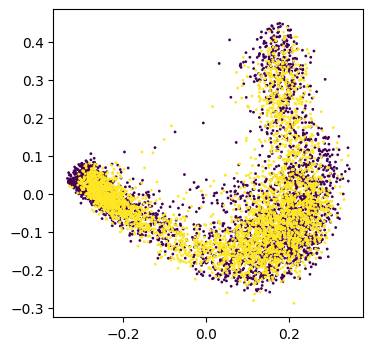

In [1519]:
plt.figure(figsize=(4,4))
plt.scatter(pca_comb_features[:,0], pca_comb_features[:,1],c=pca_comb_features_batch, s=1)

In [1520]:
pca_rgb_comb = (pca_comb_features-pca_comb_features.min(axis=0))/(pca_comb_features.max(axis=0)-pca_comb_features.min(axis=0))
pca_hex_comb = [ rgb2hex(pca_rgb_comb[i,:]) for i in range(pca_rgb_comb.shape[0]) ]

In [34]:
alpha = 0.5
cpd_coor, homo_coor, aligned_image = cpd_align(ad_tar_coor, ad_src_coor, pca_comb_features, src_img, alpha)

In [69]:
# plot_alignment_with_img(ad_tar_coor, ad_src_coor, homo_coor, tar_img, src_img, aligned_image, pca_hex_comb, tar_features)

In [68]:
shift=300
s=0.8
# plot_alignment(ad_tar_coor, ad_src_coor, homo_coor, pca_hex_comb, tar_features, shift=300, s=0.8)

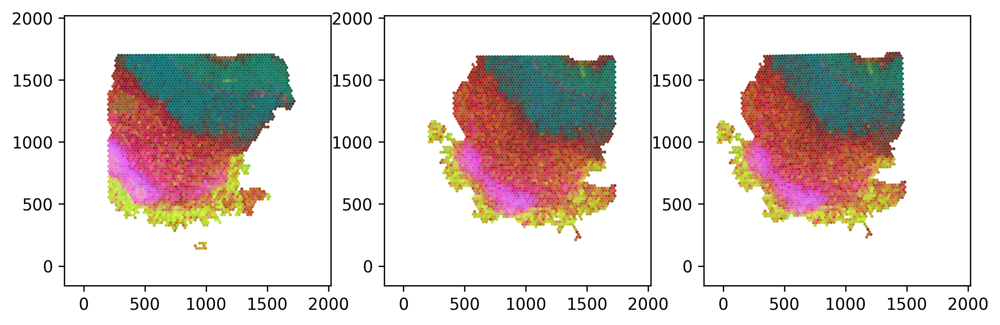

In [40]:
plot_alignment(ad_tar_coor, ad_src_coor, homo_coor, pca_hex_comb, tar_features, shift=300, s=0.8, boundary_line=False)

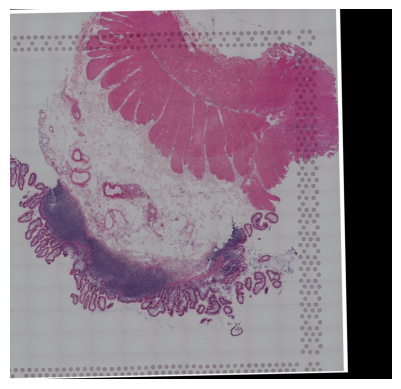

In [41]:
plt.imshow(aligned_image, origin='lower')
plt.axis('off')
plt.show()

In [47]:
save_name = 'omiclip_st_st_'+src_sample_name+'.h5ad'
wirte_aligned_data(ad_src, aligned_image, homo_coor, save_name)

## Omiclip Img to ST

In [57]:
generate_features_finetune10(src_sample_name)

100%|██████████| 3333/3333 [01:47<00:00, 31.08it/s]


In [58]:
case_name = '_finetune10'

In [59]:
tar_features = get_features(tar_sample_name, '_text_feature', case_name)
src_features = get_features(src_sample_name, '_image_feature', case_name)

In [60]:
pca_comb_features, pca_comb_features_batch = get_pca_by_fit(tar_features, src_features)

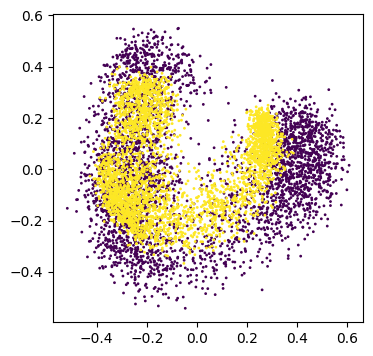

In [61]:
plt.figure(figsize=(4,4))
plt.scatter(pca_comb_features[:,0], pca_comb_features[:,1],c=pca_comb_features_batch, s=1)

In [62]:
alpha = 0.5
cpd_coor, homo_coor, aligned_image = cpd_align(ad_tar_coor, ad_src_coor, pca_comb_features, src_img, alpha)

In [70]:
# plot_alignment_with_img(ad_tar_coor, ad_src_coor, homo_coor, tar_img, src_img, aligned_image, pca_hex_comb, tar_features)

In [71]:
shift=300
s=0.8
# plot_alignment(ad_tar_coor, ad_src_coor, homo_coor, pca_hex_comb, tar_features, shift=300, s=0.8)

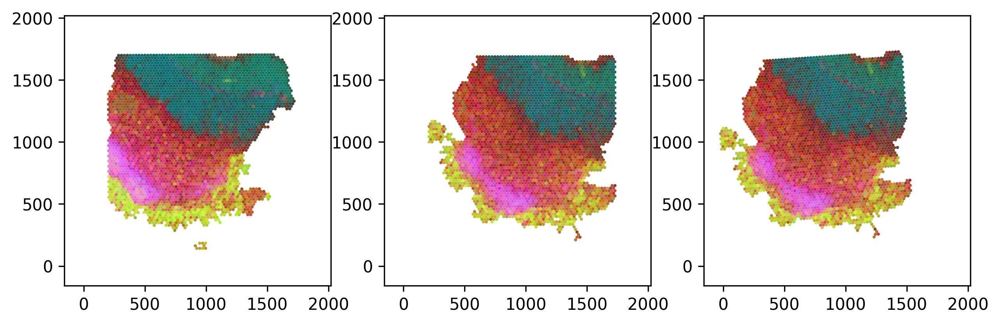

In [65]:
plot_alignment(ad_tar_coor, ad_src_coor, homo_coor, pca_hex_comb, tar_features, shift=300, s=0.8, boundary_line=False)

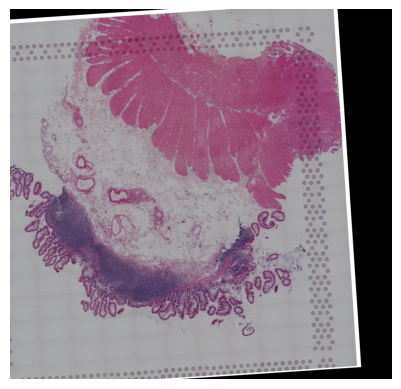

In [66]:
plt.imshow(aligned_image, origin='lower')
plt.axis('off')
plt.show()

In [72]:
save_name = 'omiclip_st_img_finetune10_'+src_sample_name+'.h5ad'
wirte_aligned_data(ad_src, aligned_image, homo_coor, save_name)

## Omiclip Results

In [1530]:
omiclip_ad_tar = ad_tar.copy()
omiclip_ad_src_align_st = sc.read_h5ad(case_dir_omiclip+'omiclip_st_st_'+src_sample_name+'.h5ad')
omiclip_ad_src_align_img_ft = sc.read_h5ad(case_dir_omiclip+'omiclip_st_img_finetune10_'+src_sample_name+'.h5ad')

In [1531]:
omiclip_ad_tar = filter_norm_log1p(omiclip_ad_tar)
omiclip_ad_src_align_st = filter_norm_log1p(omiclip_ad_src_align_st)
omiclip_ad_src_align_img_ft = filter_norm_log1p(omiclip_ad_src_align_img_ft)

In [1532]:
omiclip_ad_tar_heg_of_hvg = get_heg_of_hvg(omiclip_ad_tar)
omiclip_ad_src_heg_of_hvg = get_heg_of_hvg(omiclip_ad_src_align_st)
omiclip_genes = [value for value in omiclip_ad_tar_heg_of_hvg.index.tolist() if value in omiclip_ad_src_heg_of_hvg.index.tolist()]
len(omiclip_genes)

227

In [1476]:
omiclip_ad_tar_mean_expr = get_mean_expr_by_neighbor(omiclip_ad_tar)
omiclip_ad_src_mean_expr = get_mean_expr_by_neighbor(omiclip_ad_src_align_st)

100%|██████████| 3333/3333 [00:12<00:00, 270.47it/s]


In [1477]:
scalef_tar = get_scalefactors(omiclip_ad_tar)['tissue_hires_scalef']
scalef_src = get_scalefactors(omiclip_ad_src)['tissue_hires_scalef']
omiclip_matches_st = nearest_neighbour(omiclip_ad_src_align_st.obsm['spatial']*scalef_src, omiclip_ad_tar.obsm['spatial']*scalef_tar)
omiclip_matches_img_ft = nearest_neighbour(omiclip_ad_src_align_img_ft.obsm['spatial']*scalef_src, omiclip_ad_tar.obsm['spatial']*scalef_tar)

Processing coordinates: 100%|██████████| 3333/3333 [00:45<00:00, 72.50it/s]


## Paste

Using selected backend cpu. If you want to use gpu, set use_gpu = True.


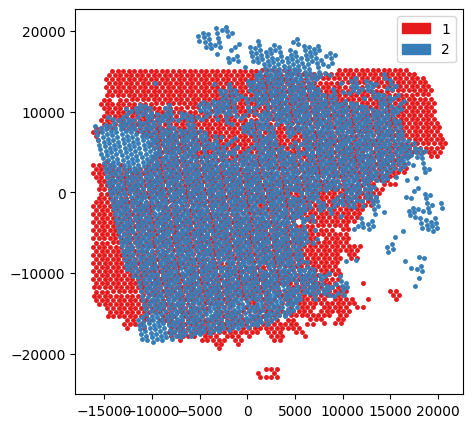

In [99]:
paste_align(src_sample_name)

In [1478]:
paste_tar_ad = sc.read_h5ad(paste_path+'paste_aligment_target_'+src_sample_name+'.h5ad')
paste_align_ad = sc.read_h5ad(paste_path+'paste_aligment_source_'+src_sample_name+'.h5ad')
paste_tar_ad = filter_norm_log1p(paste_tar_ad)
paste_align_ad = filter_norm_log1p(paste_align_ad)

In [1479]:
ad_src = sc.read_h5ad(os.path.join(data_dir, src_sample_name+'.h5ad'))
paste_shared_index = find_matching_indices(ad_src.obs.index.to_list(), paste_align_ad.obs.index.to_list())
paste_tar_coor = (paste_tar_ad.obsm['spatial']-paste_tar_ad.obsm['spatial'].min())/(paste_tar_ad.obsm['spatial'].max()-paste_tar_ad.obsm['spatial'].min())*(ad_tar_coor.max()-ad_tar_coor.min())
paste_align_coor = (paste_align_ad.obsm['spatial']-paste_tar_ad.obsm['spatial'].min())/(paste_tar_ad.obsm['spatial'].max()-paste_tar_ad.obsm['spatial'].min())*(ad_tar_coor.max()-ad_tar_coor.min())

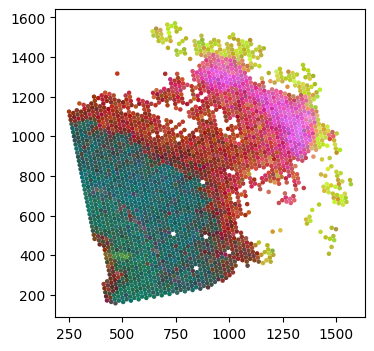

In [1480]:
plt.figure(figsize=(4,4))
plt.scatter(paste_align_coor[:,0], paste_align_coor[:,1], s=5, c=[pca_hex_comb[len(tar_features.T):][i] for i in paste_shared_index[:,0]])

In [1481]:
paste_ad_tar_mean_expr = get_mean_expr_by_neighbor(paste_tar_ad)
paste_ad_src_align_mean_expr = get_mean_expr_by_neighbor(paste_align_ad)

100%|██████████| 2581/2581 [00:07<00:00, 331.85it/s]


In [1482]:
paste_matches = nearest_neighbour(paste_align_coor, paste_tar_coor)

Processing coordinates: 100%|██████████| 2581/2581 [00:33<00:00, 76.01it/s]


## GPSA

In [1483]:
gpsa_tar_ad = sc.read_h5ad(case_dir+'gpsa/gpsa_target_'+src_sample_name+'.h5ad')
gpsa_align_ad = sc.read_h5ad(case_dir+'gpsa/gpsa_alignment_'+src_sample_name+'.h5ad')
gpsa_align = pd.read_csv(case_dir+'gpsa/gpsa_align_coor_'+src_sample_name+'.csv', index_col=0)
gpsa_align = np.array(gpsa_align)
gpsa_tar = pd.read_csv(case_dir+'gpsa/gpsa_tar_coor_'+src_sample_name+'.csv', index_col=0)
gpsa_tar = np.array(gpsa_tar)

ad_src = sc.read_h5ad(os.path.join(data_dir, src_sample_name+'.h5ad'))
gpsa_shared_index = find_matching_indices(ad_src.obs.index.to_list(), gpsa_align_ad.obs.index.to_list())

gpsa_align_resize = (gpsa_align/10)*(ad_tar_coor.max(axis=0)-ad_tar_coor.min(axis=0))+ad_tar_coor.min(axis=0)
gpsa_tar_resize = (gpsa_tar/10)*(ad_tar_coor.max(axis=0)-ad_tar_coor.min(axis=0))+ad_tar_coor.min(axis=0)
gpsa_align_ad.obs[['newy', 'newx']] = gpsa_align_resize
gpsa_tar_ad.obs[['newy', 'newx']] = gpsa_tar_resize

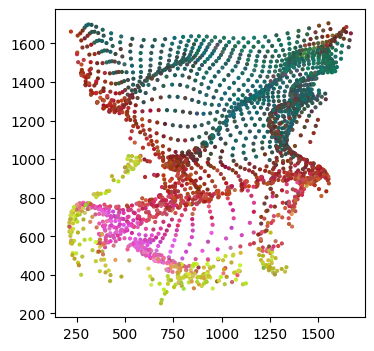

In [1484]:
plt.figure(figsize=(4, 4))
plt.scatter(gpsa_align_resize[:,0], gpsa_align_resize[:,1], c = [pca_hex_comb[len(tar_features.T):][i] for i in gpsa_shared_index[:,0]],s=4)

In [1485]:
gpsa_ad_tar_mean_expr = get_mean_expr_by_dist(gpsa_tar_ad)
gpsa_ad_src_align_mean_expr = get_mean_expr_by_dist(gpsa_align_ad)

100%|██████████| 2607/2607 [00:04<00:00, 603.70it/s]


In [1533]:
shared_genes = [value for value in omiclip_genes if value in gpsa_ad_tar_mean_expr.columns.tolist()]
shared_genes = [value for value in shared_genes if value in gpsa_ad_src_align_mean_expr.columns.tolist()]
len(shared_genes)

180

In [1487]:
gpsa_matches = nearest_neighbour(gpsa_align_resize, gpsa_tar_resize)
gpsa_matches.shape

Processing coordinates: 100%|██████████| 2607/2607 [00:39<00:00, 66.73it/s]


(2355, 2)

## Combine Analysis

In [1534]:
omiclip_st_stat = calculate_rmse(shared_genes, omiclip_ad_tar_mean_expr, omiclip_ad_src_align_mean_expr, omiclip_matches_st)
omiclip_img_ft_stat = calculate_rmse(shared_genes, omiclip_ad_tar_mean_expr, omiclip_ad_src_align_mean_expr, omiclip_matches_img_ft)
paste_stat = calculate_rmse(shared_genes, paste_ad_tar_mean_expr, paste_ad_src_align_mean_expr, paste_matches)
gpsa_stat = calculate_rmse(shared_genes, gpsa_ad_tar_mean_expr, gpsa_ad_src_align_mean_expr, gpsa_matches)

100%|██████████| 180/180 [00:00<00:00, 572.11it/s]


In [1535]:
all_rmse = pd.concat([omiclip_st_stat['rmse'], 
                     omiclip_img_ft_stat['rmse'], 
                     gpsa_stat['rmse'], 
                     paste_stat['rmse'], 
                    ],axis=1)
all_rmse.columns = ['omiclip_st','omiclip_img_ft','gpsa','paste']
all_rmse

,omiclip_st,omiclip_img_ft,gpsa,paste
MT-ND4,0.630885,0.640353,0.642090,0.670149
MT-CO3,0.623617,0.628998,0.638684,0.682736
MT-CO1,0.873066,0.874192,0.599401,1.085623
CTSD,0.746240,0.750608,0.526461,0.802131
SERPINA1,0.860478,0.867288,0.554576,0.819022
...,...,...,...,...
BGN,0.136241,0.133667,0.186647,0.206771
LMF2,0.104959,0.104881,0.128201,0.139319
AC037459.4,0.111948,0.117551,0.137518,0.142950
FAM3C,0.095521,0.096088,0.143789,0.104435


In [1536]:
all_rmse.to_csv(case_dir+src_sample_name+'_all_rmse.csv')

(0.05, 0.4)

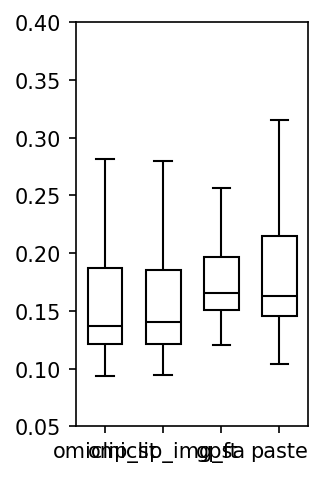

In [1541]:
plt.figure(figsize=(2,3.5), dpi=150)
sns.boxplot(all_rmse, showfliers=False, width=0.6, linecolor = 'black', linewidth=1, color='white')
plt.ylim((0.05,0.4))

In [1538]:
ranksums(all_rmse['paste'], all_rmse['omiclip_img_ft'], alternative='greater')

RanksumsResult(statistic=5.2235005933524565, pvalue=8.778595107148456e-08)

In [1539]:
ranksums(all_rmse['gpsa'], all_rmse['omiclip_img_ft'], alternative='greater')

RanksumsResult(statistic=5.66411000931296, pvalue=7.3894786868531135e-09)

In [1540]:
ranksums(all_rmse['omiclip_img_ft'], all_rmse['omiclip_st'], alternative='greater')

RanksumsResult(statistic=0.2501851166488378, pvalue=0.4012220972677658)

(0.0, 1.0)

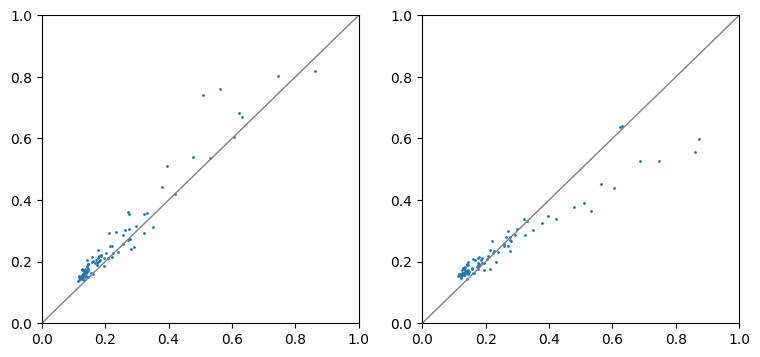

In [1495]:
plt.figure(figsize=(9,4))
plt.subplot(1, 2, 1)
plt.scatter(all_rmse['omiclip_st'], all_rmse['paste'], s=1)
plt.plot([0,2],[0,2], linewidth=1, c='grey')
plt.xlim((0,1))
plt.ylim((0,1))

plt.subplot(1, 2, 2)
plt.scatter(all_rmse['omiclip_st'], all_rmse['gpsa'], s=1)
plt.plot([0,2],[0,2], linewidth=1, c='grey')
plt.xlim((0,1))
plt.ylim((0,1))

In [1542]:
omiclip_st_stat = calculate_mse(shared_genes, omiclip_ad_tar_mean_expr, omiclip_ad_src_align_mean_expr, omiclip_matches_st)
omiclip_img_ft_stat = calculate_mse(shared_genes, omiclip_ad_tar_mean_expr, omiclip_ad_src_align_mean_expr, omiclip_matches_img_ft)
paste_stat = calculate_mse(shared_genes, paste_ad_tar_mean_expr, paste_ad_src_align_mean_expr, paste_matches)
gpsa_stat = calculate_mse(shared_genes, gpsa_ad_tar_mean_expr, gpsa_ad_src_align_mean_expr, gpsa_matches)

100%|██████████| 180/180 [00:00<00:00, 578.58it/s]


In [1543]:
all_mse = pd.concat([omiclip_st_stat['mse'], 
                     omiclip_img_ft_stat['mse'], 
                     gpsa_stat['mse'], 
                     paste_stat['mse'], 
                    ],axis=1)
all_mse.columns = ['omiclip_st','omiclip_img_ft','gpsa','paste']
all_mse

,omiclip_st,omiclip_img_ft,gpsa,paste
MT-ND4,0.398016,0.410052,0.412279,0.449100
MT-CO3,0.388898,0.395638,0.407918,0.466128
MT-CO1,0.762244,0.764212,0.359282,1.178578
CTSD,0.556874,0.563412,0.277161,0.643414
SERPINA1,0.740422,0.752189,0.307555,0.670798
...,...,...,...,...
BGN,0.018562,0.017867,0.034837,0.042754
LMF2,0.011016,0.011000,0.016435,0.019410
AC037459.4,0.012532,0.013818,0.018911,0.020435
FAM3C,0.009124,0.009233,0.020675,0.010907


In [1544]:
all_mse.to_csv(case_dir+src_sample_name+'_all_mse.csv')

<Axes: >

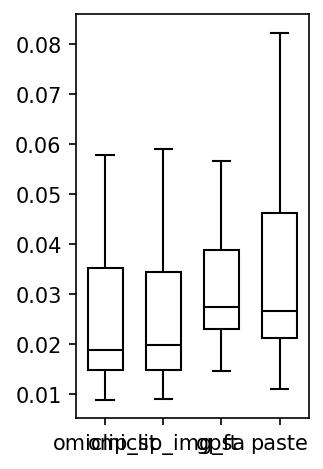

In [1545]:
plt.figure(figsize=(2,3.5), dpi=150)
sns.boxplot(all_mse, showfliers=False, width=0.6, linecolor = 'black', linewidth=1, color='white')
# plt.ylim((0.05,0.4))

In [1546]:
ranksums(all_mse['paste'], all_mse['omiclip_img_ft'], alternative='greater')

RanksumsResult(statistic=5.2235005933524565, pvalue=8.778595107148456e-08)

In [1547]:
ranksums(all_mse['gpsa'], all_mse['omiclip_img_ft'], alternative='greater')

RanksumsResult(statistic=5.66411000931296, pvalue=7.3894786868531135e-09)

In [1548]:
ranksums(all_mse['omiclip_img_ft'], all_mse['omiclip_st'], alternative='greater')

RanksumsResult(statistic=0.2501851166488378, pvalue=0.4012220972677658)

(0.0, 1.0)

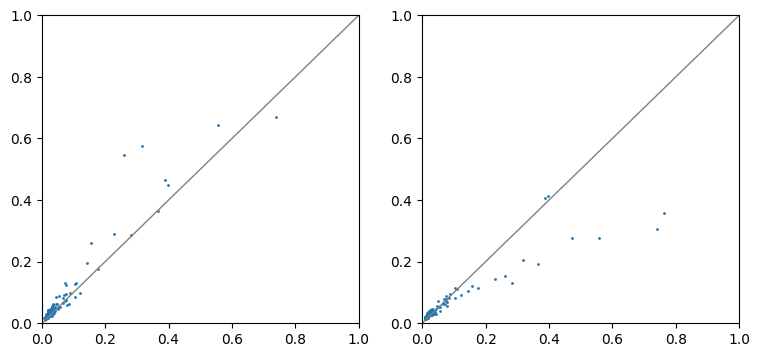

In [1549]:
plt.figure(figsize=(9,4))
plt.subplot(1, 2, 1)
plt.scatter(all_mse['omiclip_st'], all_mse['paste'], s=1)
plt.plot([0,2],[0,2], linewidth=1, c='grey')
plt.xlim((0,1))
plt.ylim((0,1))

plt.subplot(1, 2, 2)
plt.scatter(all_mse['omiclip_st'], all_mse['gpsa'], s=1)
plt.plot([0,2],[0,2], linewidth=1, c='grey')
plt.xlim((0,1))
plt.ylim((0,1))

# V10F24-050_C1

In [1550]:
src_sample_name = 'V10F24-050_C1'
ad_src, ad_src_coor, src_img =  prepare_data(src_sample_name)

## Omiclip ST to ST

In [1559]:
case_name = '_coca_after_training20'

In [1560]:
feature_type = '_coca_txt_features'
tar_features = get_features(tar_sample_name, feature_type, case_name)
src_features = get_features(src_sample_name, feature_type, case_name)

In [1561]:
pca_comb_features, pca_comb_features_batch = get_pca_by_fit(tar_features, src_features)

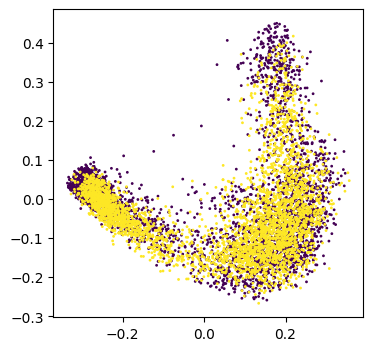

In [1562]:
plt.figure(figsize=(4,4))
plt.scatter(pca_comb_features[:,0], pca_comb_features[:,1],c=pca_comb_features_batch, s=1)

In [1563]:
pca_rgb_comb = (pca_comb_features-pca_comb_features.min(axis=0))/(pca_comb_features.max(axis=0)-pca_comb_features.min(axis=0))
pca_hex_comb = [ rgb2hex(pca_rgb_comb[i,:]) for i in range(pca_rgb_comb.shape[0]) ]

In [306]:
alpha = 0.5
cpd_coor, homo_coor, aligned_image = cpd_align(ad_tar_coor, ad_src_coor, pca_comb_features, src_img, alpha)

In [307]:
# plot_alignment_with_img(ad_tar_coor, ad_src_coor, homo_coor, tar_img, src_img, aligned_image, pca_hex_comb, tar_features)

In [308]:
shift=300
s=0.8
# plot_alignment(ad_tar_coor, ad_src_coor, homo_coor, pca_hex_comb, tar_features, shift=300, s=0.8)

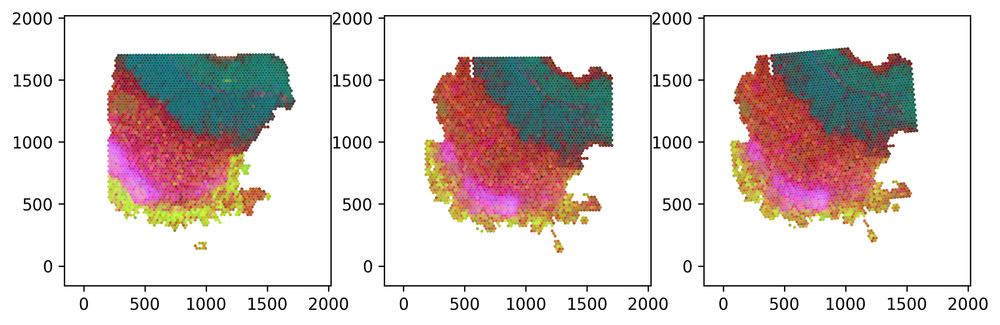

In [309]:
plot_alignment(ad_tar_coor, ad_src_coor, homo_coor, pca_hex_comb, tar_features, shift=300, s=0.8, boundary_line=False)

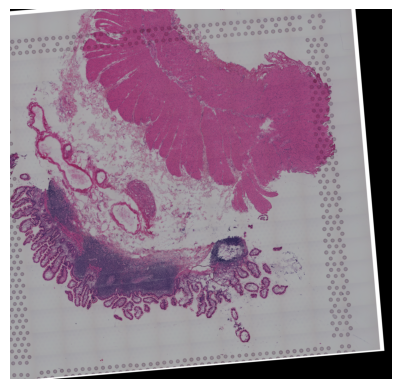

In [310]:
plt.imshow(aligned_image, origin='lower')
plt.axis('off')
plt.show()

In [311]:
save_name = 'omiclip_st_st_'+src_sample_name+'.h5ad'
wirte_aligned_data(ad_src, aligned_image, homo_coor, save_name)

## Omiclip Img to ST

In [312]:
generate_features_finetune10(src_sample_name)

100%|██████████| 3450/3450 [05:08<00:00, 11.20it/s]


In [313]:
case_name = '_finetune10'

In [314]:
tar_features = get_features(tar_sample_name, '_text_feature', case_name)
src_features = get_features(src_sample_name, '_image_feature', case_name)

In [315]:
pca_comb_features, pca_comb_features_batch = get_pca_by_fit(tar_features, src_features)

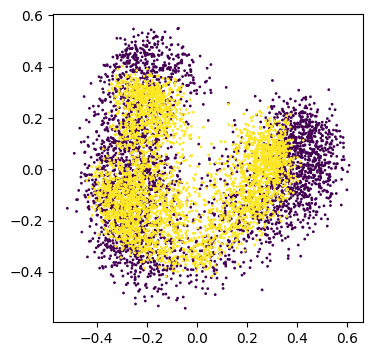

In [316]:
plt.figure(figsize=(4,4))
plt.scatter(pca_comb_features[:,0], pca_comb_features[:,1],c=pca_comb_features_batch, s=1)

In [ ]:
alpha = 0.5
cpd_coor, homo_coor, aligned_image = cpd_align(ad_tar_coor, ad_src_coor, pca_comb_features, src_img, alpha)

In [ ]:
# plot_alignment_with_img(ad_tar_coor, ad_src_coor, homo_coor, tar_img, src_img, aligned_image, pca_hex_comb, tar_features)

In [ ]:
shift=300
s=0.8
# plot_alignment(ad_tar_coor, ad_src_coor, homo_coor, pca_hex_comb, tar_features, shift=300, s=0.8)

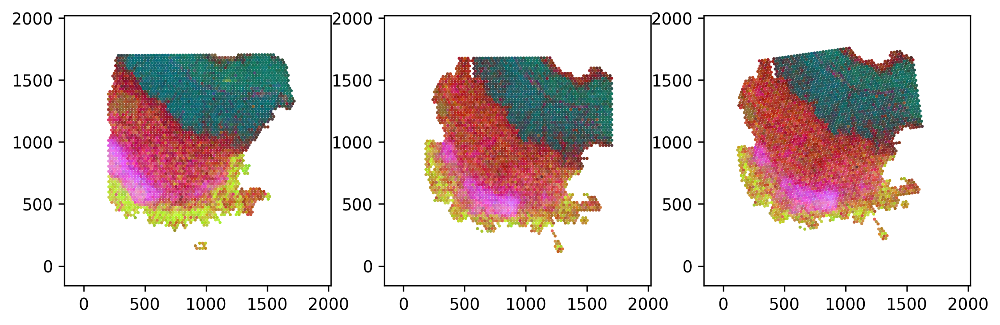

In [336]:
plot_alignment(ad_tar_coor, ad_src_coor, homo_coor, pca_hex_comb, tar_features, shift=300, s=0.8, boundary_line=False)

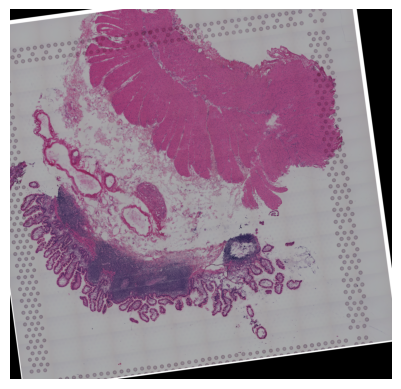

In [337]:
plt.imshow(aligned_image, origin='lower')
plt.axis('off')
plt.show()

In [ ]:
save_name = 'omiclip_st_img_finetune10_'+src_sample_name+'.h5ad'
wirte_aligned_data(ad_src, aligned_image, homo_coor, save_name)

## Omiclip Results

In [1551]:
omiclip_ad_tar = ad_tar.copy()
omiclip_ad_src_align_st = sc.read_h5ad(case_dir_omiclip+'omiclip_st_st_'+src_sample_name+'.h5ad')
omiclip_ad_src_align_img_ft = sc.read_h5ad(case_dir_omiclip+'omiclip_st_img_finetune10_'+src_sample_name+'.h5ad')

In [1552]:
omiclip_ad_tar = filter_norm_log1p(omiclip_ad_tar)
omiclip_ad_src_align_st = filter_norm_log1p(omiclip_ad_src_align_st)
omiclip_ad_src_align_img_ft = filter_norm_log1p(omiclip_ad_src_align_img_ft)

In [1553]:
omiclip_ad_tar_heg_of_hvg = get_heg_of_hvg(omiclip_ad_tar)
omiclip_ad_src_heg_of_hvg = get_heg_of_hvg(omiclip_ad_src_align_st)
omiclip_genes = [value for value in omiclip_ad_tar_heg_of_hvg.index.tolist() if value in omiclip_ad_src_heg_of_hvg.index.tolist()]
len(omiclip_genes)

199

In [1554]:
omiclip_ad_tar_mean_expr = get_mean_expr_by_neighbor(omiclip_ad_tar)
omiclip_ad_src_mean_expr = get_mean_expr_by_neighbor(omiclip_ad_src_align_st)

100%|██████████| 3450/3450 [00:12<00:00, 272.78it/s]


In [1555]:
scalef_tar = get_scalefactors(omiclip_ad_tar)['tissue_hires_scalef']
scalef_src = get_scalefactors(omiclip_ad_src)['tissue_hires_scalef']
omiclip_matches_st = nearest_neighbour(omiclip_ad_src_align_st.obsm['spatial']*scalef_src, omiclip_ad_tar.obsm['spatial']*scalef_tar)
omiclip_matches_img_ft = nearest_neighbour(omiclip_ad_src_align_img_ft.obsm['spatial']*scalef_src, omiclip_ad_tar.obsm['spatial']*scalef_tar)

Processing coordinates: 100%|██████████| 3450/3450 [00:47<00:00, 72.45it/s]


## Paste

Using selected backend cpu. If you want to use gpu, set use_gpu = True.


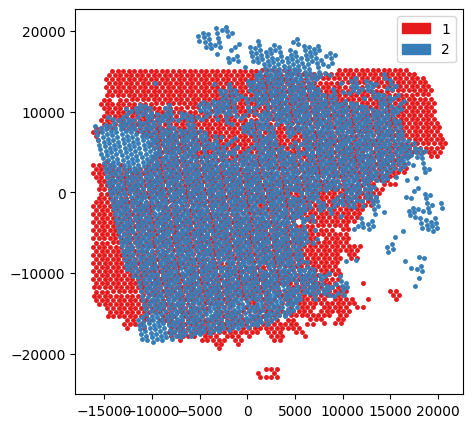

In [99]:
paste_align(src_sample_name)

In [1556]:
paste_tar_ad = sc.read_h5ad(paste_path+'paste_aligment_target_'+src_sample_name+'.h5ad')
paste_align_ad = sc.read_h5ad(paste_path+'paste_aligment_source_'+src_sample_name+'.h5ad')
paste_tar_ad = filter_norm_log1p(paste_tar_ad)
paste_align_ad = filter_norm_log1p(paste_align_ad)

In [1557]:
ad_src = sc.read_h5ad(os.path.join(data_dir, src_sample_name+'.h5ad'))
paste_shared_index = find_matching_indices(ad_src.obs.index.to_list(), paste_align_ad.obs.index.to_list())
paste_tar_coor = (paste_tar_ad.obsm['spatial']-paste_tar_ad.obsm['spatial'].min())/(paste_tar_ad.obsm['spatial'].max()-paste_tar_ad.obsm['spatial'].min())*(ad_tar_coor.max()-ad_tar_coor.min())
paste_align_coor = (paste_align_ad.obsm['spatial']-paste_tar_ad.obsm['spatial'].min())/(paste_tar_ad.obsm['spatial'].max()-paste_tar_ad.obsm['spatial'].min())*(ad_tar_coor.max()-ad_tar_coor.min())

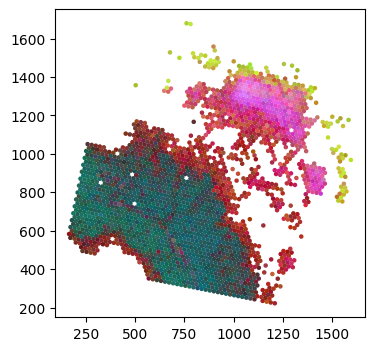

In [1564]:
plt.figure(figsize=(4,4))
plt.scatter(paste_align_coor[:,0], paste_align_coor[:,1], s=5, c=[pca_hex_comb[ad_tar.shape[0]:][i] for i in paste_shared_index[:,0]])

In [1565]:
paste_ad_tar_mean_expr = get_mean_expr_by_neighbor(paste_tar_ad)
paste_ad_src_align_mean_expr = get_mean_expr_by_neighbor(paste_align_ad)

100%|██████████| 2266/2266 [00:06<00:00, 336.18it/s]


In [1566]:
paste_matches = nearest_neighbour(paste_align_coor, paste_tar_coor)

Processing coordinates: 100%|██████████| 2266/2266 [00:29<00:00, 75.74it/s]


## GPSA

In [1022]:
gpsa_tar_ad = sc.read_h5ad(case_dir+'gpsa/gpsa_target_'+src_sample_name+'.h5ad')
gpsa_align_ad = sc.read_h5ad(case_dir+'gpsa/gpsa_alignment_'+src_sample_name+'.h5ad')
gpsa_align = pd.read_csv(case_dir+'gpsa/gpsa_align_coor_'+src_sample_name+'.csv', index_col=0)
gpsa_align = np.array(gpsa_align)
gpsa_tar = pd.read_csv(case_dir+'gpsa/gpsa_tar_coor_'+src_sample_name+'.csv', index_col=0)
gpsa_tar = np.array(gpsa_tar)

ad_src = sc.read_h5ad(os.path.join(data_dir, src_sample_name+'.h5ad'))
gpsa_shared_index = find_matching_indices(ad_src.obs.index.to_list(), gpsa_align_ad.obs.index.to_list())

gpsa_align_resize = (gpsa_align/10)*(ad_tar_coor.max(axis=0)-ad_tar_coor.min(axis=0))+ad_tar_coor.min(axis=0)
gpsa_tar_resize = (gpsa_tar/10)*(ad_tar_coor.max(axis=0)-ad_tar_coor.min(axis=0))+ad_tar_coor.min(axis=0)
gpsa_align_ad.obs[['newy', 'newx']] = gpsa_align_resize
gpsa_tar_ad.obs[['newy', 'newx']] = gpsa_tar_resize

FileNotFoundError: [Errno 2] Unable to synchronously open file (unable to open file: name = '/condo/wanglab/shared/wxc/clip/data/human/ST_data/simulation_data/case_study/data31_spatial_fresh_frozen_35sample/gpsa/gpsa_target_V10F24-050_C1.h5ad', errno = 2, error message = 'No such file or directory', flags = 0, o_flags = 0)

In [ ]:
plt.figure(figsize=(4, 4))
plt.scatter(gpsa_align_resize[:,0], gpsa_align_resize[:,1], c = [pca_hex_comb[len(tar_features.T):][i] for i in gpsa_shared_index[:,0]],s=4)

In [ ]:
gpsa_ad_tar_mean_expr = get_mean_expr_by_dist(gpsa_tar_ad)
gpsa_ad_src_align_mean_expr = get_mean_expr_by_dist(gpsa_align_ad)

In [ ]:
shared_genes = [value for value in omiclip_genes if value in gpsa_ad_tar_mean_expr.columns.tolist()]
shared_genes = [value for value in shared_genes if value in gpsa_ad_src_align_mean_expr.columns.tolist()]
len(shared_genes)

In [ ]:
gpsa_matches = nearest_neighbour(gpsa_align_resize, gpsa_tar_resize)
gpsa_matches.shape

## Combine Analysis

In [1567]:
omiclip_st_stat = calculate_rmse(shared_genes, omiclip_ad_tar_mean_expr, omiclip_ad_src_align_mean_expr, omiclip_matches_st)
omiclip_img_ft_stat = calculate_rmse(shared_genes, omiclip_ad_tar_mean_expr, omiclip_ad_src_align_mean_expr, omiclip_matches_img_ft)
paste_stat = calculate_rmse(shared_genes, paste_ad_tar_mean_expr, paste_ad_src_align_mean_expr, paste_matches)
# gpsa_stat = calculate_rmse(shared_genes, gpsa_ad_tar_mean_expr, gpsa_ad_src_align_mean_expr, gpsa_matches)

100%|██████████| 180/180 [00:00<00:00, 832.25it/s]


In [1568]:
gpsa_stat = pd.DataFrame()
gpsa_stat['rmse']=None

In [1569]:
all_rmse = pd.concat([omiclip_st_stat['rmse'], 
                     omiclip_img_ft_stat['rmse'], 
                     gpsa_stat['rmse'], 
                     paste_stat['rmse'], 
                    ],axis=1)
all_rmse.columns = ['omiclip_st','omiclip_img_ft','gpsa','paste']
all_rmse

,omiclip_st,omiclip_img_ft,gpsa,paste
MT-ND4,0.652225,0.649075,NaN,0.633081
MT-CO3,0.636807,0.636023,NaN,0.641030
MT-CO1,0.887065,0.891488,NaN,1.133442
CTSD,0.756365,0.754665,NaN,0.757390
SERPINA1,0.846361,0.854689,NaN,0.801526
...,...,...,...,...
BGN,0.132295,0.133741,NaN,0.206990
LMF2,0.104418,0.105080,NaN,0.138816
AC037459.4,0.106974,0.111421,NaN,0.156241
FAM3C,0.095059,0.094443,NaN,0.126089


In [1570]:
all_rmse.to_csv(case_dir+src_sample_name+'_all_rmse.csv')

(0.05, 0.4)

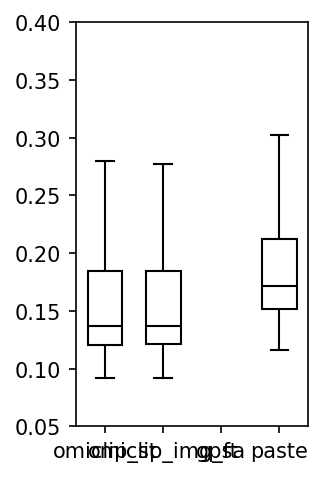

In [1571]:
plt.figure(figsize=(2,3.5), dpi=150)
sns.boxplot(all_rmse, showfliers=False, width=0.6, linecolor = 'black', linewidth=1, color='white')
plt.ylim((0.05,0.4))

In [1572]:
ranksums(all_rmse['paste'], all_rmse['omiclip_img_ft'], alternative='greater')

RanksumsResult(statistic=6.541277260397549, pvalue=3.049781421032749e-11)

In [1573]:
ranksums(all_rmse['gpsa'], all_rmse['omiclip_img_ft'], alternative='greater')

RanksumsResult(statistic=nan, pvalue=nan)

In [1574]:
ranksums(all_rmse['omiclip_img_ft'], all_rmse['omiclip_st'], alternative='greater')

RanksumsResult(statistic=0.05368344608254415, pvalue=0.47859368594709806)

(0.0, 1.0)

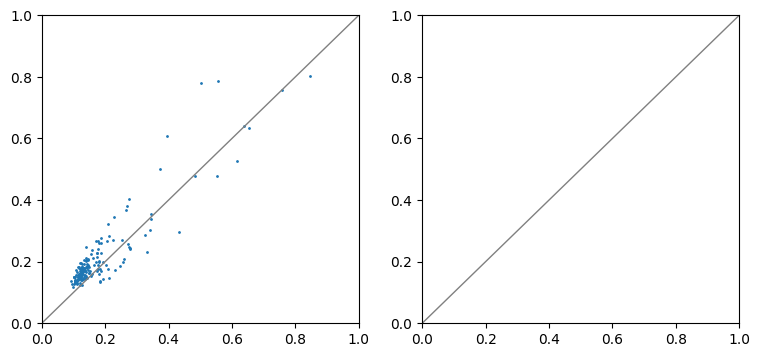

In [1575]:
plt.figure(figsize=(9,4))
plt.subplot(1, 2, 1)
plt.scatter(all_rmse['omiclip_st'], all_rmse['paste'], s=1)
plt.plot([0,2],[0,2], linewidth=1, c='grey')
plt.xlim((0,1))
plt.ylim((0,1))

plt.subplot(1, 2, 2)
plt.scatter(all_rmse['omiclip_st'], all_rmse['gpsa'], s=1)
plt.plot([0,2],[0,2], linewidth=1, c='grey')
plt.xlim((0,1))
plt.ylim((0,1))

In [1576]:
omiclip_st_stat = calculate_mse(shared_genes, omiclip_ad_tar_mean_expr, omiclip_ad_src_align_mean_expr, omiclip_matches_st)
omiclip_img_ft_stat = calculate_mse(shared_genes, omiclip_ad_tar_mean_expr, omiclip_ad_src_align_mean_expr, omiclip_matches_img_ft)
paste_stat = calculate_mse(shared_genes, paste_ad_tar_mean_expr, paste_ad_src_align_mean_expr, paste_matches)
# gpsa_stat = calculate_rmse(shared_genes, gpsa_ad_tar_mean_expr, gpsa_ad_src_align_mean_expr, gpsa_matches)

100%|██████████| 180/180 [00:00<00:00, 565.64it/s]


In [1577]:
gpsa_stat = pd.DataFrame()
gpsa_stat['mse']=None

In [1578]:
all_mse = pd.concat([omiclip_st_stat['mse'], 
                     omiclip_img_ft_stat['mse'], 
                     gpsa_stat['mse'], 
                     paste_stat['mse'], 
                    ],axis=1)
all_mse.columns = ['omiclip_st','omiclip_img_ft','gpsa','paste']
all_mse

,omiclip_st,omiclip_img_ft,gpsa,paste
MT-ND4,0.425398,0.421299,NaN,0.400792
MT-CO3,0.405523,0.404525,NaN,0.410920
MT-CO1,0.786884,0.794750,NaN,1.284690
CTSD,0.572088,0.569519,NaN,0.573640
SERPINA1,0.716326,0.730494,NaN,0.642444
...,...,...,...,...
BGN,0.017502,0.017887,NaN,0.042845
LMF2,0.010903,0.011042,NaN,0.019270
AC037459.4,0.011443,0.012415,NaN,0.024411
FAM3C,0.009036,0.008920,NaN,0.015898


In [1579]:
all_mse.to_csv(case_dir+src_sample_name+'_all_mse.csv')

<Axes: >

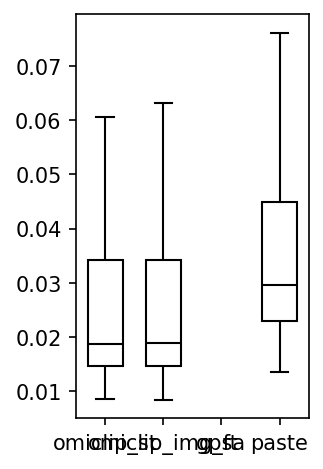

In [1580]:
plt.figure(figsize=(2,3.5), dpi=150)
sns.boxplot(all_mse, showfliers=False, width=0.6, linecolor = 'black', linewidth=1, color='white')
# plt.ylim((0.05,0.4))

In [1581]:
ranksums(all_mse['paste'], all_mse['omiclip_img_ft'], alternative='greater')

RanksumsResult(statistic=6.541277260397549, pvalue=3.049781421032749e-11)

In [1582]:
ranksums(all_mse['gpsa'], all_mse['omiclip_img_ft'], alternative='greater')

RanksumsResult(statistic=nan, pvalue=nan)

In [1583]:
ranksums(all_mse['omiclip_img_ft'], all_mse['omiclip_st'], alternative='greater')

RanksumsResult(statistic=0.05368344608254415, pvalue=0.47859368594709806)

(0.0, 1.0)

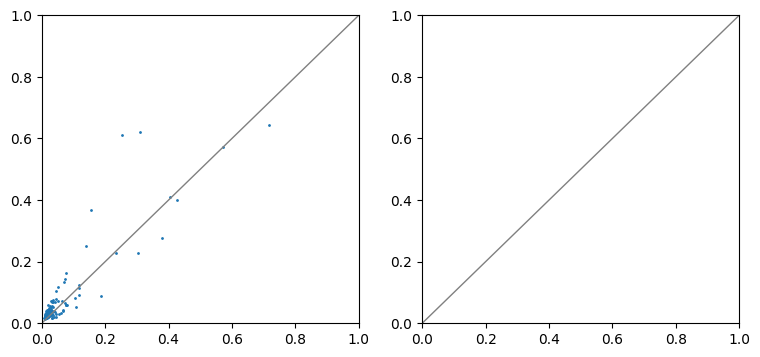

In [1584]:
plt.figure(figsize=(9,4))
plt.subplot(1, 2, 1)
plt.scatter(all_mse['omiclip_st'], all_mse['paste'], s=1)
plt.plot([0,2],[0,2], linewidth=1, c='grey')
plt.xlim((0,1))
plt.ylim((0,1))

plt.subplot(1, 2, 2)
plt.scatter(all_mse['omiclip_st'], all_mse['gpsa'], s=1)
plt.plot([0,2],[0,2], linewidth=1, c='grey')
plt.xlim((0,1))
plt.ylim((0,1))

# V10F24-050_D1

In [1585]:
src_sample_name = 'V10F24-050_D1'
ad_src, ad_src_coor, src_img =  prepare_data(src_sample_name)

## Omiclip ST to ST

In [1586]:
case_name = '_coca_after_training20'

In [1587]:
feature_type = '_coca_txt_features'
tar_features = get_features(tar_sample_name, feature_type, case_name)
src_features = get_features(src_sample_name, feature_type, case_name)

In [1588]:
pca_comb_features, pca_comb_features_batch = get_pca_by_fit(tar_features, src_features)

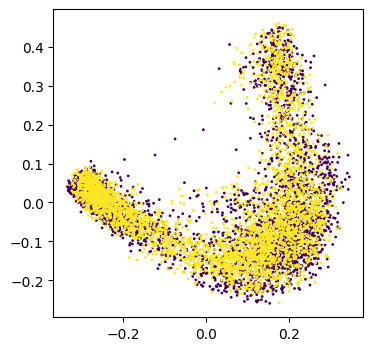

In [1589]:
plt.figure(figsize=(4,4))
plt.scatter(pca_comb_features[:,0], pca_comb_features[:,1],c=pca_comb_features_batch, s=1)

In [1590]:
pca_rgb_comb = (pca_comb_features-pca_comb_features.min(axis=0))/(pca_comb_features.max(axis=0)-pca_comb_features.min(axis=0))
pca_hex_comb = [ rgb2hex(pca_rgb_comb[i,:]) for i in range(pca_rgb_comb.shape[0]) ]

In [151]:
alpha = 0.5
cpd_coor, homo_coor, aligned_image = cpd_align(ad_tar_coor, ad_src_coor, pca_comb_features, src_img, alpha)

In [152]:
# plot_alignment_with_img(ad_tar_coor, ad_src_coor, homo_coor, tar_img, src_img, aligned_image, pca_hex_comb, tar_features)

In [153]:
shift=300
s=0.8
# plot_alignment(ad_tar_coor, ad_src_coor, homo_coor, pca_hex_comb, tar_features, shift=300, s=0.8)

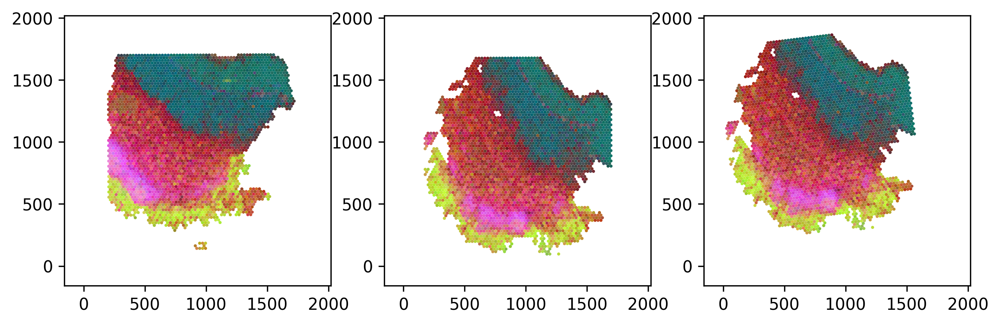

In [154]:
plot_alignment(ad_tar_coor, ad_src_coor, homo_coor, pca_hex_comb, tar_features, shift=300, s=0.8, boundary_line=False)

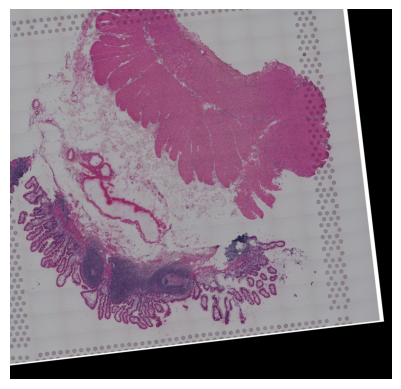

In [155]:
plt.imshow(aligned_image, origin='lower')
plt.axis('off')
plt.show()

In [156]:
save_name = 'omiclip_st_st_'+src_sample_name+'.h5ad'
wirte_aligned_data(ad_src, aligned_image, homo_coor, save_name)

## Omiclip Img to ST

In [157]:
generate_features_finetune10(src_sample_name)

100%|██████████| 3565/3565 [01:55<00:00, 30.89it/s]


In [158]:
case_name = '_finetune10'

In [159]:
tar_features = get_features(tar_sample_name, '_text_feature', case_name)
src_features = get_features(src_sample_name, '_image_feature', case_name)

In [160]:
pca_comb_features, pca_comb_features_batch = get_pca_by_fit(tar_features, src_features)

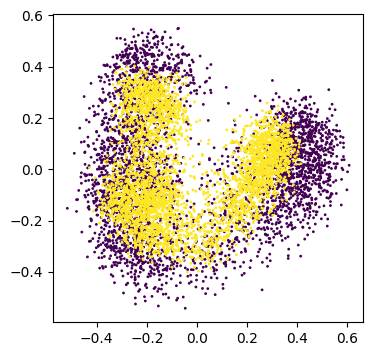

In [161]:
plt.figure(figsize=(4,4))
plt.scatter(pca_comb_features[:,0], pca_comb_features[:,1],c=pca_comb_features_batch, s=1)

In [162]:
alpha = 0.5
cpd_coor, homo_coor, aligned_image = cpd_align(ad_tar_coor, ad_src_coor, pca_comb_features, src_img, alpha)

In [163]:
# plot_alignment_with_img(ad_tar_coor, ad_src_coor, homo_coor, tar_img, src_img, aligned_image, pca_hex_comb, tar_features)

In [164]:
shift=300
s=0.8
# plot_alignment(ad_tar_coor, ad_src_coor, homo_coor, pca_hex_comb, tar_features, shift=300, s=0.8)

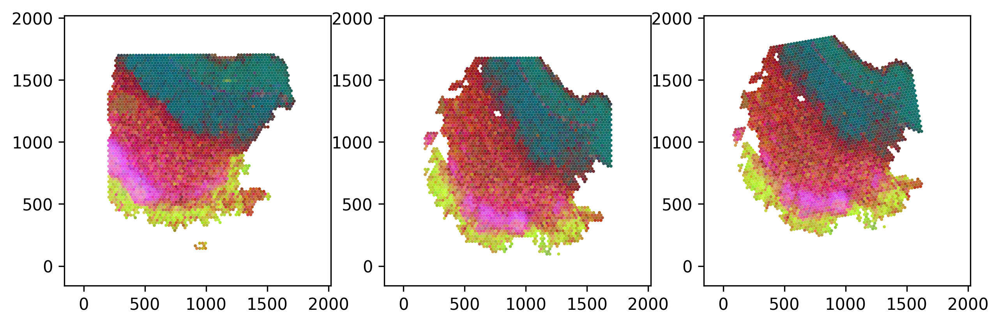

In [165]:
plot_alignment(ad_tar_coor, ad_src_coor, homo_coor, pca_hex_comb, tar_features, shift=300, s=0.8, boundary_line=False)

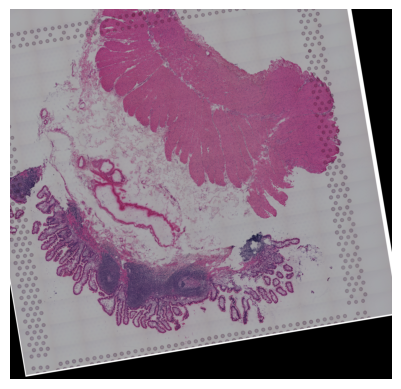

In [166]:
plt.imshow(aligned_image, origin='lower')
plt.axis('off')
plt.show()

In [167]:
save_name = 'omiclip_st_img_finetune10_'+src_sample_name+'.h5ad'
wirte_aligned_data(ad_src, aligned_image, homo_coor, save_name)

## Omiclip Results

In [1591]:
omiclip_ad_tar = ad_tar.copy()
omiclip_ad_src_align_st = sc.read_h5ad(case_dir_omiclip+'omiclip_st_st_'+src_sample_name+'.h5ad')
omiclip_ad_src_align_img_ft = sc.read_h5ad(case_dir_omiclip+'omiclip_st_img_finetune10_'+src_sample_name+'.h5ad')

In [1592]:
omiclip_ad_tar = filter_norm_log1p(omiclip_ad_tar)
omiclip_ad_src_align_st = filter_norm_log1p(omiclip_ad_src_align_st)
omiclip_ad_src_align_img_ft = filter_norm_log1p(omiclip_ad_src_align_img_ft)

In [1593]:
omiclip_ad_tar_heg_of_hvg = get_heg_of_hvg(omiclip_ad_tar)
omiclip_ad_src_heg_of_hvg = get_heg_of_hvg(omiclip_ad_src_align_st)
omiclip_genes = [value for value in omiclip_ad_tar_heg_of_hvg.index.tolist() if value in omiclip_ad_src_heg_of_hvg.index.tolist()]
len(omiclip_genes)

263

In [1594]:
omiclip_ad_tar_mean_expr = get_mean_expr_by_neighbor(omiclip_ad_tar)
omiclip_ad_src_mean_expr = get_mean_expr_by_neighbor(omiclip_ad_src_align_st)

100%|██████████| 3565/3565 [00:13<00:00, 265.83it/s]


In [1595]:
scalef_tar = get_scalefactors(omiclip_ad_tar)['tissue_hires_scalef']
scalef_src = get_scalefactors(omiclip_ad_src)['tissue_hires_scalef']
omiclip_matches_st = nearest_neighbour(omiclip_ad_src_align_st.obsm['spatial']*scalef_src, omiclip_ad_tar.obsm['spatial']*scalef_tar)
omiclip_matches_img_ft = nearest_neighbour(omiclip_ad_src_align_img_ft.obsm['spatial']*scalef_src, omiclip_ad_tar.obsm['spatial']*scalef_tar)

Processing coordinates: 100%|██████████| 3565/3565 [00:49<00:00, 72.54it/s]


## Paste

Using selected backend cpu. If you want to use gpu, set use_gpu = True.


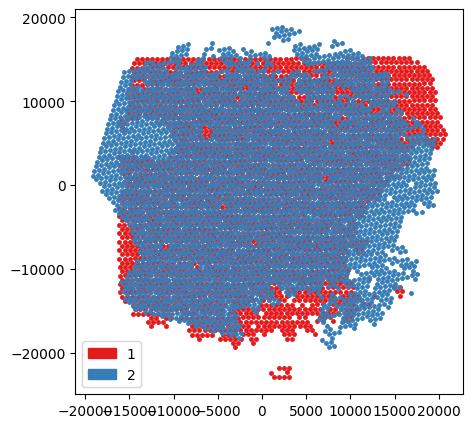

In [174]:
paste_align(src_sample_name)

In [1596]:
paste_tar_ad = sc.read_h5ad(paste_path+'paste_aligment_target_'+src_sample_name+'.h5ad')
paste_align_ad = sc.read_h5ad(paste_path+'paste_aligment_source_'+src_sample_name+'.h5ad')
paste_tar_ad = filter_norm_log1p(paste_tar_ad)
paste_align_ad = filter_norm_log1p(paste_align_ad)

In [1597]:
ad_src = sc.read_h5ad(os.path.join(data_dir, src_sample_name+'.h5ad'))
paste_shared_index = find_matching_indices(ad_src.obs.index.to_list(), paste_align_ad.obs.index.to_list())
paste_tar_coor = (paste_tar_ad.obsm['spatial']-paste_tar_ad.obsm['spatial'].min())/(paste_tar_ad.obsm['spatial'].max()-paste_tar_ad.obsm['spatial'].min())*(ad_tar_coor.max()-ad_tar_coor.min())
paste_align_coor = (paste_align_ad.obsm['spatial']-paste_tar_ad.obsm['spatial'].min())/(paste_tar_ad.obsm['spatial'].max()-paste_tar_ad.obsm['spatial'].min())*(ad_tar_coor.max()-ad_tar_coor.min())

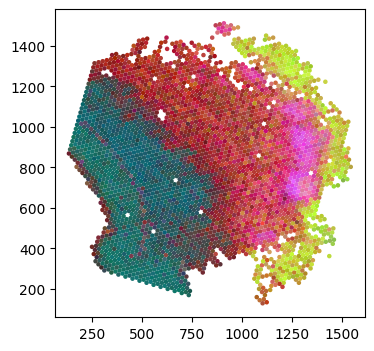

In [1598]:
plt.figure(figsize=(4,4))
plt.scatter(paste_align_coor[:,0], paste_align_coor[:,1], s=5, c=[pca_hex_comb[len(tar_features.T):][i] for i in paste_shared_index[:,0]])

In [1599]:
paste_ad_tar_mean_expr = get_mean_expr_by_neighbor(paste_tar_ad)
paste_ad_src_align_mean_expr = get_mean_expr_by_neighbor(paste_align_ad)

100%|██████████| 3414/3414 [00:10<00:00, 326.37it/s]


In [1600]:
paste_matches = nearest_neighbour(paste_align_coor, paste_tar_coor)

Processing coordinates: 100%|██████████| 3414/3414 [00:44<00:00, 76.12it/s]


## GPSA

In [1601]:
gpsa_tar_ad = sc.read_h5ad(case_dir+'gpsa/gpsa_target_'+src_sample_name+'.h5ad')
gpsa_align_ad = sc.read_h5ad(case_dir+'gpsa/gpsa_alignment_'+src_sample_name+'.h5ad')

gpsa_align = pd.read_csv(case_dir+'gpsa/gpsa_align_coor_'+src_sample_name+'.csv', index_col=0)
gpsa_align = np.array(gpsa_align)
gpsa_tar = pd.read_csv(case_dir+'gpsa/gpsa_tar_coor_'+src_sample_name+'.csv', index_col=0)
gpsa_tar = np.array(gpsa_tar)

ad_src = sc.read_h5ad(os.path.join(data_dir, src_sample_name+'.h5ad'))
gpsa_shared_index = find_matching_indices(ad_src.obs.index.to_list(), gpsa_align_ad.obs.index.to_list())

gpsa_align_resize = (gpsa_align/10)*(ad_tar_coor.max(axis=0)-ad_tar_coor.min(axis=0))+ad_tar_coor.min(axis=0)
gpsa_tar_resize = (gpsa_tar/10)*(ad_tar_coor.max(axis=0)-ad_tar_coor.min(axis=0))+ad_tar_coor.min(axis=0)
gpsa_align_ad.obs[['newy', 'newx']] = gpsa_align_resize
gpsa_tar_ad.obs[['newy', 'newx']] = gpsa_tar_resize

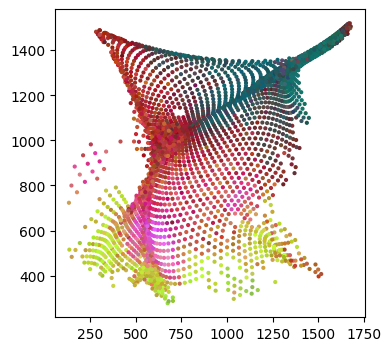

In [1602]:
plt.figure(figsize=(4, 4))
plt.scatter(gpsa_align_resize[:,0], gpsa_align_resize[:,1], c = [pca_hex_comb[len(tar_features.T):][i] for i in gpsa_shared_index[:,0]],s=4)

In [1603]:
gpsa_ad_tar_mean_expr = get_mean_expr_by_dist(gpsa_tar_ad)
gpsa_ad_src_align_mean_expr = get_mean_expr_by_dist(gpsa_align_ad)

100%|██████████| 3422/3422 [00:05<00:00, 585.35it/s]


In [1604]:
shared_genes = [value for value in omiclip_genes if value in gpsa_ad_tar_mean_expr.columns.tolist()]
shared_genes = [value for value in shared_genes if value in gpsa_ad_src_align_mean_expr.columns.tolist()]
len(shared_genes)

221

In [1605]:
gpsa_matches = nearest_neighbour(gpsa_align_resize, gpsa_tar_resize)
gpsa_matches.shape

Processing coordinates: 100%|██████████| 3422/3422 [00:51<00:00, 66.44it/s]


(3315, 2)

## Combine Analysis

In [1606]:
omiclip_st_stat = calculate_rmse(shared_genes, omiclip_ad_tar_mean_expr, omiclip_ad_src_align_mean_expr, omiclip_matches_st)
omiclip_img_ft_stat = calculate_rmse(shared_genes, omiclip_ad_tar_mean_expr, omiclip_ad_src_align_mean_expr, omiclip_matches_img_ft)
paste_stat = calculate_rmse(shared_genes, paste_ad_tar_mean_expr, paste_ad_src_align_mean_expr, paste_matches)
gpsa_stat = calculate_rmse(shared_genes, gpsa_ad_tar_mean_expr, gpsa_ad_src_align_mean_expr, gpsa_matches)

100%|██████████| 221/221 [00:00<00:00, 789.89it/s]


In [1607]:
all_rmse = pd.concat([omiclip_st_stat['rmse'], 
                     omiclip_img_ft_stat['rmse'], 
                     gpsa_stat['rmse'], 
                     paste_stat['rmse'], 
                    ],axis=1)
all_rmse.columns = ['omiclip_st','omiclip_img_ft','gpsa','paste']
all_rmse

,omiclip_st,omiclip_img_ft,gpsa,paste
MT-ND4,0.633774,0.639462,0.707553,0.738092
MT-CO3,0.615293,0.617550,0.726856,0.743088
CD74,0.665897,0.688166,0.777180,0.912376
CTSD,0.465642,0.516229,0.471798,0.781927
SERPINA1,0.546994,0.615044,0.496252,0.853735
...,...,...,...,...
FAM3C,0.093620,0.090813,0.124582,0.107015
TMEM159,0.097758,0.103351,0.113000,0.116348
DNAJC4,0.096909,0.092419,0.132014,0.108825
TADA3,0.103167,0.102488,0.111992,0.112035


In [1608]:
all_rmse.to_csv(case_dir+src_sample_name+'_all_rmse.csv')

(0.05, 0.4)

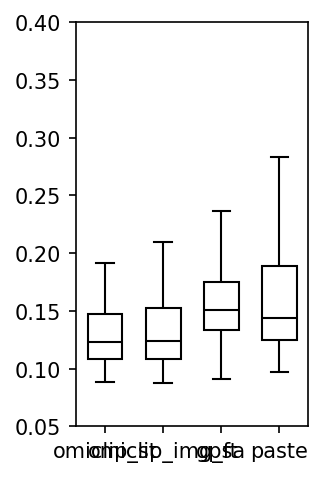

In [1609]:
plt.figure(figsize=(2,3.5), dpi=150)
sns.boxplot(all_rmse, showfliers=False, width=0.6, linecolor = 'black', linewidth=1, color='white')
plt.ylim((0.05,0.4))

In [1610]:
ranksums(all_rmse['paste'], all_rmse['omiclip_img_ft'], alternative='greater')

RanksumsResult(statistic=5.952966869190826, pvalue=1.3166230986734018e-09)

In [1611]:
ranksums(all_rmse['gpsa'], all_rmse['omiclip_img_ft'], alternative='greater')

RanksumsResult(statistic=7.293473576458417, pvalue=1.5103199190515103e-13)

In [1612]:
ranksums(all_rmse['omiclip_img_ft'], all_rmse['omiclip_st'], alternative='greater')

RanksumsResult(statistic=0.3928429378242523, pvalue=0.34721774455404286)

(0.0, 1.0)

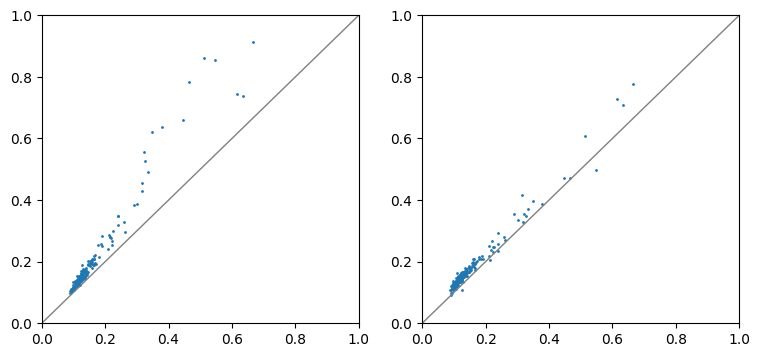

In [1613]:
plt.figure(figsize=(9,4))
plt.subplot(1, 2, 1)
plt.scatter(all_rmse['omiclip_st'], all_rmse['paste'], s=1)
plt.plot([0,2],[0,2], linewidth=1, c='grey')
plt.xlim((0,1))
plt.ylim((0,1))

plt.subplot(1, 2, 2)
plt.scatter(all_rmse['omiclip_st'], all_rmse['gpsa'], s=1)
plt.plot([0,2],[0,2], linewidth=1, c='grey')
plt.xlim((0,1))
plt.ylim((0,1))

In [1614]:
omiclip_st_stat = calculate_mse(shared_genes, omiclip_ad_tar_mean_expr, omiclip_ad_src_align_mean_expr, omiclip_matches_st)
omiclip_img_ft_stat = calculate_mse(shared_genes, omiclip_ad_tar_mean_expr, omiclip_ad_src_align_mean_expr, omiclip_matches_img_ft)
paste_stat = calculate_mse(shared_genes, paste_ad_tar_mean_expr, paste_ad_src_align_mean_expr, paste_matches)
gpsa_stat = calculate_mse(shared_genes, gpsa_ad_tar_mean_expr, gpsa_ad_src_align_mean_expr, gpsa_matches)

100%|██████████| 221/221 [00:00<00:00, 827.32it/s]


In [1615]:
all_mse = pd.concat([omiclip_st_stat['mse'], 
                     omiclip_img_ft_stat['mse'], 
                     gpsa_stat['mse'], 
                     paste_stat['mse'], 
                    ],axis=1)
all_mse.columns = ['omiclip_st','omiclip_img_ft','gpsa','paste']
all_mse

,omiclip_st,omiclip_img_ft,gpsa,paste
MT-ND4,0.401670,0.408912,0.500631,0.544779
MT-CO3,0.378585,0.381368,0.528320,0.552180
CD74,0.443419,0.473573,0.604009,0.832430
CTSD,0.216822,0.266493,0.222593,0.611410
SERPINA1,0.299202,0.378279,0.246266,0.728864
...,...,...,...,...
FAM3C,0.008765,0.008247,0.015521,0.011452
TMEM159,0.009557,0.010681,0.012769,0.013537
DNAJC4,0.009391,0.008541,0.017428,0.011843
TADA3,0.010643,0.010504,0.012542,0.012552


In [1616]:
all_mse.to_csv(case_dir+src_sample_name+'_all_mse.csv')

<Axes: >

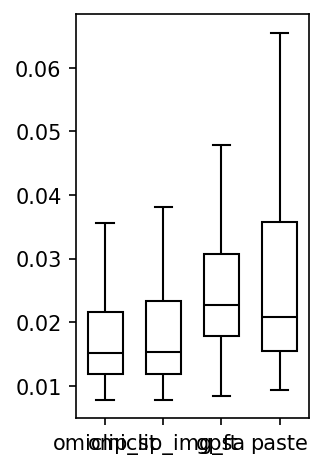

In [1617]:
plt.figure(figsize=(2,3.5), dpi=150)
sns.boxplot(all_mse, showfliers=False, width=0.6, linecolor = 'black', linewidth=1, color='white')
# plt.ylim((0.05,0.4))

In [1618]:
ranksums(all_mse['paste'], all_mse['omiclip_img_ft'], alternative='greater')

RanksumsResult(statistic=5.952966869190826, pvalue=1.3166230986734018e-09)

In [1619]:
ranksums(all_mse['gpsa'], all_mse['omiclip_img_ft'], alternative='greater')

RanksumsResult(statistic=7.293473576458417, pvalue=1.5103199190515103e-13)

In [1620]:
ranksums(all_mse['omiclip_img_ft'], all_mse['omiclip_st'], alternative='greater')

RanksumsResult(statistic=0.3928429378242523, pvalue=0.34721774455404286)

(0.0, 1.0)

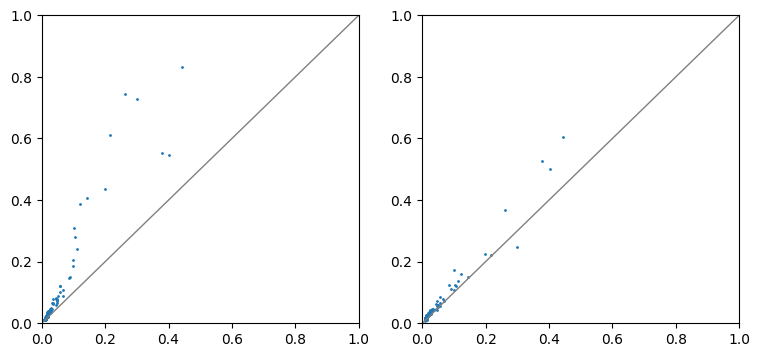

In [1621]:
plt.figure(figsize=(9,4))
plt.subplot(1, 2, 1)
plt.scatter(all_mse['omiclip_st'], all_mse['paste'], s=1)
plt.plot([0,2],[0,2], linewidth=1, c='grey')
plt.xlim((0,1))
plt.ylim((0,1))

plt.subplot(1, 2, 2)
plt.scatter(all_mse['omiclip_st'], all_mse['gpsa'], s=1)
plt.plot([0,2],[0,2], linewidth=1, c='grey')
plt.xlim((0,1))
plt.ylim((0,1))

# V10F24-048_C1

In [1623]:
src_sample_name = 'V10F24-048_C1'
ad_src, ad_src_coor, src_img =  prepare_data(src_sample_name)

## Omiclip ST to ST

In [1624]:
case_name = '_coca_after_training20'

In [1625]:
feature_type = '_coca_txt_features'
tar_features = get_features(tar_sample_name, feature_type, case_name)
src_features = get_features(src_sample_name, feature_type, case_name)

In [1626]:
pca_comb_features, pca_comb_features_batch = get_pca_by_fit(tar_features, src_features)

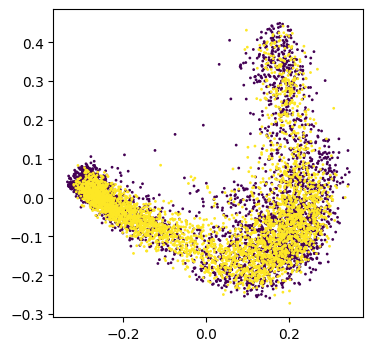

In [1627]:
plt.figure(figsize=(4,4))
plt.scatter(pca_comb_features[:,0], pca_comb_features[:,1],c=pca_comb_features_batch, s=1)

In [1628]:
pca_rgb_comb = (pca_comb_features-pca_comb_features.min(axis=0))/(pca_comb_features.max(axis=0)-pca_comb_features.min(axis=0))
pca_hex_comb = [ rgb2hex(pca_rgb_comb[i,:]) for i in range(pca_rgb_comb.shape[0]) ]

In [757]:
alpha = 0.5
cpd_coor, homo_coor, aligned_image = cpd_align(ad_tar_coor, ad_src_coor, pca_comb_features, src_img, alpha)

In [758]:
# plot_alignment_with_img(ad_tar_coor, ad_src_coor, homo_coor, tar_img, src_img, aligned_image, pca_hex_comb, tar_features)

In [759]:
shift=300
s=0.8
# plot_alignment(ad_tar_coor, ad_src_coor, homo_coor, pca_hex_comb, tar_features, shift=300, s=0.8)

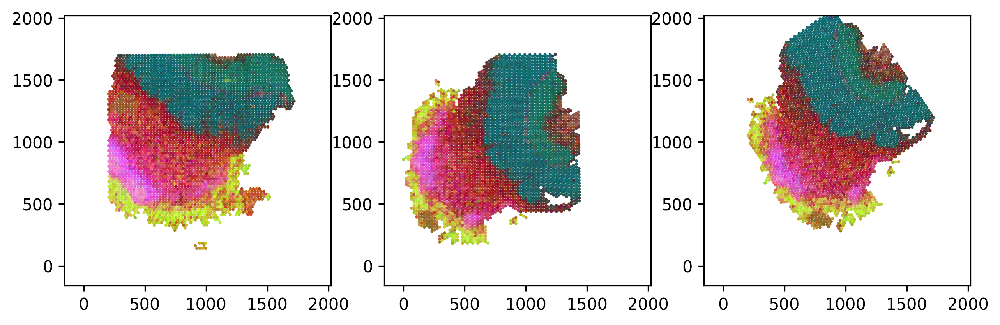

In [760]:
plot_alignment(ad_tar_coor, ad_src_coor, homo_coor, pca_hex_comb, tar_features, shift=300, s=0.8, boundary_line=False)

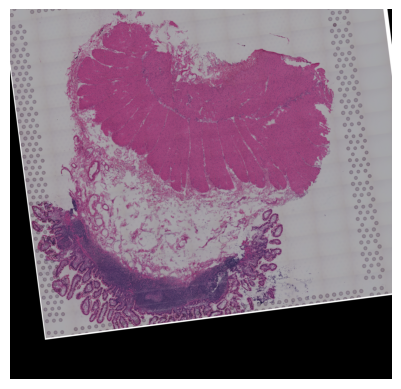

In [201]:
plt.imshow(aligned_image, origin='lower')
plt.axis('off')
plt.show()

In [202]:
save_name = 'omiclip_st_st_'+src_sample_name+'.h5ad'
wirte_aligned_data(ad_src, aligned_image, homo_coor, save_name)

## Omiclip Img to ST

In [203]:
generate_features_finetune10(src_sample_name)

100%|██████████| 3487/3487 [01:54<00:00, 30.52it/s]


In [204]:
case_name = '_finetune10'

In [205]:
tar_features = get_features(tar_sample_name, '_text_feature', case_name)
src_features = get_features(src_sample_name, '_image_feature', case_name)

In [206]:
pca_comb_features, pca_comb_features_batch = get_pca_by_fit(tar_features, src_features)

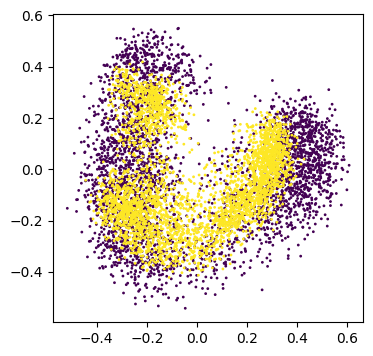

In [207]:
plt.figure(figsize=(4,4))
plt.scatter(pca_comb_features[:,0], pca_comb_features[:,1],c=pca_comb_features_batch, s=1)

In [208]:
alpha = 0.5
cpd_coor, homo_coor, aligned_image = cpd_align(ad_tar_coor, ad_src_coor, pca_comb_features, src_img, alpha)

In [209]:
# plot_alignment_with_img(ad_tar_coor, ad_src_coor, homo_coor, tar_img, src_img, aligned_image, pca_hex_comb, tar_features)

In [210]:
shift=300
s=0.8
# plot_alignment(ad_tar_coor, ad_src_coor, homo_coor, pca_hex_comb, tar_features, shift=300, s=0.8)

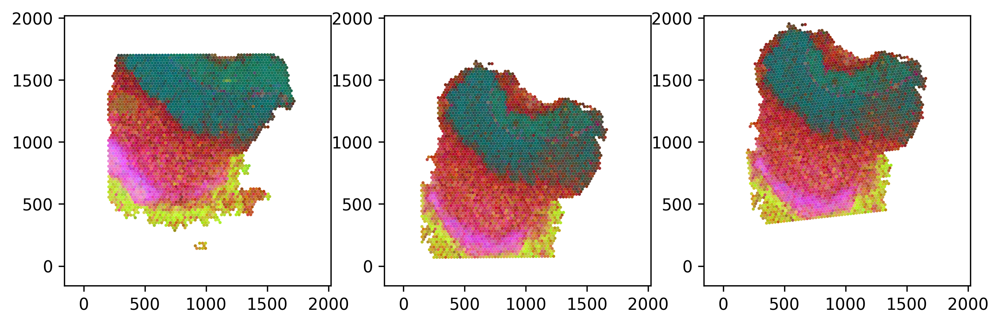

In [211]:
plot_alignment(ad_tar_coor, ad_src_coor, homo_coor, pca_hex_comb, tar_features, shift=300, s=0.8, boundary_line=False)

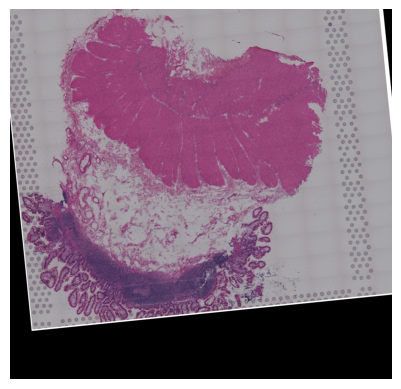

In [212]:
plt.imshow(aligned_image, origin='lower')
plt.axis('off')
plt.show()

In [213]:
save_name = 'omiclip_st_img_finetune10_'+src_sample_name+'.h5ad'
wirte_aligned_data(ad_src, aligned_image, homo_coor, save_name)

## Omiclip Results

In [1629]:
omiclip_ad_tar = ad_tar.copy()
omiclip_ad_src_align_st = sc.read_h5ad(case_dir_omiclip+'omiclip_st_st_'+src_sample_name+'.h5ad')
omiclip_ad_src_align_img_ft = sc.read_h5ad(case_dir_omiclip+'omiclip_st_img_finetune10_'+src_sample_name+'.h5ad')

In [1630]:
omiclip_ad_tar = filter_norm_log1p(omiclip_ad_tar)
omiclip_ad_src_align_st = filter_norm_log1p(omiclip_ad_src_align_st)
omiclip_ad_src_align_img_ft = filter_norm_log1p(omiclip_ad_src_align_img_ft)

In [1631]:
omiclip_ad_tar_heg_of_hvg = get_heg_of_hvg(omiclip_ad_tar)
omiclip_ad_src_heg_of_hvg = get_heg_of_hvg(omiclip_ad_src_align_st)
omiclip_genes = [value for value in omiclip_ad_tar_heg_of_hvg.index.tolist() if value in omiclip_ad_src_heg_of_hvg.index.tolist()]
len(omiclip_genes)

225

In [1632]:
omiclip_ad_tar_mean_expr = get_mean_expr_by_neighbor(omiclip_ad_tar)
omiclip_ad_src_mean_expr = get_mean_expr_by_neighbor(omiclip_ad_src_align_st)

100%|██████████| 3487/3487 [00:12<00:00, 273.13it/s]


In [1633]:
scalef_tar = get_scalefactors(omiclip_ad_tar)['tissue_hires_scalef']
scalef_src = get_scalefactors(omiclip_ad_src)['tissue_hires_scalef']
omiclip_matches_st = nearest_neighbour(omiclip_ad_src_align_st.obsm['spatial']*scalef_src, omiclip_ad_tar.obsm['spatial']*scalef_tar)
omiclip_matches_img_ft = nearest_neighbour(omiclip_ad_src_align_img_ft.obsm['spatial']*scalef_src, omiclip_ad_tar.obsm['spatial']*scalef_tar)

Processing coordinates: 100%|██████████| 3487/3487 [00:47<00:00, 72.75it/s]


## Paste

Using selected backend cpu. If you want to use gpu, set use_gpu = True.


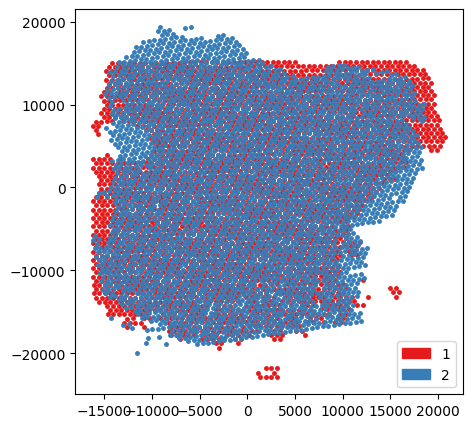

In [220]:
paste_align(src_sample_name)

In [1634]:
paste_tar_ad = sc.read_h5ad(paste_path+'paste_aligment_target_'+src_sample_name+'.h5ad')
paste_align_ad = sc.read_h5ad(paste_path+'paste_aligment_source_'+src_sample_name+'.h5ad')
paste_tar_ad = filter_norm_log1p(paste_tar_ad)
paste_align_ad = filter_norm_log1p(paste_align_ad)

In [1635]:
ad_src = sc.read_h5ad(os.path.join(data_dir, src_sample_name+'.h5ad'))
paste_shared_index = find_matching_indices(ad_src.obs.index.to_list(), paste_align_ad.obs.index.to_list())
paste_tar_coor = (paste_tar_ad.obsm['spatial']-paste_tar_ad.obsm['spatial'].min())/(paste_tar_ad.obsm['spatial'].max()-paste_tar_ad.obsm['spatial'].min())*(ad_tar_coor.max()-ad_tar_coor.min())
paste_align_coor = (paste_align_ad.obsm['spatial']-paste_tar_ad.obsm['spatial'].min())/(paste_tar_ad.obsm['spatial'].max()-paste_tar_ad.obsm['spatial'].min())*(ad_tar_coor.max()-ad_tar_coor.min())

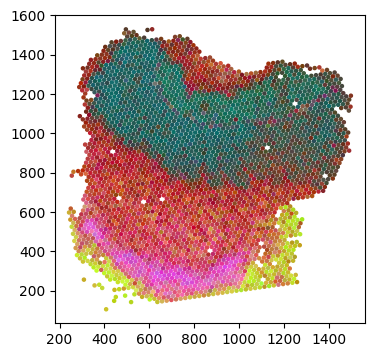

In [1636]:
plt.figure(figsize=(4,4))
plt.scatter(paste_align_coor[:,0], paste_align_coor[:,1], s=5, c=[pca_hex_comb[len(tar_features.T):][i] for i in paste_shared_index[:,0]])

In [1637]:
paste_ad_tar_mean_expr = get_mean_expr_by_neighbor(paste_tar_ad)
paste_ad_src_align_mean_expr = get_mean_expr_by_neighbor(paste_align_ad)

100%|██████████| 3373/3373 [00:11<00:00, 298.87it/s]


In [1638]:
paste_matches = nearest_neighbour(paste_align_coor, paste_tar_coor)

Processing coordinates: 100%|██████████| 3373/3373 [00:44<00:00, 76.05it/s]


## GPSA

In [1639]:
gpsa_tar_ad = sc.read_h5ad(case_dir+'gpsa/gpsa_target_'+src_sample_name+'.h5ad')
gpsa_align_ad = sc.read_h5ad(case_dir+'gpsa/gpsa_alignment_'+src_sample_name+'.h5ad')

gpsa_align = pd.read_csv(case_dir+'gpsa/gpsa_align_coor_'+src_sample_name+'.csv', index_col=0)
gpsa_align = np.array(gpsa_align)
gpsa_tar = pd.read_csv(case_dir+'gpsa/gpsa_tar_coor_'+src_sample_name+'.csv', index_col=0)
gpsa_tar = np.array(gpsa_tar)

ad_src = sc.read_h5ad(os.path.join(data_dir, src_sample_name+'.h5ad'))
gpsa_shared_index = find_matching_indices(ad_src.obs.index.to_list(), gpsa_align_ad.obs.index.to_list())

gpsa_align_resize = (gpsa_align/10)*(ad_tar_coor.max(axis=0)-ad_tar_coor.min(axis=0))+ad_tar_coor.min(axis=0)
gpsa_tar_resize = (gpsa_tar/10)*(ad_tar_coor.max(axis=0)-ad_tar_coor.min(axis=0))+ad_tar_coor.min(axis=0)
gpsa_align_ad.obs[['newy', 'newx']] = gpsa_align_resize
gpsa_tar_ad.obs[['newy', 'newx']] = gpsa_tar_resize

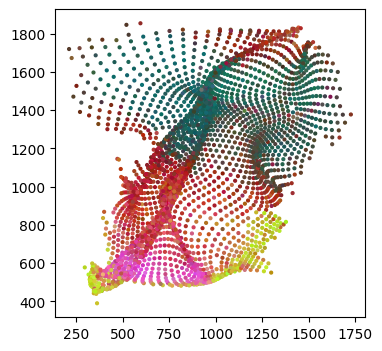

In [1640]:
plt.figure(figsize=(4, 4))
plt.scatter(gpsa_align_resize[:,0], gpsa_align_resize[:,1], c = [pca_hex_comb[len(tar_features.T):][i] for i in gpsa_shared_index[:,0]],s=4)

In [1641]:
gpsa_ad_tar_mean_expr = get_mean_expr_by_dist(gpsa_tar_ad)
gpsa_ad_src_align_mean_expr = get_mean_expr_by_dist(gpsa_align_ad)

100%|██████████| 3379/3379 [00:05<00:00, 597.35it/s]


In [1642]:
shared_genes = [value for value in omiclip_genes if value in gpsa_ad_tar_mean_expr.columns.tolist()]
shared_genes = [value for value in shared_genes if value in gpsa_ad_src_align_mean_expr.columns.tolist()]
len(shared_genes)

197

In [1643]:
gpsa_matches = nearest_neighbour(gpsa_align_resize, gpsa_tar_resize)
gpsa_matches.shape

Processing coordinates: 100%|██████████| 3379/3379 [00:50<00:00, 66.29it/s]


(3200, 2)

## Combine Analysis

In [1644]:
omiclip_st_stat = calculate_rmse(shared_genes, omiclip_ad_tar_mean_expr, omiclip_ad_src_align_mean_expr, omiclip_matches_st)
omiclip_img_ft_stat = calculate_rmse(shared_genes, omiclip_ad_tar_mean_expr, omiclip_ad_src_align_mean_expr, omiclip_matches_img_ft)
paste_stat = calculate_rmse(shared_genes, paste_ad_tar_mean_expr, paste_ad_src_align_mean_expr, paste_matches)
gpsa_stat = calculate_rmse(shared_genes, gpsa_ad_tar_mean_expr, gpsa_ad_src_align_mean_expr, gpsa_matches)

100%|██████████| 197/197 [00:00<00:00, 797.09it/s]


In [1645]:
all_rmse = pd.concat([omiclip_st_stat['rmse'], 
                     omiclip_img_ft_stat['rmse'], 
                     gpsa_stat['rmse'], 
                     paste_stat['rmse'], 
                    ],axis=1)
all_rmse.columns = ['omiclip_st','omiclip_img_ft','gpsa','paste']
all_rmse

,omiclip_st,omiclip_img_ft,gpsa,paste
MT-ND4,0.628790,0.638195,0.605337,0.602411
MT-CO3,0.628349,0.636606,0.704041,0.678033
MT-CO1,0.911503,0.913065,0.731228,0.669117
CTSD,0.757709,0.742011,0.388170,0.549610
SERPINA1,0.862024,0.832290,0.436749,0.671738
...,...,...,...,...
TMEM159,0.101093,0.102198,0.140226,0.132130
DNAJC4,0.098944,0.096920,0.138234,0.124673
FYB1,0.103867,0.102655,0.134224,0.133138
TADA3,0.100590,0.100081,0.101055,0.109633


In [1646]:
all_rmse.to_csv(case_dir+src_sample_name+'_all_rmse.csv')

(0.05, 0.4)

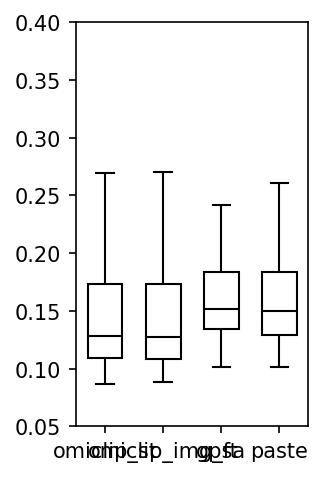

In [1647]:
plt.figure(figsize=(2,3.5), dpi=150)
sns.boxplot(all_rmse, showfliers=False, width=0.6, linecolor = 'black', linewidth=1, color='white')
plt.ylim((0.05,0.4))

In [1648]:
ranksums(all_rmse['paste'], all_rmse['omiclip_img_ft'], alternative='greater')

RanksumsResult(statistic=5.403676292475349, pvalue=3.264436250472618e-08)

In [1649]:
ranksums(all_rmse['gpsa'], all_rmse['omiclip_img_ft'], alternative='greater')

RanksumsResult(statistic=6.053975445151465, pvalue=7.065708021995964e-10)

In [1650]:
ranksums(all_rmse['omiclip_img_ft'], all_rmse['omiclip_st'], alternative='greater')

RanksumsResult(statistic=-0.2517144339270138, pvalue=0.599369100250603)

(0.0, 1.0)

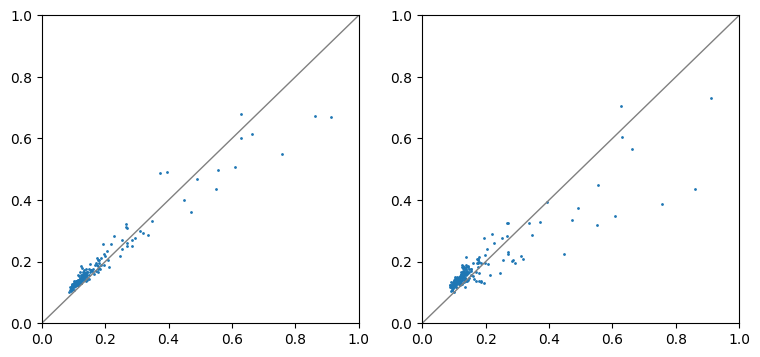

In [1651]:
plt.figure(figsize=(9,4))
plt.subplot(1, 2, 1)
plt.scatter(all_rmse['omiclip_st'], all_rmse['paste'], s=1)
plt.plot([0,2],[0,2], linewidth=1, c='grey')
plt.xlim((0,1))
plt.ylim((0,1))

plt.subplot(1, 2, 2)
plt.scatter(all_rmse['omiclip_st'], all_rmse['gpsa'], s=1)
plt.plot([0,2],[0,2], linewidth=1, c='grey')
plt.xlim((0,1))
plt.ylim((0,1))

In [1652]:
omiclip_st_stat = calculate_mse(shared_genes, omiclip_ad_tar_mean_expr, omiclip_ad_src_align_mean_expr, omiclip_matches_st)
omiclip_img_ft_stat = calculate_mse(shared_genes, omiclip_ad_tar_mean_expr, omiclip_ad_src_align_mean_expr, omiclip_matches_img_ft)
paste_stat = calculate_mse(shared_genes, paste_ad_tar_mean_expr, paste_ad_src_align_mean_expr, paste_matches)
gpsa_stat = calculate_mse(shared_genes, gpsa_ad_tar_mean_expr, gpsa_ad_src_align_mean_expr, gpsa_matches)

100%|██████████| 197/197 [00:00<00:00, 838.30it/s]


In [1653]:
all_mse = pd.concat([omiclip_st_stat['mse'], 
                     omiclip_img_ft_stat['mse'], 
                     gpsa_stat['mse'], 
                     paste_stat['mse'], 
                    ],axis=1)
all_mse.columns = ['omiclip_st','omiclip_img_ft','gpsa','paste']
all_mse

,omiclip_st,omiclip_img_ft,gpsa,paste
MT-ND4,0.395377,0.407293,0.366433,0.362899
MT-CO3,0.394822,0.405268,0.495673,0.459729
MT-CO1,0.830838,0.833688,0.534694,0.447717
CTSD,0.574122,0.550581,0.150676,0.302071
SERPINA1,0.743086,0.692707,0.190750,0.451231
...,...,...,...,...
TMEM159,0.010220,0.010444,0.019663,0.017458
DNAJC4,0.009790,0.009393,0.019109,0.015543
FYB1,0.010788,0.010538,0.018016,0.017726
TADA3,0.010118,0.010016,0.010212,0.012019


In [1654]:
all_mse.to_csv(case_dir+src_sample_name+'_all_mse.csv')

<Axes: >

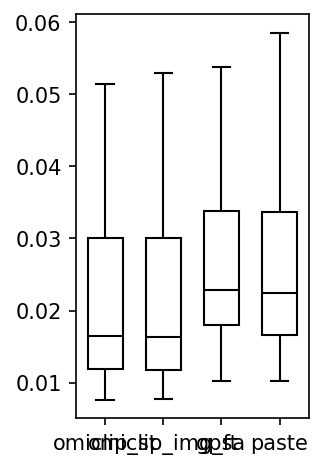

In [1655]:
plt.figure(figsize=(2,3.5), dpi=150)
sns.boxplot(all_mse, showfliers=False, width=0.6, linecolor = 'black', linewidth=1, color='white')
# plt.ylim((0.05,0.4))

In [1656]:
ranksums(all_mse['paste'], all_mse['omiclip_img_ft'], alternative='greater')

RanksumsResult(statistic=5.403676292475349, pvalue=3.264436250472618e-08)

In [1657]:
ranksums(all_mse['gpsa'], all_mse['omiclip_img_ft'], alternative='greater')

RanksumsResult(statistic=6.053975445151465, pvalue=7.065708021995964e-10)

In [1658]:
ranksums(all_mse['omiclip_img_ft'], all_mse['omiclip_st'], alternative='greater')

RanksumsResult(statistic=-0.2517144339270138, pvalue=0.599369100250603)

(0.0, 1.0)

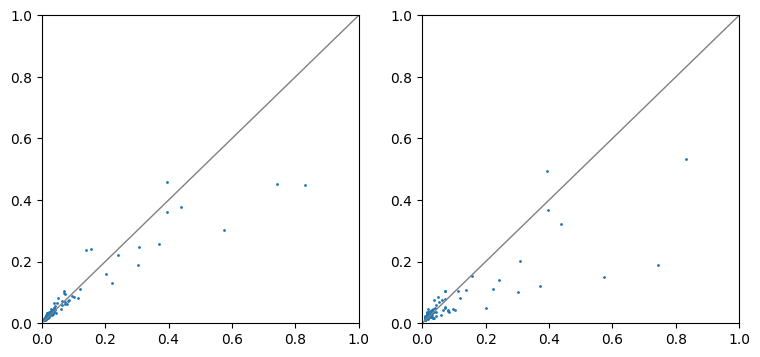

In [1659]:
plt.figure(figsize=(9,4))
plt.subplot(1, 2, 1)
plt.scatter(all_mse['omiclip_st'], all_mse['paste'], s=1)
plt.plot([0,2],[0,2], linewidth=1, c='grey')
plt.xlim((0,1))
plt.ylim((0,1))

plt.subplot(1, 2, 2)
plt.scatter(all_mse['omiclip_st'], all_mse['gpsa'], s=1)
plt.plot([0,2],[0,2], linewidth=1, c='grey')
plt.xlim((0,1))
plt.ylim((0,1))

# V10F24-048_D1

In [1661]:
src_sample_name = 'V10F24-048_D1'
ad_src, ad_src_coor, src_img =  prepare_data(src_sample_name)

## Omiclip ST to ST

In [1662]:
case_name = '_coca_after_training20'

In [1663]:
feature_type = '_coca_txt_features'
tar_features = get_features(tar_sample_name, feature_type, case_name)
src_features = get_features(src_sample_name, feature_type, case_name)

In [1664]:
pca_comb_features, pca_comb_features_batch = get_pca_by_fit(tar_features, src_features)

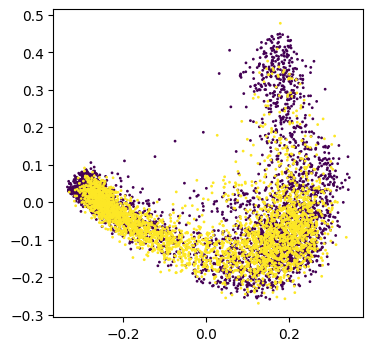

In [1665]:
plt.figure(figsize=(4,4))
plt.scatter(pca_comb_features[:,0], pca_comb_features[:,1],c=pca_comb_features_batch, s=1)

In [1666]:
pca_rgb_comb = (pca_comb_features-pca_comb_features.min(axis=0))/(pca_comb_features.max(axis=0)-pca_comb_features.min(axis=0))
pca_hex_comb = [ rgb2hex(pca_rgb_comb[i,:]) for i in range(pca_rgb_comb.shape[0]) ]

In [243]:
alpha = 0.5
cpd_coor, homo_coor, aligned_image = cpd_align(ad_tar_coor, ad_src_coor, pca_comb_features, src_img, alpha)

In [244]:
# plot_alignment_with_img(ad_tar_coor, ad_src_coor, homo_coor, tar_img, src_img, aligned_image, pca_hex_comb, tar_features)

In [245]:
shift=300
s=0.8
# plot_alignment(ad_tar_coor, ad_src_coor, homo_coor, pca_hex_comb, tar_features, shift=300, s=0.8)

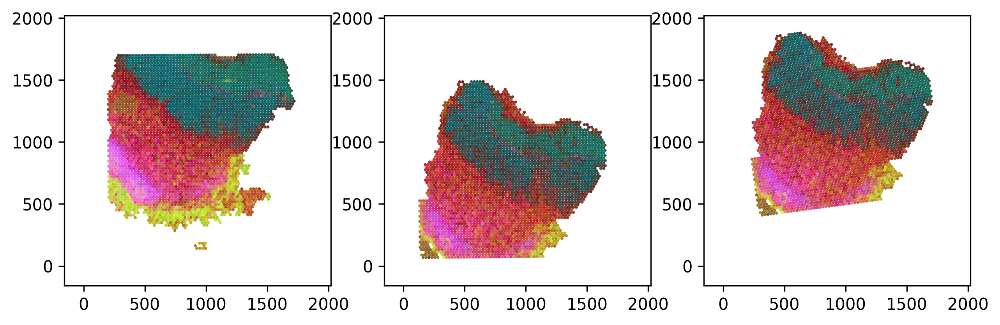

In [246]:
plot_alignment(ad_tar_coor, ad_src_coor, homo_coor, pca_hex_comb, tar_features, shift=300, s=0.8, boundary_line=False)

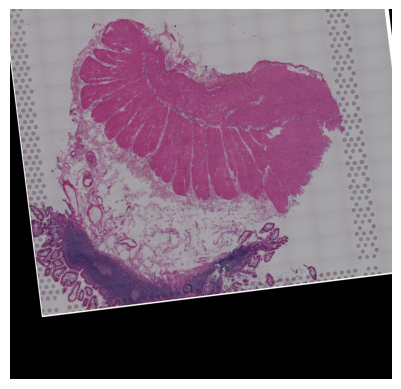

In [247]:
plt.imshow(aligned_image, origin='lower')
plt.axis('off')
plt.show()

In [248]:
save_name = 'omiclip_st_st_'+src_sample_name+'.h5ad'
wirte_aligned_data(ad_src, aligned_image, homo_coor, save_name)

## Omiclip Img to ST

In [249]:
generate_features_finetune10(src_sample_name)

100%|██████████| 3181/3181 [04:22<00:00, 12.12it/s]


In [250]:
case_name = '_finetune10'

In [251]:
tar_features = get_features(tar_sample_name, '_text_feature', case_name)
src_features = get_features(src_sample_name, '_image_feature', case_name)

In [252]:
pca_comb_features, pca_comb_features_batch = get_pca_by_fit(tar_features, src_features)

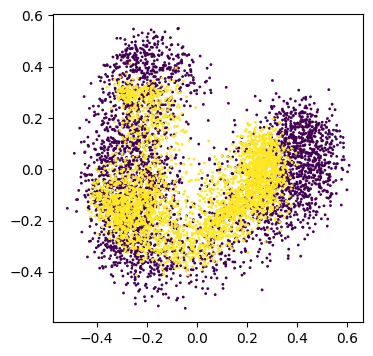

In [253]:
plt.figure(figsize=(4,4))
plt.scatter(pca_comb_features[:,0], pca_comb_features[:,1],c=pca_comb_features_batch, s=1)

In [254]:
alpha = 0.5
cpd_coor, homo_coor, aligned_image = cpd_align(ad_tar_coor, ad_src_coor, pca_comb_features, src_img, alpha)

In [255]:
# plot_alignment_with_img(ad_tar_coor, ad_src_coor, homo_coor, tar_img, src_img, aligned_image, pca_hex_comb, tar_features)

In [256]:
shift=300
s=0.8
# plot_alignment(ad_tar_coor, ad_src_coor, homo_coor, pca_hex_comb, tar_features, shift=300, s=0.8)

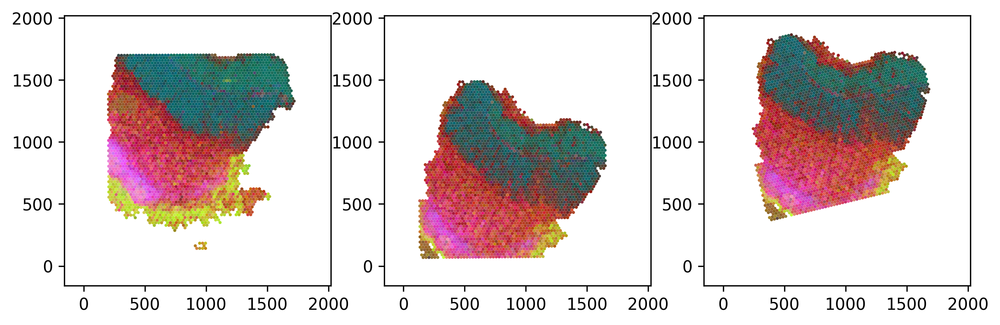

In [257]:
plot_alignment(ad_tar_coor, ad_src_coor, homo_coor, pca_hex_comb, tar_features, shift=300, s=0.8, boundary_line=False)

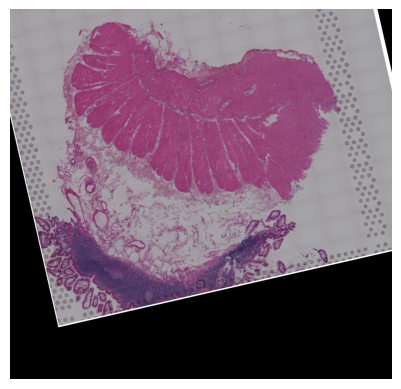

In [258]:
plt.imshow(aligned_image, origin='lower')
plt.axis('off')
plt.show()

In [259]:
save_name = 'omiclip_st_img_finetune10_'+src_sample_name+'.h5ad'
wirte_aligned_data(ad_src, aligned_image, homo_coor, save_name)

## Omiclip Results

In [1671]:
omiclip_ad_tar = ad_tar.copy()
omiclip_ad_src_align_st = sc.read_h5ad(case_dir_omiclip+'omiclip_st_st_'+src_sample_name+'.h5ad')
omiclip_ad_src_align_img_ft = sc.read_h5ad(case_dir_omiclip+'omiclip_st_img_finetune10_'+src_sample_name+'.h5ad')

In [1672]:
omiclip_ad_tar = filter_norm_log1p(omiclip_ad_tar)
omiclip_ad_src_align_st = filter_norm_log1p(omiclip_ad_src_align_st)
omiclip_ad_src_align_img_ft = filter_norm_log1p(omiclip_ad_src_align_img_ft)

In [1673]:
omiclip_ad_tar_heg_of_hvg = get_heg_of_hvg(omiclip_ad_tar)
omiclip_ad_src_heg_of_hvg = get_heg_of_hvg(omiclip_ad_src_align_st)
omiclip_genes = [value for value in omiclip_ad_tar_heg_of_hvg.index.tolist() if value in omiclip_ad_src_heg_of_hvg.index.tolist()]
len(omiclip_genes)

240

In [1674]:
omiclip_ad_tar_mean_expr = get_mean_expr_by_neighbor(omiclip_ad_tar)
omiclip_ad_src_mean_expr = get_mean_expr_by_neighbor(omiclip_ad_src_align_st)

100%|██████████| 3181/3181 [00:12<00:00, 245.69it/s]


In [1675]:
scalef_tar = get_scalefactors(omiclip_ad_tar)['tissue_hires_scalef']
scalef_src = get_scalefactors(omiclip_ad_src)['tissue_hires_scalef']
omiclip_matches_st = nearest_neighbour(omiclip_ad_src_align_st.obsm['spatial']*scalef_src, omiclip_ad_tar.obsm['spatial']*scalef_tar)
omiclip_matches_img_ft = nearest_neighbour(omiclip_ad_src_align_img_ft.obsm['spatial']*scalef_src, omiclip_ad_tar.obsm['spatial']*scalef_tar)

Processing coordinates: 100%|██████████| 3181/3181 [00:43<00:00, 72.60it/s]


## Paste

Using selected backend cpu. If you want to use gpu, set use_gpu = True.


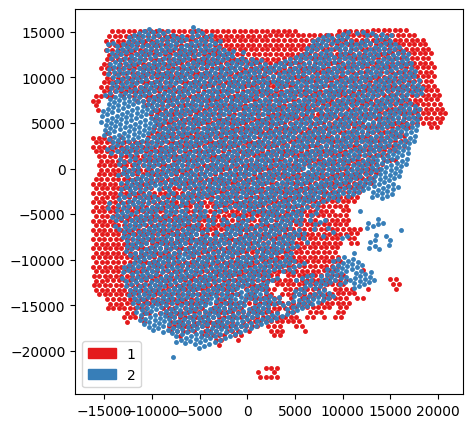

In [266]:
paste_align(src_sample_name)

In [1676]:
paste_tar_ad = sc.read_h5ad(paste_path+'paste_aligment_target_'+src_sample_name+'.h5ad')
paste_align_ad = sc.read_h5ad(paste_path+'paste_aligment_source_'+src_sample_name+'.h5ad')
paste_tar_ad = filter_norm_log1p(paste_tar_ad)
paste_align_ad = filter_norm_log1p(paste_align_ad)

In [1677]:
ad_src = sc.read_h5ad(os.path.join(data_dir, src_sample_name+'.h5ad'))
paste_shared_index = find_matching_indices(ad_src.obs.index.to_list(), paste_align_ad.obs.index.to_list())
paste_tar_coor = (paste_tar_ad.obsm['spatial']-paste_tar_ad.obsm['spatial'].min())/(paste_tar_ad.obsm['spatial'].max()-paste_tar_ad.obsm['spatial'].min())*(ad_tar_coor.max()-ad_tar_coor.min())
paste_align_coor = (paste_align_ad.obsm['spatial']-paste_tar_ad.obsm['spatial'].min())/(paste_tar_ad.obsm['spatial'].max()-paste_tar_ad.obsm['spatial'].min())*(ad_tar_coor.max()-ad_tar_coor.min())

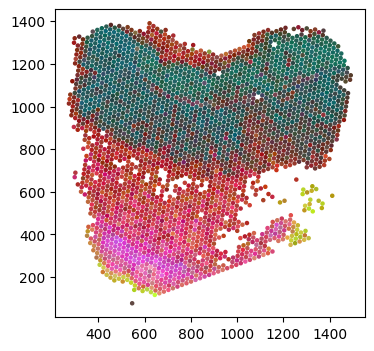

In [1678]:
plt.figure(figsize=(4,4))
plt.scatter(paste_align_coor[:,0], paste_align_coor[:,1], s=5, c=[pca_hex_comb[len(tar_features.T):][i] for i in paste_shared_index[:,0]])

In [1679]:
paste_ad_tar_mean_expr = get_mean_expr_by_neighbor(paste_tar_ad)
paste_ad_src_align_mean_expr = get_mean_expr_by_neighbor(paste_align_ad)

100%|██████████| 2836/2836 [00:08<00:00, 334.16it/s]


In [1680]:
paste_matches = nearest_neighbour(paste_align_coor, paste_tar_coor)

Processing coordinates: 100%|██████████| 2836/2836 [00:37<00:00, 75.65it/s]


## GPSA

In [1681]:
gpsa_tar_ad = sc.read_h5ad(case_dir+'gpsa/gpsa_target_'+src_sample_name+'.h5ad')
gpsa_align_ad = sc.read_h5ad(case_dir+'gpsa/gpsa_alignment_'+src_sample_name+'.h5ad')

gpsa_align = pd.read_csv(case_dir+'gpsa/gpsa_align_coor_'+src_sample_name+'.csv', index_col=0)
gpsa_align = np.array(gpsa_align)
gpsa_tar = pd.read_csv(case_dir+'gpsa/gpsa_tar_coor_'+src_sample_name+'.csv', index_col=0)
gpsa_tar = np.array(gpsa_tar)

ad_src = sc.read_h5ad(os.path.join(data_dir, src_sample_name+'.h5ad'))
gpsa_shared_index = find_matching_indices(ad_src.obs.index.to_list(), gpsa_align_ad.obs.index.to_list())

gpsa_align_resize = (gpsa_align/10)*(ad_tar_coor.max(axis=0)-ad_tar_coor.min(axis=0))+ad_tar_coor.min(axis=0)
gpsa_tar_resize = (gpsa_tar/10)*(ad_tar_coor.max(axis=0)-ad_tar_coor.min(axis=0))+ad_tar_coor.min(axis=0)
gpsa_align_ad.obs[['newy', 'newx']] = gpsa_align_resize
gpsa_tar_ad.obs[['newy', 'newx']] = gpsa_tar_resize

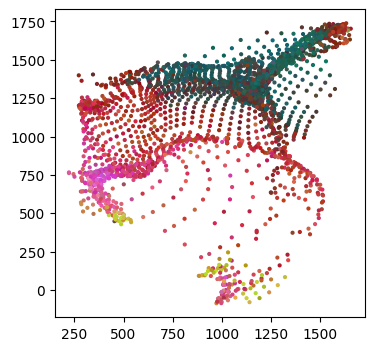

In [1682]:
plt.figure(figsize=(4, 4))
plt.scatter(gpsa_align_resize[:,0], gpsa_align_resize[:,1], c = [pca_hex_comb[len(tar_features.T):][i] for i in gpsa_shared_index[:,0]],s=4)

In [1683]:
gpsa_ad_tar_mean_expr = get_mean_expr_by_dist(gpsa_tar_ad)
gpsa_ad_src_align_mean_expr = get_mean_expr_by_dist(gpsa_align_ad)

100%|██████████| 2857/2857 [00:04<00:00, 596.08it/s]


In [1684]:
shared_genes = [value for value in omiclip_genes if value in gpsa_ad_tar_mean_expr.columns.tolist()]
shared_genes = [value for value in shared_genes if value in gpsa_ad_src_align_mean_expr.columns.tolist()]
len(shared_genes)

191

In [1685]:
gpsa_matches = nearest_neighbour(gpsa_align_resize, gpsa_tar_resize)
gpsa_matches.shape

Processing coordinates: 100%|██████████| 2857/2857 [00:42<00:00, 66.71it/s]


(2587, 2)

## Combine Analysis

In [1686]:
omiclip_st_stat = calculate_rmse(shared_genes, omiclip_ad_tar_mean_expr, omiclip_ad_src_align_mean_expr, omiclip_matches_st)
omiclip_img_ft_stat = calculate_rmse(shared_genes, omiclip_ad_tar_mean_expr, omiclip_ad_src_align_mean_expr, omiclip_matches_img_ft)
paste_stat = calculate_rmse(shared_genes, paste_ad_tar_mean_expr, paste_ad_src_align_mean_expr, paste_matches)
gpsa_stat = calculate_rmse(shared_genes, gpsa_ad_tar_mean_expr, gpsa_ad_src_align_mean_expr, gpsa_matches)

100%|██████████| 191/191 [00:00<00:00, 812.09it/s]


In [1687]:
all_rmse = pd.concat([omiclip_st_stat['rmse'], 
                     omiclip_img_ft_stat['rmse'], 
                     gpsa_stat['rmse'], 
                     paste_stat['rmse'], 
                    ],axis=1)
all_rmse.columns = ['omiclip_st','omiclip_img_ft','gpsa','paste']
all_rmse

,omiclip_st,omiclip_img_ft,gpsa,paste
MT-ND4,0.632798,0.620043,0.562483,0.633596
MT-CO1,0.934034,0.937580,0.528755,0.511444
MYL9,1.003088,1.013714,0.641217,0.608396
CD74,0.763850,0.739239,0.541439,0.645843
CTSD,0.670522,0.653961,0.434548,0.663764
...,...,...,...,...
MARCKSL1,0.113402,0.112187,0.118456,0.125361
TRIM56,0.091813,0.090559,0.106672,0.105764
STX7,0.087917,0.086394,0.096536,0.099015
TMEM159,0.100702,0.103424,0.116412,0.119519


In [1688]:
all_rmse.to_csv(case_dir+src_sample_name+'_all_rmse.csv')

(0.05, 0.4)

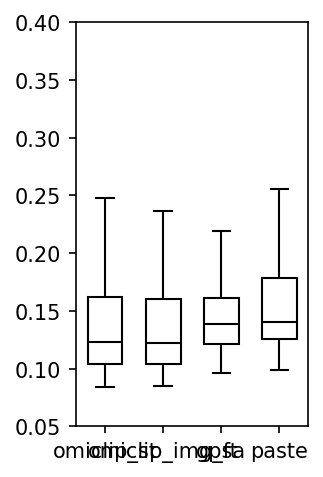

In [1689]:
plt.figure(figsize=(2,3.5), dpi=150)
sns.boxplot(all_rmse, showfliers=False, width=0.6, linecolor = 'black', linewidth=1, color='white')
plt.ylim((0.05,0.4))

In [1690]:
ranksums(all_rmse['paste'], all_rmse['omiclip_img_ft'], alternative='greater')

RanksumsResult(statistic=5.259712389500234, pvalue=7.214044660156595e-08)

In [1691]:
ranksums(all_rmse['gpsa'], all_rmse['omiclip_img_ft'], alternative='greater')

RanksumsResult(statistic=4.461789322394305, pvalue=4.063905705096378e-06)

In [1692]:
ranksums(all_rmse['omiclip_img_ft'], all_rmse['omiclip_st'], alternative='greater')

RanksumsResult(statistic=-0.18117765344855885, pvalue=0.5718859328572646)

(0.0, 1.0)

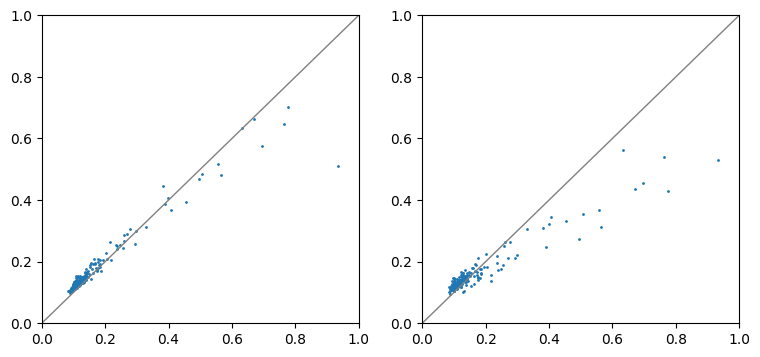

In [1693]:
plt.figure(figsize=(9,4))
plt.subplot(1, 2, 1)
plt.scatter(all_rmse['omiclip_st'], all_rmse['paste'], s=1)
plt.plot([0,2],[0,2], linewidth=1, c='grey')
plt.xlim((0,1))
plt.ylim((0,1))

plt.subplot(1, 2, 2)
plt.scatter(all_rmse['omiclip_st'], all_rmse['gpsa'], s=1)
plt.plot([0,2],[0,2], linewidth=1, c='grey')
plt.xlim((0,1))
plt.ylim((0,1))

In [1694]:
omiclip_st_stat = calculate_mse(shared_genes, omiclip_ad_tar_mean_expr, omiclip_ad_src_align_mean_expr, omiclip_matches_st)
omiclip_img_ft_stat = calculate_mse(shared_genes, omiclip_ad_tar_mean_expr, omiclip_ad_src_align_mean_expr, omiclip_matches_img_ft)
paste_stat = calculate_mse(shared_genes, paste_ad_tar_mean_expr, paste_ad_src_align_mean_expr, paste_matches)
gpsa_stat = calculate_mse(shared_genes, gpsa_ad_tar_mean_expr, gpsa_ad_src_align_mean_expr, gpsa_matches)

100%|██████████| 191/191 [00:00<00:00, 849.71it/s]


In [1695]:
all_mse = pd.concat([omiclip_st_stat['mse'], 
                     omiclip_img_ft_stat['mse'], 
                     gpsa_stat['mse'], 
                     paste_stat['mse'], 
                    ],axis=1)
all_mse.columns = ['omiclip_st','omiclip_img_ft','gpsa','paste']
all_mse

,omiclip_st,omiclip_img_ft,gpsa,paste
MT-ND4,0.400433,0.384453,0.316387,0.401444
MT-CO1,0.872419,0.879056,0.279582,0.261575
MYL9,1.006186,1.027616,0.411159,0.370146
CD74,0.583466,0.546475,0.293156,0.417113
CTSD,0.449600,0.427665,0.188832,0.440583
...,...,...,...,...
MARCKSL1,0.012860,0.012586,0.014032,0.015715
TRIM56,0.008430,0.008201,0.011379,0.011186
STX7,0.007729,0.007464,0.009319,0.009804
TMEM159,0.010141,0.010696,0.013552,0.014285


In [1696]:
all_mse.to_csv(case_dir+src_sample_name+'_all_mse.csv')

<Axes: >

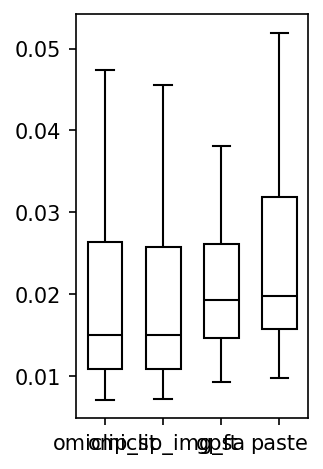

In [1697]:
plt.figure(figsize=(2,3.5), dpi=150)
sns.boxplot(all_mse, showfliers=False, width=0.6, linecolor = 'black', linewidth=1, color='white')
# plt.ylim((0.05,0.4))

In [1698]:
ranksums(all_mse['paste'], all_mse['omiclip_img_ft'], alternative='greater')

RanksumsResult(statistic=5.259712389500234, pvalue=7.214044660156595e-08)

In [1699]:
ranksums(all_mse['gpsa'], all_mse['omiclip_img_ft'], alternative='greater')

RanksumsResult(statistic=4.461789322394305, pvalue=4.063905705096378e-06)

In [1700]:
ranksums(all_mse['omiclip_img_ft'], all_mse['omiclip_st'], alternative='greater')

RanksumsResult(statistic=-0.18117765344855885, pvalue=0.5718859328572646)

(0.0, 1.0)

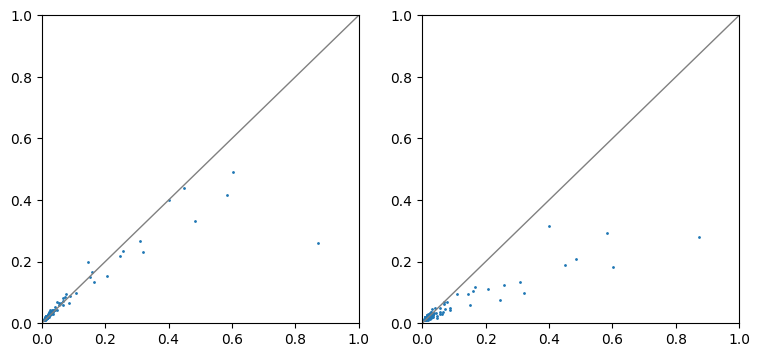

In [1701]:
plt.figure(figsize=(9,4))
plt.subplot(1, 2, 1)
plt.scatter(all_mse['omiclip_st'], all_mse['paste'], s=1)
plt.plot([0,2],[0,2], linewidth=1, c='grey')
plt.xlim((0,1))
plt.ylim((0,1))

plt.subplot(1, 2, 2)
plt.scatter(all_mse['omiclip_st'], all_mse['gpsa'], s=1)
plt.plot([0,2],[0,2], linewidth=1, c='grey')
plt.xlim((0,1))
plt.ylim((0,1))

# V10F24-048_B1

### Preprocess

In [598]:
sample_name = 'V10F24-048_B1'

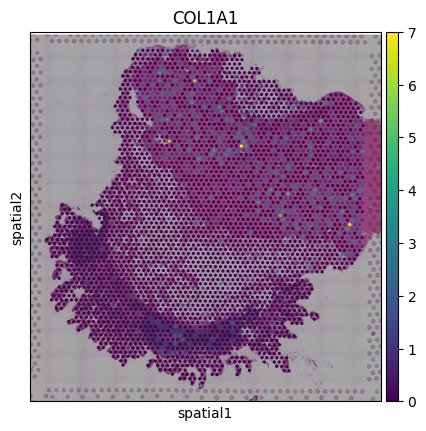

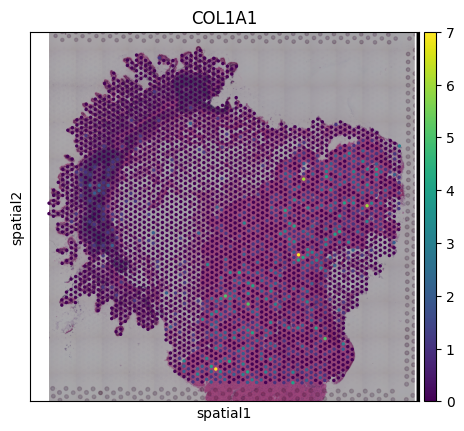

In [628]:
rotate_adata_90(sample_name)

In [1702]:
src_sample_name = 'V10F24-048_B1'+'_rotate90'
ad_src, ad_src_coor, src_img =  prepare_data(src_sample_name)

## Omiclip ST to ST

In [1703]:
case_name = '_coca_after_training20'

In [1704]:
feature_type = '_coca_txt_features'
tar_features = get_features(tar_sample_name, feature_type, case_name)
src_features = get_features(src_sample_name, feature_type, case_name)

In [1705]:
pca_comb_features, pca_comb_features_batch = get_pca_by_fit(tar_features, src_features)

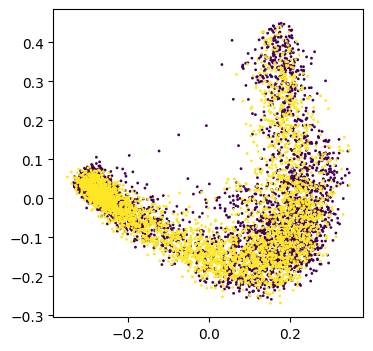

In [1706]:
plt.figure(figsize=(4,4))
plt.scatter(pca_comb_features[:,0], pca_comb_features[:,1],c=pca_comb_features_batch, s=1)

In [1707]:
pca_rgb_comb = (pca_comb_features-pca_comb_features.min(axis=0))/(pca_comb_features.max(axis=0)-pca_comb_features.min(axis=0))
pca_hex_comb = [ rgb2hex(pca_rgb_comb[i,:]) for i in range(pca_rgb_comb.shape[0]) ]

In [661]:
alpha = 0.5
cpd_coor, homo_coor, aligned_image = cpd_align(ad_tar_coor, ad_src_coor, pca_comb_features, src_img, alpha)

In [662]:
# plot_alignment_with_img(ad_tar_coor, ad_src_coor, homo_coor, tar_img, src_img, aligned_image, pca_hex_comb, tar_features)

In [663]:
shift=300
s=0.8
# plot_alignment(ad_tar_coor, ad_src_coor, homo_coor, pca_hex_comb, tar_features, shift=300, s=0.8)

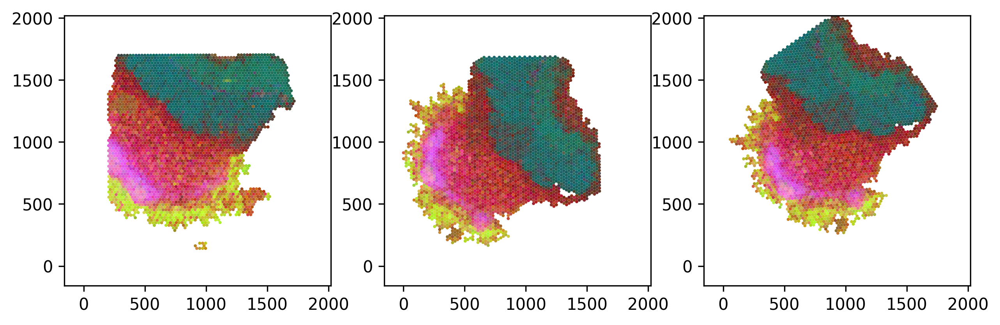

In [664]:
plot_alignment(ad_tar_coor, ad_src_coor, homo_coor, pca_hex_comb, tar_features, shift=300, s=0.8, boundary_line=False)

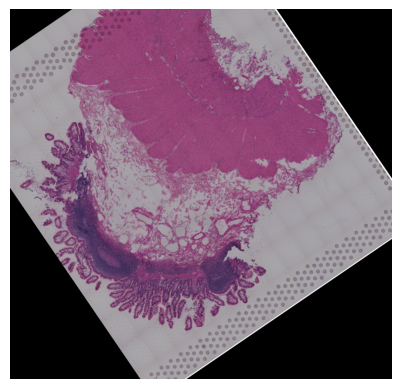

In [665]:
plt.imshow(aligned_image, origin='lower')
plt.axis('off')
plt.show()

In [666]:
save_name = 'omiclip_st_st_'+src_sample_name+'.h5ad'
wirte_aligned_data(ad_src, aligned_image, homo_coor, save_name)

## Omiclip Img to ST

In [667]:
generate_features_finetune10(src_sample_name)

100%|██████████| 3448/3448 [06:12<00:00,  9.26it/s]


In [668]:
case_name = '_finetune10'

In [669]:
tar_features = get_features(tar_sample_name, '_text_feature', case_name)
src_features = get_features(src_sample_name, '_image_feature', case_name)

In [670]:
pca_comb_features, pca_comb_features_batch = get_pca_by_fit(tar_features, src_features)

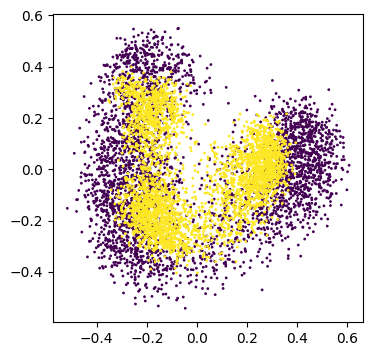

In [671]:
plt.figure(figsize=(4,4))
plt.scatter(pca_comb_features[:,0], pca_comb_features[:,1],c=pca_comb_features_batch, s=1)

In [672]:
alpha = 0.5
cpd_coor, homo_coor, aligned_image = cpd_align(ad_tar_coor, ad_src_coor, pca_comb_features, src_img, alpha)

In [673]:
# plot_alignment_with_img(ad_tar_coor, ad_src_coor, homo_coor, tar_img, src_img, aligned_image, pca_hex_comb, tar_features)

In [674]:
shift=300
s=0.8
# plot_alignment(ad_tar_coor, ad_src_coor, homo_coor, pca_hex_comb, tar_features, shift=300, s=0.8)

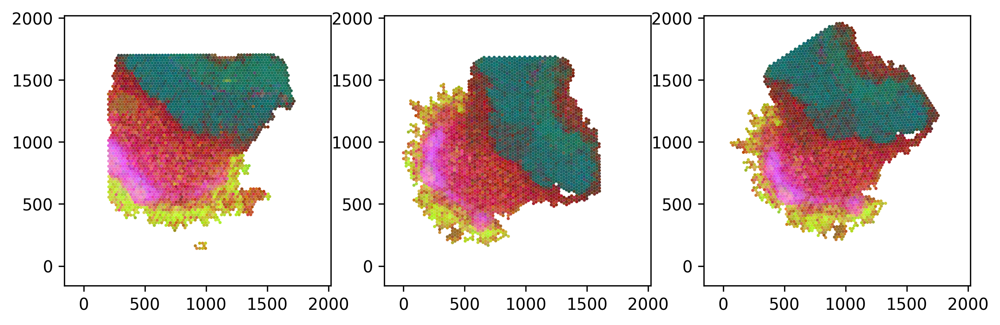

In [675]:
plot_alignment(ad_tar_coor, ad_src_coor, homo_coor, pca_hex_comb, tar_features, shift=300, s=0.8, boundary_line=False)

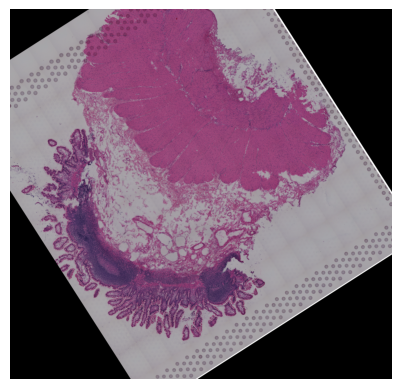

In [676]:
plt.imshow(aligned_image, origin='lower')
plt.axis('off')
plt.show()

In [677]:
save_name = 'omiclip_st_img_finetune10_'+src_sample_name+'.h5ad'
wirte_aligned_data(ad_src, aligned_image, homo_coor, save_name)

## Omiclip Results

In [1708]:
omiclip_ad_tar = ad_tar.copy()
omiclip_ad_src_align_st = sc.read_h5ad(case_dir_omiclip+'omiclip_st_st_'+src_sample_name+'.h5ad')
omiclip_ad_src_align_img_ft = sc.read_h5ad(case_dir_omiclip+'omiclip_st_img_finetune10_'+src_sample_name+'.h5ad')

In [1709]:
omiclip_ad_tar = filter_norm_log1p(omiclip_ad_tar)
omiclip_ad_src_align_st = filter_norm_log1p(omiclip_ad_src_align_st)
omiclip_ad_src_align_img_ft = filter_norm_log1p(omiclip_ad_src_align_img_ft)

In [1710]:
omiclip_ad_tar_heg_of_hvg = get_heg_of_hvg(omiclip_ad_tar)
omiclip_ad_src_heg_of_hvg = get_heg_of_hvg(omiclip_ad_src_align_st)
omiclip_genes = [value for value in omiclip_ad_tar_heg_of_hvg.index.tolist() if value in omiclip_ad_src_heg_of_hvg.index.tolist()]
len(omiclip_genes)

240

In [1711]:
omiclip_ad_tar_mean_expr = get_mean_expr_by_neighbor(omiclip_ad_tar)
omiclip_ad_src_mean_expr = get_mean_expr_by_neighbor(omiclip_ad_src_align_st)

100%|██████████| 3448/3448 [00:12<00:00, 266.58it/s]


In [1712]:
scalef_tar = get_scalefactors(omiclip_ad_tar)['tissue_hires_scalef']
scalef_src = get_scalefactors(omiclip_ad_src)['tissue_hires_scalef']
omiclip_matches_st = nearest_neighbour(omiclip_ad_src_align_st.obsm['spatial']*scalef_src, omiclip_ad_tar.obsm['spatial']*scalef_tar)
omiclip_matches_img_ft = nearest_neighbour(omiclip_ad_src_align_img_ft.obsm['spatial']*scalef_src, omiclip_ad_tar.obsm['spatial']*scalef_tar)

Processing coordinates: 100%|██████████| 3448/3448 [00:47<00:00, 72.64it/s]


## Paste

Using selected backend cpu. If you want to use gpu, set use_gpu = True.


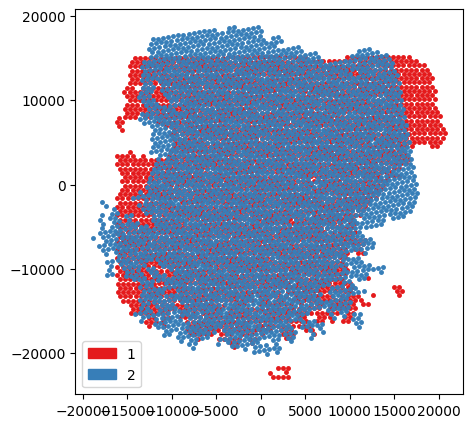

In [683]:
paste_align(src_sample_name)

In [1713]:
paste_tar_ad = sc.read_h5ad(paste_path+'paste_aligment_target_'+src_sample_name+'.h5ad')
paste_align_ad = sc.read_h5ad(paste_path+'paste_aligment_source_'+src_sample_name+'.h5ad')
sc.pp.normalize_total(paste_tar_ad)
sc.pp.normalize_total(paste_align_ad)
sc.pp.log1p(paste_tar_ad)
sc.pp.log1p(paste_align_ad)

In [1714]:
ad_src = sc.read_h5ad(os.path.join(data_dir, src_sample_name+'.h5ad'))
paste_shared_index = find_matching_indices(ad_src.obs.index.to_list(), paste_align_ad.obs.index.to_list())
paste_tar_coor = (paste_tar_ad.obsm['spatial']-paste_tar_ad.obsm['spatial'].min())/(paste_tar_ad.obsm['spatial'].max()-paste_tar_ad.obsm['spatial'].min())*(ad_tar_coor.max()-ad_tar_coor.min())
paste_align_coor = (paste_align_ad.obsm['spatial']-paste_tar_ad.obsm['spatial'].min())/(paste_tar_ad.obsm['spatial'].max()-paste_tar_ad.obsm['spatial'].min())*(ad_tar_coor.max()-ad_tar_coor.min())

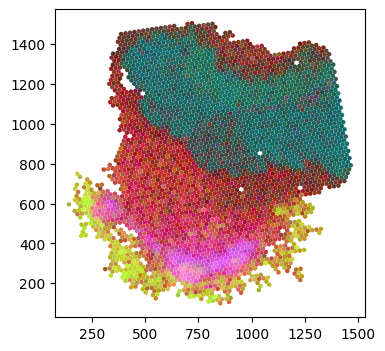

In [1715]:
plt.figure(figsize=(4,4))
plt.scatter(paste_align_coor[:,0], paste_align_coor[:,1], s=5, c=[pca_hex_comb[len(tar_features.T):][i] for i in paste_shared_index[:,0]])

In [1716]:
paste_ad_tar_mean_expr = get_mean_expr_by_neighbor(paste_tar_ad)
paste_ad_src_align_mean_expr = get_mean_expr_by_neighbor(paste_align_ad)

100%|██████████| 3347/3347 [00:10<00:00, 325.01it/s]


In [1717]:
paste_matches = nearest_neighbour(paste_align_coor, paste_tar_coor)

Processing coordinates: 100%|██████████| 3347/3347 [00:43<00:00, 76.57it/s]


## GPSA

In [1718]:
gpsa_tar_ad = sc.read_h5ad(case_dir+'gpsa/gpsa_target_'+src_sample_name+'.h5ad')
gpsa_align_ad = sc.read_h5ad(case_dir+'gpsa/gpsa_alignment_'+src_sample_name+'.h5ad')

gpsa_align = pd.read_csv(case_dir+'gpsa/gpsa_align_coor_'+src_sample_name+'.csv', index_col=0)
gpsa_align = np.array(gpsa_align)
gpsa_tar = pd.read_csv(case_dir+'gpsa/gpsa_tar_coor_'+src_sample_name+'.csv', index_col=0)
gpsa_tar = np.array(gpsa_tar)

ad_src = sc.read_h5ad(os.path.join(data_dir, src_sample_name+'.h5ad'))
gpsa_shared_index = find_matching_indices(ad_src.obs.index.to_list(), gpsa_align_ad.obs.index.to_list())

gpsa_align_resize = (gpsa_align/10)*(ad_tar_coor.max(axis=0)-ad_tar_coor.min(axis=0))+ad_tar_coor.min(axis=0)
gpsa_tar_resize = (gpsa_tar/10)*(ad_tar_coor.max(axis=0)-ad_tar_coor.min(axis=0))+ad_tar_coor.min(axis=0)
gpsa_align_ad.obs[['newy', 'newx']] = gpsa_align_resize
gpsa_tar_ad.obs[['newy', 'newx']] = gpsa_tar_resize

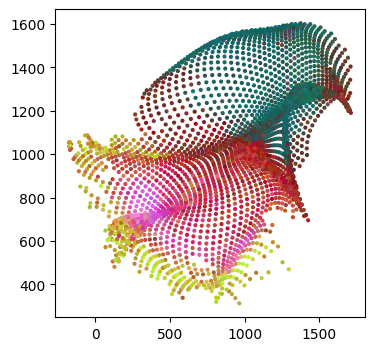

In [1719]:
plt.figure(figsize=(4, 4))
plt.scatter(gpsa_align_resize[:,0], gpsa_align_resize[:,1], c = [pca_hex_comb[len(tar_features.T):][i] for i in gpsa_shared_index[:,0]],s=4)

In [1720]:
gpsa_ad_tar_mean_expr = get_mean_expr_by_dist(gpsa_tar_ad)
gpsa_ad_src_align_mean_expr = get_mean_expr_by_dist(gpsa_align_ad)

100%|██████████| 3353/3353 [00:05<00:00, 588.52it/s]


In [1721]:
shared_genes = [value for value in omiclip_genes if value in gpsa_ad_tar_mean_expr.columns.tolist()]
shared_genes = [value for value in shared_genes if value in gpsa_ad_src_align_mean_expr.columns.tolist()]
len(shared_genes)

213

In [1722]:
gpsa_matches = nearest_neighbour(gpsa_align_resize, gpsa_tar_resize)
gpsa_matches.shape

Processing coordinates: 100%|██████████| 3353/3353 [00:50<00:00, 66.85it/s]


(3019, 2)

## Combine Analysis

In [1723]:
omiclip_st_stat = calculate_rmse(shared_genes, omiclip_ad_tar_mean_expr, omiclip_ad_src_align_mean_expr, omiclip_matches_st)
omiclip_img_ft_stat = calculate_rmse(shared_genes, omiclip_ad_tar_mean_expr, omiclip_ad_src_align_mean_expr, omiclip_matches_img_ft)
paste_stat = calculate_rmse(shared_genes, paste_ad_tar_mean_expr, paste_ad_src_align_mean_expr, paste_matches)
gpsa_stat = calculate_rmse(shared_genes, gpsa_ad_tar_mean_expr, gpsa_ad_src_align_mean_expr, gpsa_matches)

100%|██████████| 213/213 [00:00<00:00, 782.52it/s]


In [1724]:
all_rmse = pd.concat([omiclip_st_stat['rmse'], 
                     omiclip_img_ft_stat['rmse'], 
                     gpsa_stat['rmse'], 
                     paste_stat['rmse'], 
                    ],axis=1)
all_rmse.columns = ['omiclip_st','omiclip_img_ft','gpsa','paste']
all_rmse

,omiclip_st,omiclip_img_ft,gpsa,paste
MT-ND4,0.617371,0.623234,0.758474,0.722338
MT-CO3,0.617840,0.625407,0.705044,0.653954
MYL9,0.993810,0.983573,0.515302,0.496497
CTSD,0.732745,0.758115,0.476285,0.575380
SERPINA1,0.820003,0.880406,0.557309,0.665866
...,...,...,...,...
AC037459.4,0.110660,0.114462,0.123247,0.124754
DDT,0.091669,0.098032,0.134891,0.117635
TMEM159,0.102258,0.103314,0.141686,0.119765
DNAJC4,0.095141,0.096455,0.126399,0.121038


In [1725]:
all_rmse.to_csv(case_dir+src_sample_name+'_all_rmse.csv')

(0.05, 0.4)

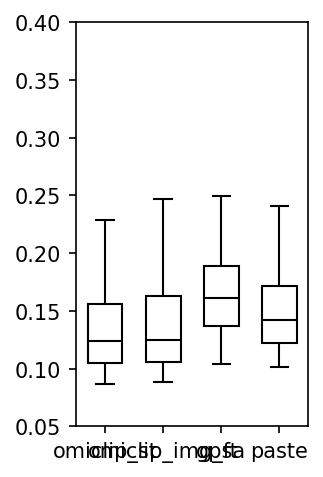

In [1726]:
plt.figure(figsize=(2,3.5), dpi=150)
sns.boxplot(all_rmse, showfliers=False, width=0.6, linecolor = 'black', linewidth=1, color='white')
plt.ylim((0.05,0.4))

In [1727]:
ranksums(all_rmse['paste'], all_rmse['omiclip_img_ft'], alternative='greater')

RanksumsResult(statistic=4.761201515205518, pvalue=9.622188361844785e-07)

In [1728]:
ranksums(all_rmse['gpsa'], all_rmse['omiclip_img_ft'], alternative='greater')

RanksumsResult(statistic=8.106910688052638, pvalue=2.5961498719678936e-16)

In [1729]:
ranksums(all_rmse['omiclip_img_ft'], all_rmse['omiclip_st'], alternative='greater')

RanksumsResult(statistic=0.5528959524641501, pvalue=0.2901673295840642)

(0.0, 1.0)

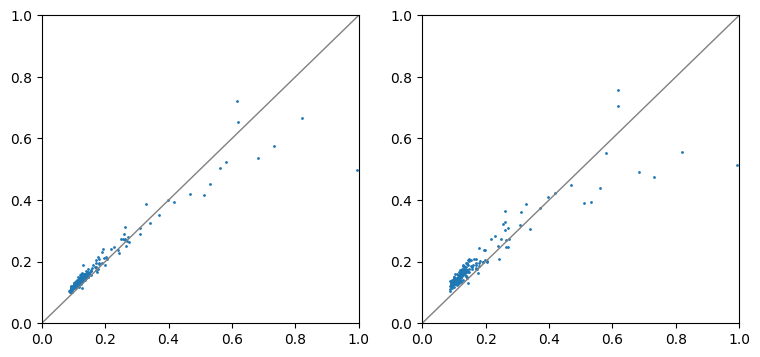

In [1730]:
plt.figure(figsize=(9,4))
plt.subplot(1, 2, 1)
plt.scatter(all_rmse['omiclip_st'], all_rmse['paste'], s=1)
plt.plot([0,2],[0,2], linewidth=1, c='grey')
plt.xlim((0,1))
plt.ylim((0,1))

plt.subplot(1, 2, 2)
plt.scatter(all_rmse['omiclip_st'], all_rmse['gpsa'], s=1)
plt.plot([0,2],[0,2], linewidth=1, c='grey')
plt.xlim((0,1))
plt.ylim((0,1))

In [1731]:
omiclip_st_stat = calculate_mse(shared_genes, omiclip_ad_tar_mean_expr, omiclip_ad_src_align_mean_expr, omiclip_matches_st)
omiclip_img_ft_stat = calculate_mse(shared_genes, omiclip_ad_tar_mean_expr, omiclip_ad_src_align_mean_expr, omiclip_matches_img_ft)
paste_stat = calculate_mse(shared_genes, paste_ad_tar_mean_expr, paste_ad_src_align_mean_expr, paste_matches)
gpsa_stat = calculate_mse(shared_genes, gpsa_ad_tar_mean_expr, gpsa_ad_src_align_mean_expr, gpsa_matches)

100%|██████████| 213/213 [00:00<00:00, 827.54it/s]


In [1732]:
all_mse = pd.concat([omiclip_st_stat['mse'], 
                     omiclip_img_ft_stat['mse'], 
                     gpsa_stat['mse'], 
                     paste_stat['mse'], 
                    ],axis=1)
all_mse.columns = ['omiclip_st','omiclip_img_ft','gpsa','paste']
all_mse

,omiclip_st,omiclip_img_ft,gpsa,paste
MT-ND4,0.381147,0.388421,0.575283,0.521772
MT-CO3,0.381726,0.391134,0.497087,0.427656
MYL9,0.987659,0.967416,0.265536,0.246509
CTSD,0.536915,0.574739,0.226847,0.331062
SERPINA1,0.672405,0.775115,0.310593,0.443378
...,...,...,...,...
AC037459.4,0.012246,0.013101,0.015190,0.015564
DDT,0.008403,0.009610,0.018195,0.013838
TMEM159,0.010457,0.010674,0.020075,0.014344
DNAJC4,0.009052,0.009304,0.015977,0.014650


In [1733]:
all_mse.to_csv(case_dir+src_sample_name+'_all_mse.csv')

<Axes: >

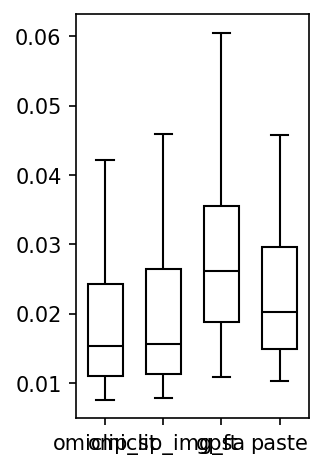

In [1734]:
plt.figure(figsize=(2,3.5), dpi=150)
sns.boxplot(all_mse, showfliers=False, width=0.6, linecolor = 'black', linewidth=1, color='white')
# plt.ylim((0.05,0.4))

In [1735]:
ranksums(all_mse['paste'], all_mse['omiclip_img_ft'], alternative='greater')

RanksumsResult(statistic=4.761201515205518, pvalue=9.622188361844785e-07)

In [1736]:
ranksums(all_mse['gpsa'], all_mse['omiclip_img_ft'], alternative='greater')

RanksumsResult(statistic=8.106910688052638, pvalue=2.5961498719678936e-16)

In [1737]:
ranksums(all_mse['omiclip_img_ft'], all_mse['omiclip_st'], alternative='greater')

RanksumsResult(statistic=0.5528959524641501, pvalue=0.2901673295840642)

(0.0, 1.0)

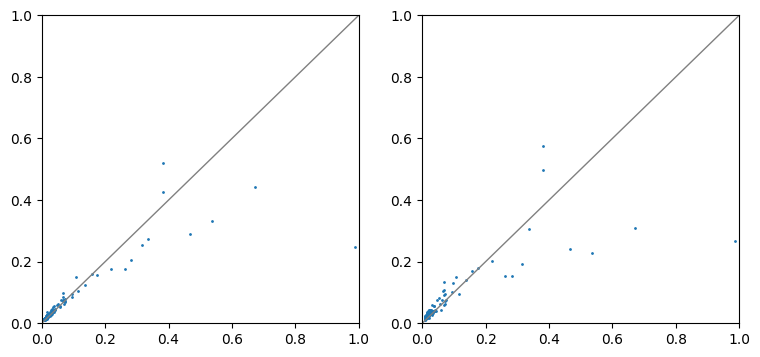

In [1738]:
plt.figure(figsize=(9,4))
plt.subplot(1, 2, 1)
plt.scatter(all_mse['omiclip_st'], all_mse['paste'], s=1)
plt.plot([0,2],[0,2], linewidth=1, c='grey')
plt.xlim((0,1))
plt.ylim((0,1))

plt.subplot(1, 2, 2)
plt.scatter(all_mse['omiclip_st'], all_mse['gpsa'], s=1)
plt.plot([0,2],[0,2], linewidth=1, c='grey')
plt.xlim((0,1))
plt.ylim((0,1))

In [695]:
omiclip_mse_st = pd.DataFrame()
omiclip_mse_st = calculate_mse(omiclip_mse_st, shared_genes, omiclip_ad_tar_mean_expr, omiclip_ad_src_align_mean_expr, omiclip_matches_st)
omiclip_mse_img_ft = pd.DataFrame()
omiclip_mse_img_ft = calculate_mse(omiclip_mse_img_ft, shared_genes, omiclip_ad_tar_mean_expr, omiclip_ad_src_align_mean_expr, omiclip_matches_img_ft)
paste_mse = pd.DataFrame()
paste_mse = calculate_mse(paste_mse, shared_genes, paste_ad_tar_mean_expr, paste_ad_src_align_mean_expr, paste_matches)
gpsa_mse = pd.DataFrame()
gpsa_mse = calculate_mse(gpsa_mse, shared_genes, gpsa_ad_tar_mean_expr, gpsa_ad_src_align_mean_expr, gpsa_matches)

100%|██████████| 119/119 [00:00<00:00, 814.51it/s]


In [696]:
all_mse = pd.concat([omiclip_mse_st['mse'], 
                     omiclip_mse_img_ft['mse'], 
                     gpsa_mse['mse'], 
                     paste_mse['mse'], 
                    ],axis=1)
all_mse.columns = ['omiclip_st','omiclip_img_ft','gpsa','paste']

(0.0, 0.2)

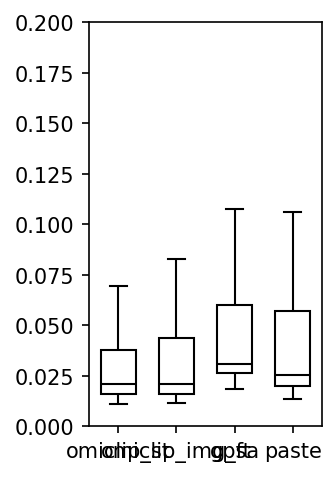

In [697]:
plt.figure(figsize=(2,3.5), dpi=150)
sns.boxplot(all_mse, showfliers=False, width=0.6, linecolor = 'black', linewidth=1, color='white')
plt.ylim((0,0.2))

In [698]:
ranksums(paste_mse['mse'], omiclip_mse_img_ft['mse'], alternative='greater')

RanksumsResult(statistic=3.2509575140151745, pvalue=0.0005750852205861974)

In [699]:
ranksums(gpsa_mse['mse'], omiclip_mse_img_ft['mse'], alternative='greater')

RanksumsResult(statistic=5.751549218974429, pvalue=4.42146638791038e-09)

In [700]:
ranksums(omiclip_mse_img_ft['mse'], omiclip_mse_st['mse'], alternative='greater')

RanksumsResult(statistic=0.16287739644501165, pvalue=0.43530748408830067)

# V10F24-048_A1

### Preprocess

In [701]:
sample_name = 'V10F24-048_A1'

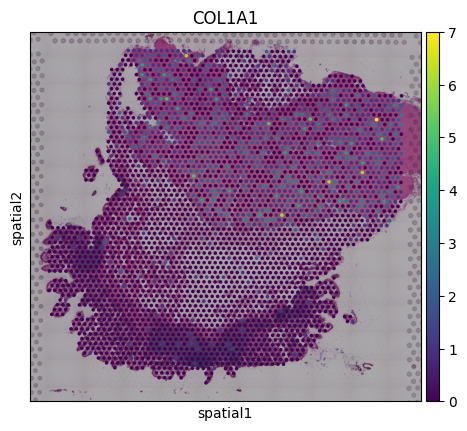

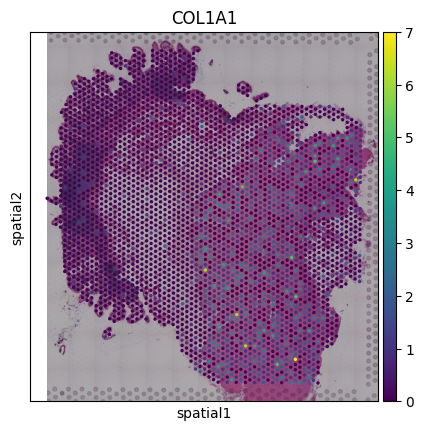

In [702]:
rotate_adata_90(sample_name)

In [1739]:
src_sample_name = 'V10F24-048_A1'+'_rotate90'
ad_src, ad_src_coor, src_img =  prepare_data(src_sample_name)

## Omiclip ST to ST

In [1740]:
case_name = '_coca_after_training20'

In [1741]:
feature_type = '_coca_txt_features'
tar_features = get_features(tar_sample_name, feature_type, case_name)
src_features = get_features(src_sample_name, feature_type, case_name)

In [1742]:
pca_comb_features, pca_comb_features_batch = get_pca_by_fit(tar_features, src_features)

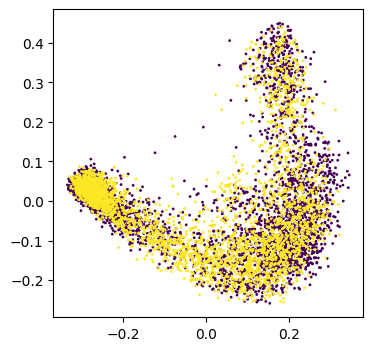

In [1743]:
plt.figure(figsize=(4,4))
plt.scatter(pca_comb_features[:,0], pca_comb_features[:,1],c=pca_comb_features_batch, s=1)

In [1744]:
pca_rgb_comb = (pca_comb_features-pca_comb_features.min(axis=0))/(pca_comb_features.max(axis=0)-pca_comb_features.min(axis=0))
pca_hex_comb = [ rgb2hex(pca_rgb_comb[i,:]) for i in range(pca_rgb_comb.shape[0]) ]

In [709]:
alpha = 0.5
cpd_coor, homo_coor, aligned_image = cpd_align(ad_tar_coor, ad_src_coor, pca_comb_features, src_img, alpha)

In [710]:
# plot_alignment_with_img(ad_tar_coor, ad_src_coor, homo_coor, tar_img, src_img, aligned_image, pca_hex_comb, tar_features)

In [711]:
shift=300
s=0.8
# plot_alignment(ad_tar_coor, ad_src_coor, homo_coor, pca_hex_comb, tar_features, shift=300, s=0.8)

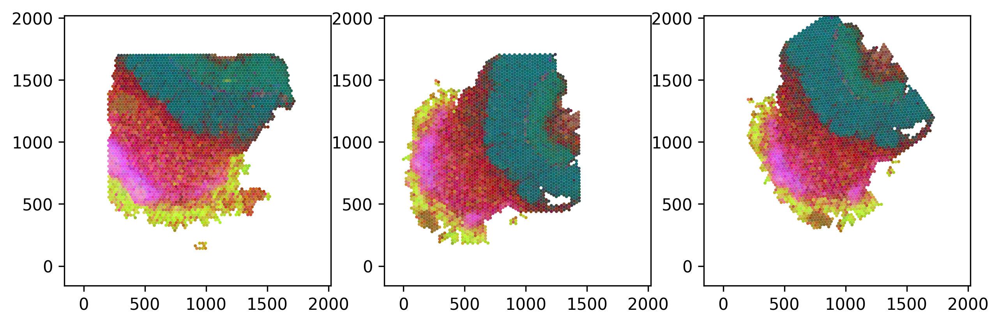

In [712]:
plot_alignment(ad_tar_coor, ad_src_coor, homo_coor, pca_hex_comb, tar_features, shift=300, s=0.8, boundary_line=False)

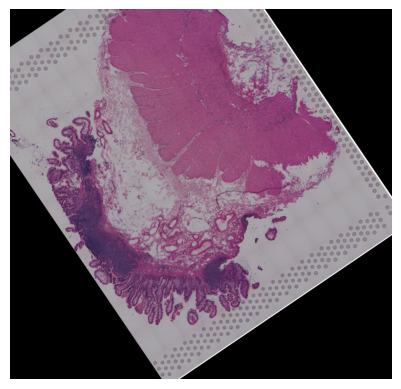

In [713]:
plt.imshow(aligned_image, origin='lower')
plt.axis('off')
plt.show()

In [714]:
save_name = 'omiclip_st_st_'+src_sample_name+'.h5ad'
wirte_aligned_data(ad_src, aligned_image, homo_coor, save_name)

## Omiclip Img to ST

In [715]:
generate_features_finetune10(src_sample_name)

100%|██████████| 3238/3238 [04:37<00:00, 11.66it/s]


In [716]:
case_name = '_finetune10'

In [717]:
tar_features = get_features(tar_sample_name, '_text_feature', case_name)
src_features = get_features(src_sample_name, '_image_feature', case_name)

In [718]:
pca_comb_features, pca_comb_features_batch = get_pca_by_fit(tar_features, src_features)

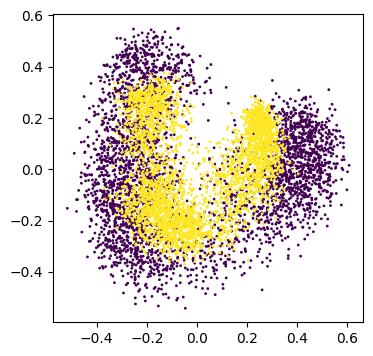

In [719]:
plt.figure(figsize=(4,4))
plt.scatter(pca_comb_features[:,0], pca_comb_features[:,1],c=pca_comb_features_batch, s=1)

In [720]:
alpha = 0.5
cpd_coor, homo_coor, aligned_image = cpd_align(ad_tar_coor, ad_src_coor, pca_comb_features, src_img, alpha)

In [721]:
# plot_alignment_with_img(ad_tar_coor, ad_src_coor, homo_coor, tar_img, src_img, aligned_image, pca_hex_comb, tar_features)

In [722]:
shift=300
s=0.8
# plot_alignment(ad_tar_coor, ad_src_coor, homo_coor, pca_hex_comb, tar_features, shift=300, s=0.8)

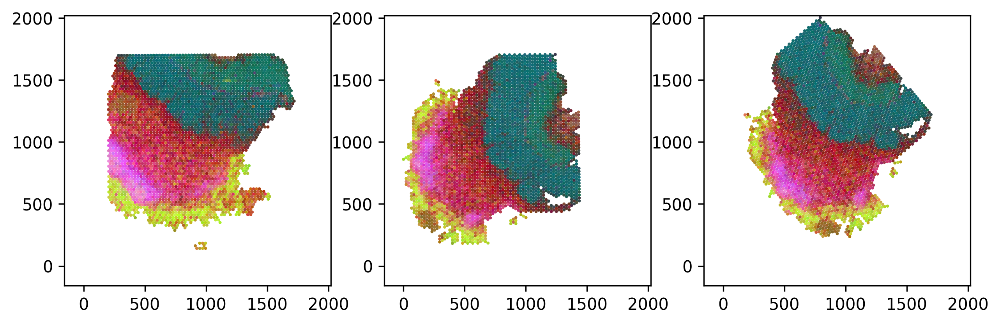

In [723]:
plot_alignment(ad_tar_coor, ad_src_coor, homo_coor, pca_hex_comb, tar_features, shift=300, s=0.8, boundary_line=False)

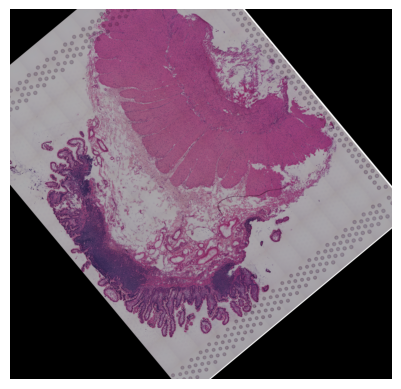

In [724]:
plt.imshow(aligned_image, origin='lower')
plt.axis('off')
plt.show()

In [725]:
save_name = 'omiclip_st_img_finetune10_'+src_sample_name+'.h5ad'
wirte_aligned_data(ad_src, aligned_image, homo_coor, save_name)

## Omiclip Results

In [1746]:
omiclip_ad_tar = ad_tar.copy()
omiclip_ad_src_align_st = sc.read_h5ad(case_dir_omiclip+'omiclip_st_st_'+src_sample_name+'.h5ad')
omiclip_ad_src_align_img_ft = sc.read_h5ad(case_dir_omiclip+'omiclip_st_img_finetune10_'+src_sample_name+'.h5ad')

In [1747]:
omiclip_ad_tar = filter_norm_log1p(omiclip_ad_tar)
omiclip_ad_src_align_st = filter_norm_log1p(omiclip_ad_src_align_st)
omiclip_ad_src_align_img_ft = filter_norm_log1p(omiclip_ad_src_align_img_ft)

In [1748]:
omiclip_ad_tar_heg_of_hvg = get_heg_of_hvg(omiclip_ad_tar)
omiclip_ad_src_heg_of_hvg = get_heg_of_hvg(omiclip_ad_src_align_st)
omiclip_genes = [value for value in omiclip_ad_tar_heg_of_hvg.index.tolist() if value in omiclip_ad_src_heg_of_hvg.index.tolist()]
len(omiclip_genes)

255

In [1749]:
omiclip_ad_tar_mean_expr = get_mean_expr_by_neighbor(omiclip_ad_tar)
omiclip_ad_src_mean_expr = get_mean_expr_by_neighbor(omiclip_ad_src_align_st)

100%|██████████| 3238/3238 [00:13<00:00, 242.69it/s]


In [1750]:
scalef_tar = get_scalefactors(omiclip_ad_tar)['tissue_hires_scalef']
scalef_src = get_scalefactors(omiclip_ad_src)['tissue_hires_scalef']
omiclip_matches_st = nearest_neighbour(omiclip_ad_src_align_st.obsm['spatial']*scalef_src, omiclip_ad_tar.obsm['spatial']*scalef_tar)
omiclip_matches_img_ft = nearest_neighbour(omiclip_ad_src_align_img_ft.obsm['spatial']*scalef_src, omiclip_ad_tar.obsm['spatial']*scalef_tar)

Processing coordinates: 100%|██████████| 3238/3238 [00:44<00:00, 72.56it/s]


## Paste

Using selected backend cpu. If you want to use gpu, set use_gpu = True.


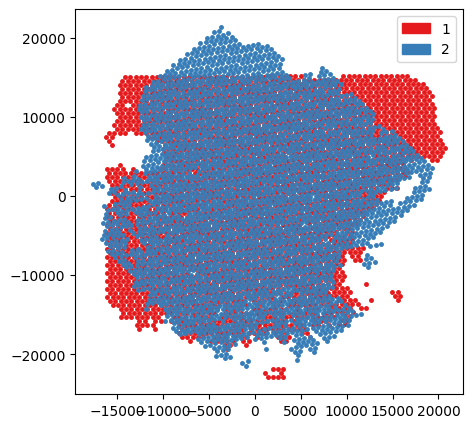

In [732]:
paste_align(src_sample_name)

In [1751]:
paste_tar_ad = sc.read_h5ad(paste_path+'paste_aligment_target_'+src_sample_name+'.h5ad')
paste_align_ad = sc.read_h5ad(paste_path+'paste_aligment_source_'+src_sample_name+'.h5ad')
sc.pp.normalize_total(paste_tar_ad)
sc.pp.normalize_total(paste_align_ad)
sc.pp.log1p(paste_tar_ad)
sc.pp.log1p(paste_align_ad)

In [1752]:
ad_src = sc.read_h5ad(os.path.join(data_dir, src_sample_name+'.h5ad'))
paste_shared_index = find_matching_indices(ad_src.obs.index.to_list(), paste_align_ad.obs.index.to_list())
paste_tar_coor = (paste_tar_ad.obsm['spatial']-paste_tar_ad.obsm['spatial'].min())/(paste_tar_ad.obsm['spatial'].max()-paste_tar_ad.obsm['spatial'].min())*(ad_tar_coor.max()-ad_tar_coor.min())
paste_align_coor = (paste_align_ad.obsm['spatial']-paste_tar_ad.obsm['spatial'].min())/(paste_tar_ad.obsm['spatial'].max()-paste_tar_ad.obsm['spatial'].min())*(ad_tar_coor.max()-ad_tar_coor.min())

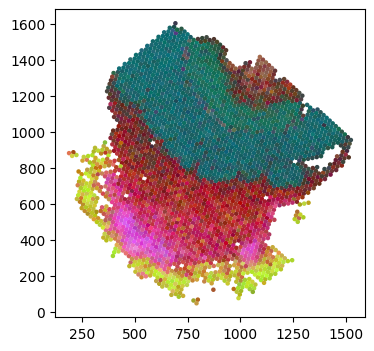

In [1753]:
plt.figure(figsize=(4,4))
plt.scatter(paste_align_coor[:,0], paste_align_coor[:,1], s=5, c=[pca_hex_comb[len(tar_features.T):][i] for i in paste_shared_index[:,0]])

In [1754]:
paste_ad_tar_mean_expr = get_mean_expr_by_neighbor(paste_tar_ad)
paste_ad_src_align_mean_expr = get_mean_expr_by_neighbor(paste_align_ad)

100%|██████████| 3148/3148 [00:09<00:00, 324.12it/s]


In [1755]:
paste_matches = nearest_neighbour(paste_align_coor, paste_tar_coor)

Processing coordinates: 100%|██████████| 3148/3148 [00:41<00:00, 75.88it/s]


## GPSA

In [1756]:
gpsa_tar_ad = sc.read_h5ad(case_dir+'gpsa/gpsa_target_'+src_sample_name+'.h5ad')
gpsa_align_ad = sc.read_h5ad(case_dir+'gpsa/gpsa_alignment_'+src_sample_name+'.h5ad')

gpsa_align = pd.read_csv(case_dir+'gpsa/gpsa_align_coor_'+src_sample_name+'.csv', index_col=0)
gpsa_align = np.array(gpsa_align)
gpsa_tar = pd.read_csv(case_dir+'gpsa/gpsa_tar_coor_'+src_sample_name+'.csv', index_col=0)
gpsa_tar = np.array(gpsa_tar)

ad_src = sc.read_h5ad(os.path.join(data_dir, src_sample_name+'.h5ad'))
gpsa_shared_index = find_matching_indices(ad_src.obs.index.to_list(), gpsa_align_ad.obs.index.to_list())

gpsa_align_resize = (gpsa_align/10)*(ad_tar_coor.max(axis=0)-ad_tar_coor.min(axis=0))+ad_tar_coor.min(axis=0)
gpsa_tar_resize = (gpsa_tar/10)*(ad_tar_coor.max(axis=0)-ad_tar_coor.min(axis=0))+ad_tar_coor.min(axis=0)
gpsa_align_ad.obs[['newy', 'newx']] = gpsa_align_resize
gpsa_tar_ad.obs[['newy', 'newx']] = gpsa_tar_resize

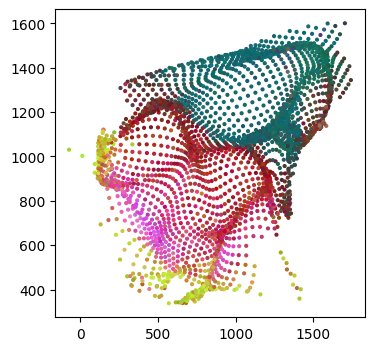

In [1757]:
plt.figure(figsize=(4, 4))
plt.scatter(gpsa_align_resize[:,0], gpsa_align_resize[:,1], c = [pca_hex_comb[len(tar_features.T):][i] for i in gpsa_shared_index[:,0]],s=4)

In [1758]:
gpsa_ad_tar_mean_expr = get_mean_expr_by_dist(gpsa_tar_ad)
gpsa_ad_src_align_mean_expr = get_mean_expr_by_dist(gpsa_align_ad)

100%|██████████| 3150/3150 [00:05<00:00, 582.01it/s]


In [1759]:
shared_genes = [value for value in omiclip_genes if value in gpsa_ad_tar_mean_expr.columns.tolist()]
shared_genes = [value for value in shared_genes if value in gpsa_ad_src_align_mean_expr.columns.tolist()]
len(shared_genes)

220

In [1760]:
gpsa_matches = nearest_neighbour(gpsa_align_resize, gpsa_tar_resize)
gpsa_matches.shape

Processing coordinates: 100%|██████████| 3150/3150 [00:47<00:00, 66.21it/s]


(2881, 2)

## Combine Analysis

In [1761]:
omiclip_st_stat = calculate_rmse(shared_genes, omiclip_ad_tar_mean_expr, omiclip_ad_src_align_mean_expr, omiclip_matches_st)
omiclip_img_ft_stat = calculate_rmse(shared_genes, omiclip_ad_tar_mean_expr, omiclip_ad_src_align_mean_expr, omiclip_matches_img_ft)
paste_stat = calculate_rmse(shared_genes, paste_ad_tar_mean_expr, paste_ad_src_align_mean_expr, paste_matches)
gpsa_stat = calculate_rmse(shared_genes, gpsa_ad_tar_mean_expr, gpsa_ad_src_align_mean_expr, gpsa_matches)

100%|██████████| 220/220 [00:00<00:00, 786.52it/s]


In [1762]:
all_rmse = pd.concat([omiclip_st_stat['rmse'], 
                     omiclip_img_ft_stat['rmse'], 
                     gpsa_stat['rmse'], 
                     paste_stat['rmse'], 
                    ],axis=1)
all_rmse.columns = ['omiclip_st','omiclip_img_ft','gpsa','paste']
all_rmse

,omiclip_st,omiclip_img_ft,gpsa,paste
MT-ND4,0.603489,0.607319,0.521090,0.470496
MT-CO3,0.610725,0.612757,0.499003,0.467411
MYL9,0.986703,0.985553,0.524265,0.488879
CTSD,0.713926,0.745655,0.510953,0.540990
NACA,0.409175,0.415144,0.410567,0.354307
...,...,...,...,...
DNM2,0.111442,0.112885,0.129211,0.121736
DDT,0.093934,0.099542,0.148792,0.119413
FAM3C,0.092504,0.093074,0.130584,0.113385
TMEM159,0.102704,0.105202,0.136435,0.125644


In [1763]:
all_rmse.to_csv(case_dir+src_sample_name+'_all_rmse.csv')

(0.05, 0.4)

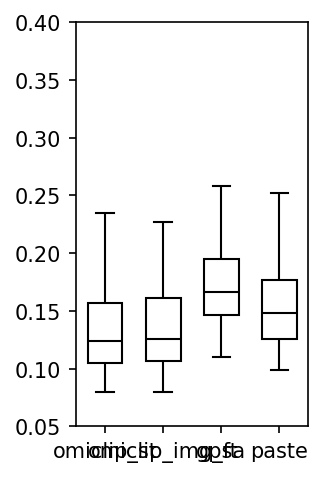

In [1764]:
plt.figure(figsize=(2,3.5), dpi=150)
sns.boxplot(all_rmse, showfliers=False, width=0.6, linecolor = 'black', linewidth=1, color='white')
plt.ylim((0.05,0.4))

In [1765]:
ranksums(all_rmse['paste'], all_rmse['omiclip_img_ft'], alternative='greater')

RanksumsResult(statistic=5.550060639664428, pvalue=1.4278526351501519e-08)

In [1766]:
ranksums(all_rmse['gpsa'], all_rmse['omiclip_img_ft'], alternative='greater')

RanksumsResult(statistic=9.10188950349723, pvalue=4.4386863534637064e-20)

In [1767]:
ranksums(all_rmse['omiclip_img_ft'], all_rmse['omiclip_st'], alternative='greater')

RanksumsResult(statistic=0.6275872406645673, pvalue=0.26513718467522773)

(0.0, 1.0)

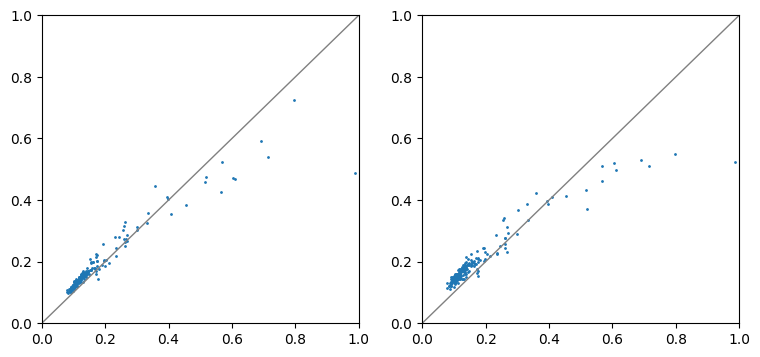

In [1768]:
plt.figure(figsize=(9,4))
plt.subplot(1, 2, 1)
plt.scatter(all_rmse['omiclip_st'], all_rmse['paste'], s=1)
plt.plot([0,2],[0,2], linewidth=1, c='grey')
plt.xlim((0,1))
plt.ylim((0,1))

plt.subplot(1, 2, 2)
plt.scatter(all_rmse['omiclip_st'], all_rmse['gpsa'], s=1)
plt.plot([0,2],[0,2], linewidth=1, c='grey')
plt.xlim((0,1))
plt.ylim((0,1))

In [1769]:
omiclip_st_stat = calculate_mse(shared_genes, omiclip_ad_tar_mean_expr, omiclip_ad_src_align_mean_expr, omiclip_matches_st)
omiclip_img_ft_stat = calculate_mse(shared_genes, omiclip_ad_tar_mean_expr, omiclip_ad_src_align_mean_expr, omiclip_matches_img_ft)
paste_stat = calculate_mse(shared_genes, paste_ad_tar_mean_expr, paste_ad_src_align_mean_expr, paste_matches)
gpsa_stat = calculate_mse(shared_genes, gpsa_ad_tar_mean_expr, gpsa_ad_src_align_mean_expr, gpsa_matches)

100%|██████████| 220/220 [00:00<00:00, 829.33it/s]


In [1770]:
all_mse = pd.concat([omiclip_st_stat['mse'], 
                     omiclip_img_ft_stat['mse'], 
                     gpsa_stat['mse'], 
                     paste_stat['mse'], 
                    ],axis=1)
all_mse.columns = ['omiclip_st','omiclip_img_ft','gpsa','paste']
all_mse

,omiclip_st,omiclip_img_ft,gpsa,paste
MT-ND4,0.364200,0.368837,0.271534,0.221367
MT-CO3,0.372985,0.375472,0.249004,0.218473
MYL9,0.973582,0.971316,0.274854,0.239003
CTSD,0.509691,0.556001,0.261073,0.292670
NACA,0.167424,0.172345,0.168565,0.125534
...,...,...,...,...
DNM2,0.012419,0.012743,0.016696,0.014820
DDT,0.008824,0.009909,0.022139,0.014260
FAM3C,0.008557,0.008663,0.017052,0.012856
TMEM159,0.010548,0.011068,0.018615,0.015786


In [1771]:
all_mse.to_csv(case_dir+src_sample_name+'_all_mse.csv')

<Axes: >

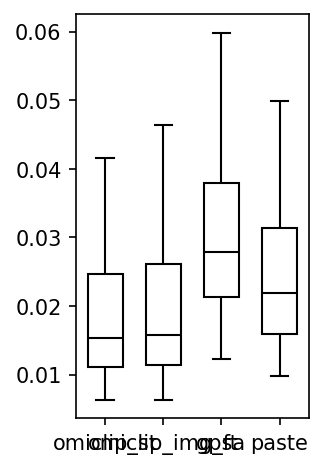

In [1772]:
plt.figure(figsize=(2,3.5), dpi=150)
sns.boxplot(all_mse, showfliers=False, width=0.6, linecolor = 'black', linewidth=1, color='white')
# plt.ylim((0.05,0.4))

In [1773]:
ranksums(all_mse['paste'], all_mse['omiclip_img_ft'], alternative='greater')

RanksumsResult(statistic=5.550060639664428, pvalue=1.4278526351501519e-08)

In [1774]:
ranksums(all_mse['gpsa'], all_mse['omiclip_img_ft'], alternative='greater')

RanksumsResult(statistic=9.10188950349723, pvalue=4.4386863534637064e-20)

In [1775]:
ranksums(all_mse['omiclip_img_ft'], all_mse['omiclip_st'], alternative='greater')

RanksumsResult(statistic=0.6275872406645673, pvalue=0.26513718467522773)

(0.0, 1.0)

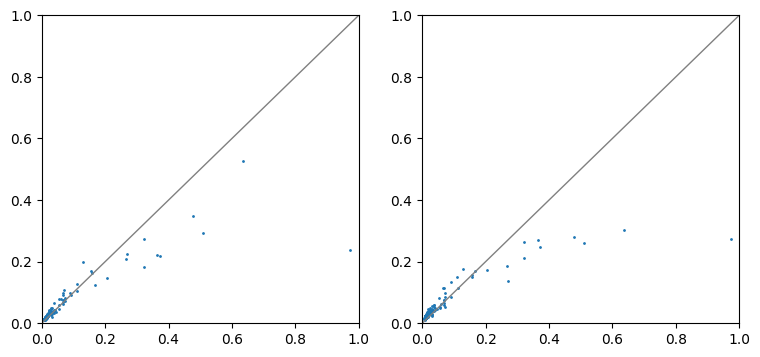

In [1776]:
plt.figure(figsize=(9,4))
plt.subplot(1, 2, 1)
plt.scatter(all_mse['omiclip_st'], all_mse['paste'], s=1)
plt.plot([0,2],[0,2], linewidth=1, c='grey')
plt.xlim((0,1))
plt.ylim((0,1))

plt.subplot(1, 2, 2)
plt.scatter(all_mse['omiclip_st'], all_mse['gpsa'], s=1)
plt.plot([0,2],[0,2], linewidth=1, c='grey')
plt.xlim((0,1))
plt.ylim((0,1))

# V19T26-028_B1

In [345]:
src_sample_name = 'V19T26-028_B1'
ad_src, ad_src_coor, src_img =  prepare_data(src_sample_name)

## Omiclip ST to ST

In [346]:
case_name = '_coca_after_training20'

In [347]:
feature_type = '_coca_txt_features'
tar_features = get_features(tar_sample_name, feature_type, case_name)
src_features = get_features(src_sample_name, feature_type, case_name)

In [348]:
pca_comb_features, pca_comb_features_batch = get_pca_by_fit(tar_features, src_features)

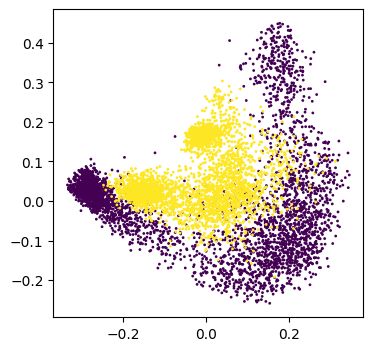

In [349]:
plt.figure(figsize=(4,4))
plt.scatter(pca_comb_features[:,0], pca_comb_features[:,1],c=pca_comb_features_batch, s=1)

In [350]:
pca_rgb_comb = (pca_comb_features-pca_comb_features.min(axis=0))/(pca_comb_features.max(axis=0)-pca_comb_features.min(axis=0))
pca_hex_comb = [ rgb2hex(pca_rgb_comb[i,:]) for i in range(pca_rgb_comb.shape[0]) ]

In [351]:
alpha = 0.5
cpd_coor, homo_coor, aligned_image = cpd_align(ad_tar_coor, ad_src_coor, pca_comb_features, src_img, alpha)

In [352]:
# plot_alignment_with_img(ad_tar_coor, ad_src_coor, homo_coor, tar_img, src_img, aligned_image, pca_hex_comb, tar_features)

In [353]:
shift=300
s=0.8
# plot_alignment(ad_tar_coor, ad_src_coor, homo_coor, pca_hex_comb, tar_features, shift=300, s=0.8)

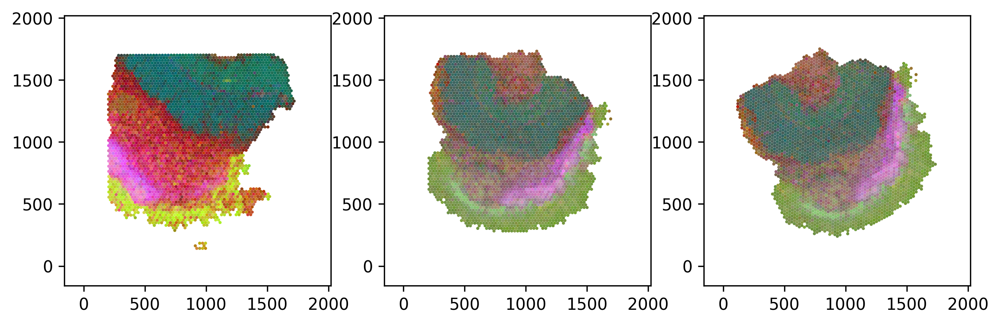

In [354]:
plot_alignment(ad_tar_coor, ad_src_coor, homo_coor, pca_hex_comb, tar_features, shift=300, s=0.8, boundary_line=False)

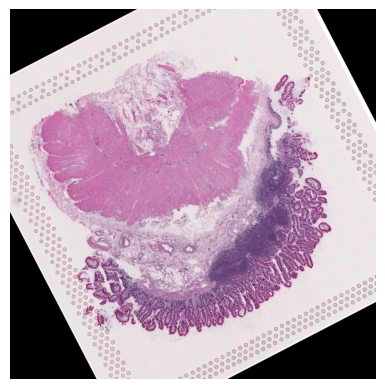

In [355]:
plt.imshow(aligned_image, origin='lower')
plt.axis('off')
plt.show()

In [356]:
save_name = 'omiclip_st_st_'+src_sample_name+'.h5ad'
wirte_aligned_data(ad_src, aligned_image, homo_coor, save_name)

## Omiclip Img to ST

In [357]:
generate_features_finetune10(src_sample_name)

100%|██████████| 3320/3320 [01:49<00:00, 30.25it/s]


In [358]:
case_name = '_finetune10'

In [359]:
tar_features = get_features(tar_sample_name, '_text_feature', case_name)
src_features = get_features(src_sample_name, '_image_feature', case_name)

In [360]:
pca_comb_features, pca_comb_features_batch = get_pca_by_fit(tar_features, src_features)

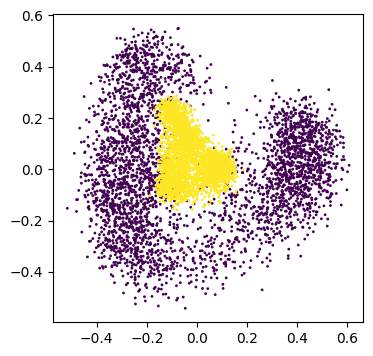

In [361]:
plt.figure(figsize=(4,4))
plt.scatter(pca_comb_features[:,0], pca_comb_features[:,1],c=pca_comb_features_batch, s=1)

In [362]:
alpha = 0.5
cpd_coor, homo_coor, aligned_image = cpd_align(ad_tar_coor, ad_src_coor, pca_comb_features, src_img, alpha)

In [363]:
# plot_alignment_with_img(ad_tar_coor, ad_src_coor, homo_coor, tar_img, src_img, aligned_image, pca_hex_comb, tar_features)

In [364]:
shift=300
s=0.8
# plot_alignment(ad_tar_coor, ad_src_coor, homo_coor, pca_hex_comb, tar_features, shift=300, s=0.8)

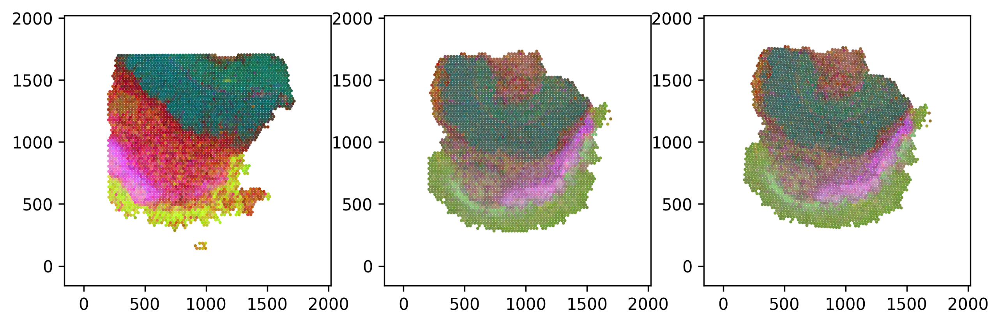

In [365]:
plot_alignment(ad_tar_coor, ad_src_coor, homo_coor, pca_hex_comb, tar_features, shift=300, s=0.8, boundary_line=False)

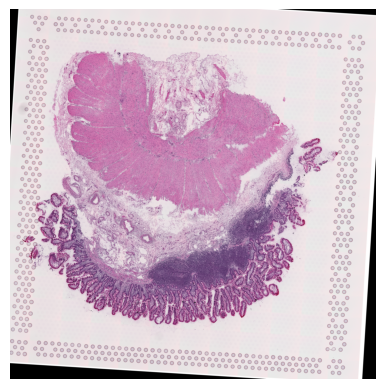

In [366]:
plt.imshow(aligned_image, origin='lower')
plt.axis('off')
plt.show()

In [367]:
save_name = 'omiclip_st_img_finetune10_'+src_sample_name+'.h5ad'
wirte_aligned_data(ad_src, aligned_image, homo_coor, save_name)

## Omiclip Results

In [88]:
omiclip_ad_tar = ad_tar.copy()
sc.pp.normalize_total(omiclip_ad_tar)
sc.pp.log1p(omiclip_ad_tar)
omiclip_ad_tar_heg_of_hvg = get_heg_of_hvg(omiclip_ad_tar, 300)

In [89]:
omiclip_ad_src_align_st = sc.read_h5ad(case_dir_omiclip+'omiclip_st_st_'+src_sample_name+'.h5ad')
omiclip_ad_src_align_img_ft = sc.read_h5ad(case_dir_omiclip+'omiclip_st_img_finetune10_'+src_sample_name+'.h5ad')
sc.pp.normalize_total(omiclip_ad_src_align_st)
sc.pp.log1p(omiclip_ad_src_align_st)
omiclip_ad_src_heg_of_hvg = get_heg_of_hvg(omiclip_ad_src_align_st, 300)

In [90]:
omiclip_genes = [value for value in omiclip_ad_tar_heg_of_hvg.index.tolist() if value in omiclip_ad_src_heg_of_hvg.index.tolist()]
len(omiclip_genes)

126

In [91]:
omiclip_ad_tar_mean_expr = get_mean_expr_by_neighbor(omiclip_ad_tar)
omiclip_ad_tar_mean_expr.reset_index(inplace=True, drop=True)
omiclip_ad_src_align_mean_expr = get_mean_expr_by_neighbor(omiclip_ad_src_align_st)
omiclip_ad_src_align_mean_expr.reset_index(inplace=True, drop=True)

100%|██████████| 3333/3333 [00:12<00:00, 263.72it/s]


In [92]:
scalef_tar = get_scalefactors(omiclip_ad_tar)['tissue_hires_scalef']
scalef_src = get_scalefactors(omiclip_ad_src_align_st)['tissue_hires_scalef']
omiclip_matches_st = nearest_neighbour(omiclip_ad_src_align_st.obsm['spatial']*scalef_src, omiclip_ad_tar.obsm['spatial']*scalef_tar)
omiclip_matches_img_ft = nearest_neighbour(omiclip_ad_src_align_img_ft.obsm['spatial']*scalef_src, omiclip_ad_tar.obsm['spatial']*scalef_tar)

Processing coordinates: 100%|██████████| 3333/3333 [00:46<00:00, 72.34it/s]


## Paste

In [98]:
paste_path = case_dir+'paste/'

Using selected backend cpu. If you want to use gpu, set use_gpu = True.


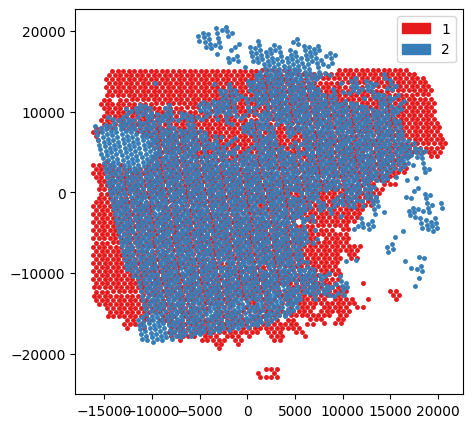

In [99]:
paste_align(src_sample_name)

In [107]:
paste_tar_ad = sc.read_h5ad(paste_path+'paste_aligment_target_'+src_sample_name+'.h5ad')
paste_align_ad = sc.read_h5ad(paste_path+'paste_aligment_source_'+src_sample_name+'.h5ad')
sc.pp.normalize_total(paste_tar_ad)
sc.pp.normalize_total(paste_align_ad)
sc.pp.log1p(paste_tar_ad)
sc.pp.log1p(paste_align_ad)

In [108]:
ad_src = sc.read_h5ad(os.path.join(data_dir, src_sample_name+'.h5ad'))
paste_shared_index = find_matching_indices(ad_src.obs.index.to_list(), paste_align_ad.obs.index.to_list())
paste_tar_coor = (paste_tar_ad.obsm['spatial']-paste_tar_ad.obsm['spatial'].min())/(paste_tar_ad.obsm['spatial'].max()-paste_tar_ad.obsm['spatial'].min())*(ad_tar_coor.max()-ad_tar_coor.min())
paste_align_coor = (paste_align_ad.obsm['spatial']-paste_tar_ad.obsm['spatial'].min())/(paste_tar_ad.obsm['spatial'].max()-paste_tar_ad.obsm['spatial'].min())*(ad_tar_coor.max()-ad_tar_coor.min())

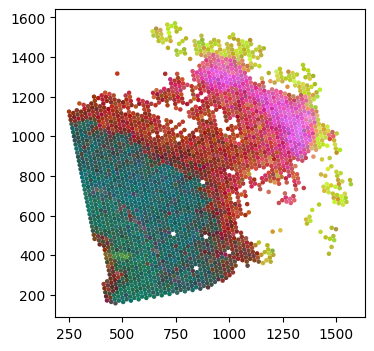

In [124]:
plt.figure(figsize=(4,4))
plt.scatter(paste_align_coor[:,0], paste_align_coor[:,1], s=5, c=[pca_hex_comb[len(tar_features.T):][i] for i in paste_shared_index[:,0]])

In [111]:
paste_ad_tar_mean_expr = get_mean_expr_by_neighbor(paste_tar_ad)
paste_ad_tar_mean_expr.reset_index(inplace=True,drop=True)
paste_ad_src_align_mean_expr = get_mean_expr_by_neighbor(paste_align_ad)
paste_ad_src_align_mean_expr.reset_index(inplace=True,drop=True)

100%|██████████| 2581/2581 [00:07<00:00, 326.47it/s]


In [112]:
paste_matches = nearest_neighbour(paste_align_coor, paste_tar_coor)

Processing coordinates: 100%|██████████| 2581/2581 [00:34<00:00, 75.81it/s]


(2334, 2)

## GPSA

In [127]:
gpsa_tar_ad = sc.read_h5ad(case_dir+'gpsa/gpsa_target_'+src_sample_name+'.h5ad')
gpsa_align_ad = sc.read_h5ad(case_dir+'gpsa/gpsa_alignment_'+src_sample_name+'.h5ad')

gpsa_align = pd.read_csv(case_dir+'gpsa/gpsa_align_coor_'+src_sample_name+'.csv', index_col=0)
gpsa_align = np.array(gpsa_align)
gpsa_tar = pd.read_csv(case_dir+'gpsa/gpsa_tar_coor_'+src_sample_name+'.csv', index_col=0)
gpsa_tar = np.array(gpsa_tar)

ad_src = sc.read_h5ad(os.path.join(data_dir, src_sample_name+'.h5ad'))
gpsa_shared_index = find_matching_indices(ad_src.obs.index.to_list(), gpsa_align_ad.obs.index.to_list())

gpsa_align_resize = (gpsa_align/10)*(ad_tar_coor.max(axis=0)-ad_tar_coor.min(axis=0))+ad_tar_coor.min(axis=0)
gpsa_tar_resize = (gpsa_tar/10)*(ad_tar_coor.max(axis=0)-ad_tar_coor.min(axis=0))+ad_tar_coor.min(axis=0)
gpsa_align_ad.obs[['newy', 'newx']] = gpsa_align_resize
gpsa_tar_ad.obs[['newy', 'newx']] = gpsa_tar_resize

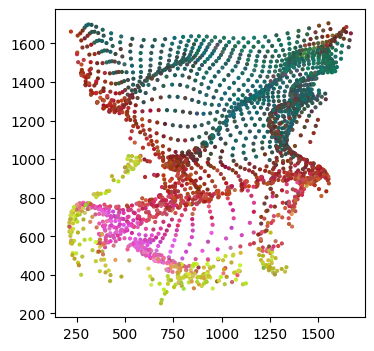

In [128]:
plt.figure(figsize=(4, 4))
plt.scatter(gpsa_align_resize[:,0], gpsa_align_resize[:,1], c = [pca_hex_comb[len(tar_features.T):][i] for i in gpsa_shared_index[:,0]],s=4)

In [ ]:
gpsa_ad_tar_mean_expr = get_mean_expr_by_dist(gpsa_tar_ad)
gpsa_ad_tar_mean_expr.reset_index(inplace=True, drop=True)
gpsa_ad_src_align_mean_expr = get_mean_expr_by_dist(gpsa_align_ad)
gpsa_ad_src_align_mean_expr.reset_index(inplace=True, drop=True)

In [133]:
shared_genes = [value for value in omiclip_genes if value in gpsa_ad_tar_mean_expr.columns.tolist()]
shared_genes = [value for value in shared_genes if value in gpsa_ad_src_align_mean_expr.columns.tolist()]
len(shared_genes)

96

In [129]:
gpsa_matches = nearest_neighbour(gpsa_align_resize, gpsa_tar_resize)
gpsa_matches.shape

Processing coordinates: 100%|██████████| 2607/2607 [00:39<00:00, 65.39it/s]


(2355, 2)

## Combine Analysis

In [134]:
omiclip_mse_st = pd.DataFrame()
omiclip_mse_st = calculate_mse(omiclip_mse_st, shared_genes, omiclip_ad_tar_mean_expr, omiclip_ad_src_align_mean_expr, omiclip_matches_st)
omiclip_mse_img_ft = pd.DataFrame()
omiclip_mse_img_ft = calculate_mse(omiclip_mse_img_ft, shared_genes, omiclip_ad_tar_mean_expr, omiclip_ad_src_align_mean_expr, omiclip_matches_img_ft)
paste_mse = pd.DataFrame()
paste_mse = calculate_mse(paste_mse, shared_genes, paste_ad_tar_mean_expr, paste_ad_src_align_mean_expr, paste_matches)
gpsa_mse = pd.DataFrame()
gpsa_mse = calculate_mse(gpsa_mse, shared_genes, gpsa_ad_tar_mean_expr, gpsa_ad_src_align_mean_expr, gpsa_matches)

100%|██████████| 96/96 [00:00<00:00, 618.55it/s]


In [144]:
all_mse = pd.concat([omiclip_mse_st['mse'], 
                     omiclip_mse_img_ft['mse'], 
                     gpsa_mse['mse'], 
                     paste_mse['mse'], 
                    ],axis=1)
all_mse.columns = ['omiclip_st','omiclip_img_ft','gpsa','paste']

(0.0, 0.2)

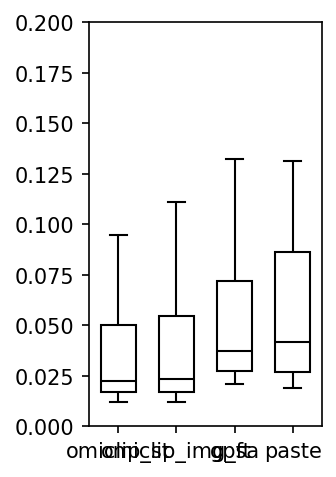

In [143]:
plt.figure(figsize=(2,3.5), dpi=150)
sns.boxplot(all_mse, showfliers=False, width=0.6, linecolor = 'black', linewidth=1, color='white')
plt.ylim((0,0.2))

In [139]:
ranksums(paste_mse['mse'], omiclip_mse_img_ft['mse'], alternative='greater')

RanksumsResult(statistic=4.703911971394518, pvalue=1.2761166249306994e-06)

In [140]:
ranksums(gpsa_mse['mse'], omiclip_mse_img_ft['mse'], alternative='greater')

RanksumsResult(statistic=4.514300942177622, pvalue=3.176297848652102e-06)

In [141]:
ranksums(omiclip_mse_img_ft['mse'], omiclip_mse_st['mse'], alternative='greater')

RanksumsResult(statistic=0.38701429251120006, pvalue=0.3493728134914188)

# V19T26-028_C1

In [368]:
src_sample_name = 'V19T26-028_C1'
ad_src, ad_src_coor, src_img =  prepare_data(src_sample_name)

## Omiclip ST to ST

In [369]:
case_name = '_coca_after_training20'

In [370]:
feature_type = '_coca_txt_features'
tar_features = get_features(tar_sample_name, feature_type, case_name)
src_features = get_features(src_sample_name, feature_type, case_name)

In [371]:
pca_comb_features, pca_comb_features_batch = get_pca_by_fit(tar_features, src_features)

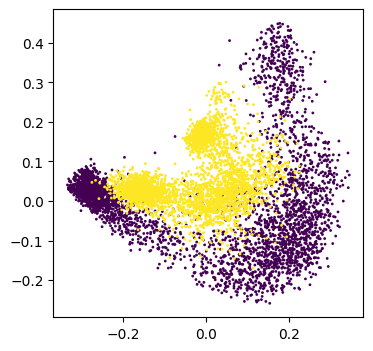

In [372]:
plt.figure(figsize=(4,4))
plt.scatter(pca_comb_features[:,0], pca_comb_features[:,1],c=pca_comb_features_batch, s=1)

In [373]:
pca_rgb_comb = (pca_comb_features-pca_comb_features.min(axis=0))/(pca_comb_features.max(axis=0)-pca_comb_features.min(axis=0))
pca_hex_comb = [ rgb2hex(pca_rgb_comb[i,:]) for i in range(pca_rgb_comb.shape[0]) ]

In [374]:
alpha = 0.5
cpd_coor, homo_coor, aligned_image = cpd_align(ad_tar_coor, ad_src_coor, pca_comb_features, src_img, alpha)

In [375]:
# plot_alignment_with_img(ad_tar_coor, ad_src_coor, homo_coor, tar_img, src_img, aligned_image, pca_hex_comb, tar_features)

In [376]:
shift=300
s=0.8
# plot_alignment(ad_tar_coor, ad_src_coor, homo_coor, pca_hex_comb, tar_features, shift=300, s=0.8)

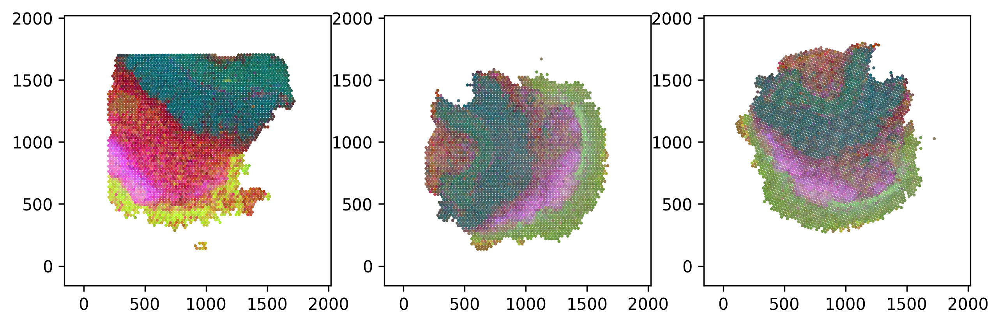

In [377]:
plot_alignment(ad_tar_coor, ad_src_coor, homo_coor, pca_hex_comb, tar_features, shift=300, s=0.8, boundary_line=False)

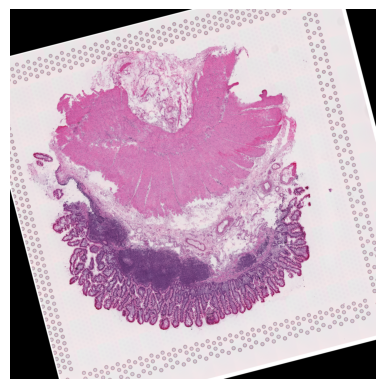

In [378]:
plt.imshow(aligned_image, origin='lower')
plt.axis('off')
plt.show()

In [379]:
save_name = 'omiclip_st_st_'+src_sample_name+'.h5ad'
wirte_aligned_data(ad_src, aligned_image, homo_coor, save_name)

## Omiclip Img to ST

In [380]:
generate_features_finetune10(src_sample_name)

100%|██████████| 3294/3294 [01:48<00:00, 30.24it/s]


In [381]:
case_name = '_finetune10'

In [382]:
tar_features = get_features(tar_sample_name, '_text_feature', case_name)
src_features = get_features(src_sample_name, '_image_feature', case_name)

In [383]:
pca_comb_features, pca_comb_features_batch = get_pca_by_fit(tar_features, src_features)

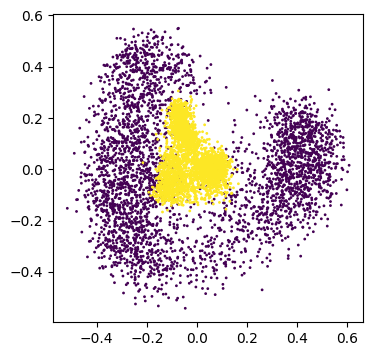

In [384]:
plt.figure(figsize=(4,4))
plt.scatter(pca_comb_features[:,0], pca_comb_features[:,1],c=pca_comb_features_batch, s=1)

In [385]:
alpha = 0.5
cpd_coor, homo_coor, aligned_image = cpd_align(ad_tar_coor, ad_src_coor, pca_comb_features, src_img, alpha)

In [386]:
# plot_alignment_with_img(ad_tar_coor, ad_src_coor, homo_coor, tar_img, src_img, aligned_image, pca_hex_comb, tar_features)

In [387]:
shift=300
s=0.8
# plot_alignment(ad_tar_coor, ad_src_coor, homo_coor, pca_hex_comb, tar_features, shift=300, s=0.8)

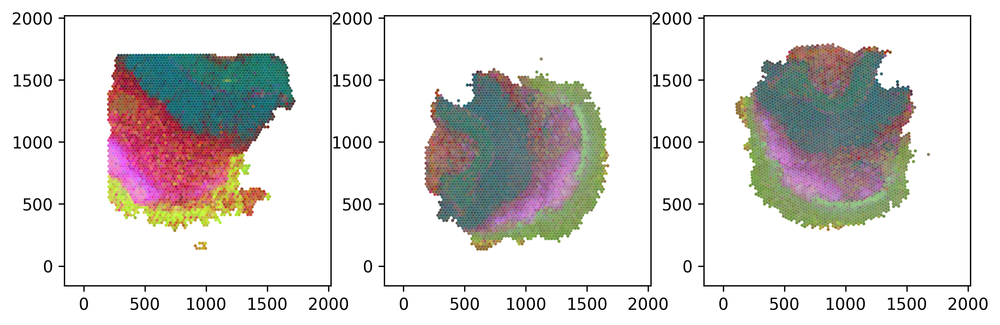

In [388]:
plot_alignment(ad_tar_coor, ad_src_coor, homo_coor, pca_hex_comb, tar_features, shift=300, s=0.8, boundary_line=False)

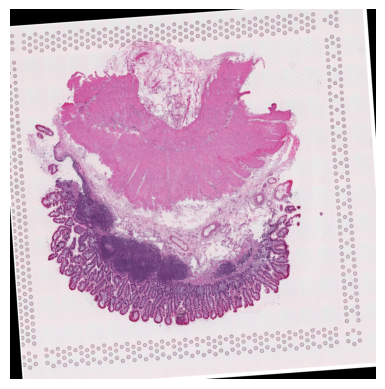

In [389]:
plt.imshow(aligned_image, origin='lower')
plt.axis('off')
plt.show()

In [390]:
save_name = 'omiclip_st_img_finetune10_'+src_sample_name+'.h5ad'
wirte_aligned_data(ad_src, aligned_image, homo_coor, save_name)

## Omiclip Results

In [88]:
omiclip_ad_tar = ad_tar.copy()
sc.pp.normalize_total(omiclip_ad_tar)
sc.pp.log1p(omiclip_ad_tar)
omiclip_ad_tar_heg_of_hvg = get_heg_of_hvg(omiclip_ad_tar, 300)

In [89]:
omiclip_ad_src_align_st = sc.read_h5ad(case_dir_omiclip+'omiclip_st_st_'+src_sample_name+'.h5ad')
omiclip_ad_src_align_img_ft = sc.read_h5ad(case_dir_omiclip+'omiclip_st_img_finetune10_'+src_sample_name+'.h5ad')
sc.pp.normalize_total(omiclip_ad_src_align_st)
sc.pp.log1p(omiclip_ad_src_align_st)
omiclip_ad_src_heg_of_hvg = get_heg_of_hvg(omiclip_ad_src_align_st, 300)

In [90]:
omiclip_genes = [value for value in omiclip_ad_tar_heg_of_hvg.index.tolist() if value in omiclip_ad_src_heg_of_hvg.index.tolist()]
len(omiclip_genes)

126

In [91]:
omiclip_ad_tar_mean_expr = get_mean_expr_by_neighbor(omiclip_ad_tar)
omiclip_ad_tar_mean_expr.reset_index(inplace=True, drop=True)
omiclip_ad_src_align_mean_expr = get_mean_expr_by_neighbor(omiclip_ad_src_align_st)
omiclip_ad_src_align_mean_expr.reset_index(inplace=True, drop=True)

100%|██████████| 3333/3333 [00:12<00:00, 263.72it/s]


In [92]:
scalef_tar = get_scalefactors(omiclip_ad_tar)['tissue_hires_scalef']
scalef_src = get_scalefactors(omiclip_ad_src_align_st)['tissue_hires_scalef']
omiclip_matches_st = nearest_neighbour(omiclip_ad_src_align_st.obsm['spatial']*scalef_src, omiclip_ad_tar.obsm['spatial']*scalef_tar)
omiclip_matches_img_ft = nearest_neighbour(omiclip_ad_src_align_img_ft.obsm['spatial']*scalef_src, omiclip_ad_tar.obsm['spatial']*scalef_tar)

Processing coordinates: 100%|██████████| 3333/3333 [00:46<00:00, 72.34it/s]


## Paste

In [98]:
paste_path = case_dir+'paste/'

In [ ]:
paste_align(src_sample_name)

In [107]:
paste_tar_ad = sc.read_h5ad(paste_path+'paste_aligment_target_'+src_sample_name+'.h5ad')
paste_align_ad = sc.read_h5ad(paste_path+'paste_aligment_source_'+src_sample_name+'.h5ad')
sc.pp.normalize_total(paste_tar_ad)
sc.pp.normalize_total(paste_align_ad)
sc.pp.log1p(paste_tar_ad)
sc.pp.log1p(paste_align_ad)

In [108]:
ad_src = sc.read_h5ad(os.path.join(data_dir, src_sample_name+'.h5ad'))
paste_shared_index = find_matching_indices(ad_src.obs.index.to_list(), paste_align_ad.obs.index.to_list())
paste_tar_coor = (paste_tar_ad.obsm['spatial']-paste_tar_ad.obsm['spatial'].min())/(paste_tar_ad.obsm['spatial'].max()-paste_tar_ad.obsm['spatial'].min())*(ad_tar_coor.max()-ad_tar_coor.min())
paste_align_coor = (paste_align_ad.obsm['spatial']-paste_tar_ad.obsm['spatial'].min())/(paste_tar_ad.obsm['spatial'].max()-paste_tar_ad.obsm['spatial'].min())*(ad_tar_coor.max()-ad_tar_coor.min())

In [ ]:
plt.figure(figsize=(4,4))
plt.scatter(paste_align_coor[:,0], paste_align_coor[:,1], s=5, c=[pca_hex_comb[len(tar_features.T):][i] for i in paste_shared_index[:,0]])

In [111]:
paste_ad_tar_mean_expr = get_mean_expr_by_neighbor(paste_tar_ad)
paste_ad_tar_mean_expr.reset_index(inplace=True,drop=True)
paste_ad_src_align_mean_expr = get_mean_expr_by_neighbor(paste_align_ad)
paste_ad_src_align_mean_expr.reset_index(inplace=True,drop=True)

100%|██████████| 2581/2581 [00:07<00:00, 326.47it/s]


In [112]:
paste_matches = nearest_neighbour(paste_align_coor, paste_tar_coor)

Processing coordinates: 100%|██████████| 2581/2581 [00:34<00:00, 75.81it/s]


(2334, 2)

## GPSA

In [127]:
gpsa_tar_ad = sc.read_h5ad(case_dir+'gpsa/gpsa_target_'+src_sample_name+'.h5ad')
gpsa_align_ad = sc.read_h5ad(case_dir+'gpsa/gpsa_alignment_'+src_sample_name+'.h5ad')

gpsa_align = pd.read_csv(case_dir+'gpsa/gpsa_align_coor_'+src_sample_name+'.csv', index_col=0)
gpsa_align = np.array(gpsa_align)
gpsa_tar = pd.read_csv(case_dir+'gpsa/gpsa_tar_coor_'+src_sample_name+'.csv', index_col=0)
gpsa_tar = np.array(gpsa_tar)

ad_src = sc.read_h5ad(os.path.join(data_dir, src_sample_name+'.h5ad'))
gpsa_shared_index = find_matching_indices(ad_src.obs.index.to_list(), gpsa_align_ad.obs.index.to_list())

gpsa_align_resize = (gpsa_align/10)*(ad_tar_coor.max(axis=0)-ad_tar_coor.min(axis=0))+ad_tar_coor.min(axis=0)
gpsa_tar_resize = (gpsa_tar/10)*(ad_tar_coor.max(axis=0)-ad_tar_coor.min(axis=0))+ad_tar_coor.min(axis=0)
gpsa_align_ad.obs[['newy', 'newx']] = gpsa_align_resize
gpsa_tar_ad.obs[['newy', 'newx']] = gpsa_tar_resize

In [ ]:
plt.figure(figsize=(4, 4))
plt.scatter(gpsa_align_resize[:,0], gpsa_align_resize[:,1], c = [pca_hex_comb[len(tar_features.T):][i] for i in gpsa_shared_index[:,0]],s=4)

In [ ]:
gpsa_ad_tar_mean_expr = get_mean_expr_by_dist(gpsa_tar_ad)
gpsa_ad_tar_mean_expr.reset_index(inplace=True, drop=True)
gpsa_ad_src_align_mean_expr = get_mean_expr_by_dist(gpsa_align_ad)
gpsa_ad_src_align_mean_expr.reset_index(inplace=True, drop=True)

In [133]:
shared_genes = [value for value in omiclip_genes if value in gpsa_ad_tar_mean_expr.columns.tolist()]
shared_genes = [value for value in shared_genes if value in gpsa_ad_src_align_mean_expr.columns.tolist()]
len(shared_genes)

96

In [129]:
gpsa_matches = nearest_neighbour(gpsa_align_resize, gpsa_tar_resize)
gpsa_matches.shape

Processing coordinates: 100%|██████████| 2607/2607 [00:39<00:00, 65.39it/s]


(2355, 2)

## Combine Analysis

In [134]:
omiclip_mse_st = pd.DataFrame()
omiclip_mse_st = calculate_mse(omiclip_mse_st, shared_genes, omiclip_ad_tar_mean_expr, omiclip_ad_src_align_mean_expr, omiclip_matches_st)
omiclip_mse_img_ft = pd.DataFrame()
omiclip_mse_img_ft = calculate_mse(omiclip_mse_img_ft, shared_genes, omiclip_ad_tar_mean_expr, omiclip_ad_src_align_mean_expr, omiclip_matches_img_ft)
paste_mse = pd.DataFrame()
paste_mse = calculate_mse(paste_mse, shared_genes, paste_ad_tar_mean_expr, paste_ad_src_align_mean_expr, paste_matches)
gpsa_mse = pd.DataFrame()
gpsa_mse = calculate_mse(gpsa_mse, shared_genes, gpsa_ad_tar_mean_expr, gpsa_ad_src_align_mean_expr, gpsa_matches)

100%|██████████| 96/96 [00:00<00:00, 618.55it/s]


In [144]:
all_mse = pd.concat([omiclip_mse_st['mse'], 
                     omiclip_mse_img_ft['mse'], 
                     gpsa_mse['mse'], 
                     paste_mse['mse'], 
                    ],axis=1)
all_mse.columns = ['omiclip_st','omiclip_img_ft','gpsa','paste']

In [ ]:
plt.figure(figsize=(2,3.5), dpi=150)
sns.boxplot(all_mse, showfliers=False, width=0.6, linecolor = 'black', linewidth=1, color='white')
plt.ylim((0,0.2))

In [139]:
ranksums(paste_mse['mse'], omiclip_mse_img_ft['mse'], alternative='greater')

RanksumsResult(statistic=4.703911971394518, pvalue=1.2761166249306994e-06)

In [140]:
ranksums(gpsa_mse['mse'], omiclip_mse_img_ft['mse'], alternative='greater')

RanksumsResult(statistic=4.514300942177622, pvalue=3.176297848652102e-06)

In [141]:
ranksums(omiclip_mse_img_ft['mse'], omiclip_mse_st['mse'], alternative='greater')

RanksumsResult(statistic=0.38701429251120006, pvalue=0.3493728134914188)

## PSR

In [324]:
def calculate_psr(psr_df, genes, tar_mean_expr, src_align_mean_expr, matches):
    psr_df = pd.DataFrame()
    for gene in tqdm(genes):
        psr = stats.pearsonr(tar_mean_expr.loc[matches[:,1], gene], src_align_mean_expr.loc[matches[:,0], gene])[0]
        psr_df.loc[gene, 'psr'] = psr
    return psr_df

In [325]:
omiclip_psr_st = calculate_psr(omiclip_psr_st, shared_genes_he_gpsa, ad_tar_mean_expr, ad_src_align_mean_expr, omiclip_matches_st)
omiclip_psr_img_ft = calculate_psr(omiclip_psr_img_ft, shared_genes_he_gpsa, ad_tar_mean_expr, ad_src_align_mean_expr, omiclip_matches_img_ft)
omiclip_psr_img_zs = calculate_psr(omiclip_psr_img_zs, shared_genes_he_gpsa, ad_tar_mean_expr, ad_src_align_mean_expr, omiclip_matches_img_zs)
paste_psr = calculate_psr(paste_psr, shared_genes_he_gpsa, paste_ad_tar_mean_expr, paste_ad_src_align_mean_expr, paste_matches)
gpsa_psr = calculate_psr(gpsa_psr, shared_genes_he_gpsa, gpsa_ad_tar_mean_expr, gpsa_ad_src_align_mean_expr, gpsa_matches)

100%|██████████| 106/106 [00:00<00:00, 498.52it/s]


In [332]:
all_psr = pd.concat([omiclip_psr_st['psr'], omiclip_psr_img_ft['psr'], omiclip_psr_img_zs['psr'], 
                     gpsa_psr['psr'], paste_psr['psr']],axis=1)
all_psr.columns = ['omiclip_st','omiclip_img_ft', 'omiclip_img_zs','gpsa','paste']
# all_psr

<Axes: >

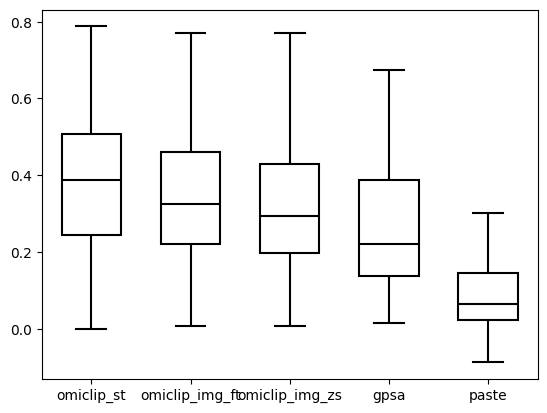

In [333]:
sns.boxplot(all_psr, showfliers=False,                                
            width=0.6,
                linecolor = 'black',
                linewidth=1.5, 
           color='white')

## Draft

In [306]:
ad_src_align_img_zs.X.todense().sum(axis=1)

matrix([[1112.6165 ],
        [1005.29144],
        [1225.1711 ],
        ...,
        [ 836.7591 ],
        [1069.6276 ],
        [1027.911  ]], dtype=float32)

In [299]:
omiclip_mse_st = pd.DataFrame()
for gene in tqdm(shared_genes_he):
    mse = mean_squared_error(np.array(omiclip_ad_tar[omiclip_matches_st[:,1], gene].X.todense().T)[0], np.array(ad_src_align_st[omiclip_matches_st[:,0], gene].X.todense().T)[0])
    omiclip_mse_st.loc[gene, 'mse'] = mse

100%|██████████| 112/112 [00:03<00:00, 34.99it/s]


In [300]:
omiclip_mse_img_ft = pd.DataFrame()
for gene in tqdm(shared_genes_he):
    mse = mean_squared_error(np.array(omiclip_ad_tar[omiclip_matches_img_ft[:,1], gene].X.todense().T)[0], np.array(ad_src_align_img_ft[omiclip_matches_img_ft[:,0], gene].X.todense().T)[0])
    omiclip_mse_img_ft.loc[gene, 'mse'] = mse

100%|██████████| 112/112 [00:03<00:00, 34.08it/s]


In [301]:
omiclip_mse_img_zs = pd.DataFrame()
for gene in tqdm(shared_genes_he):
    mse = mean_squared_error(np.array(omiclip_ad_tar[omiclip_matches_img_zs[:,1], gene].X.todense().T)[0], np.array(ad_src_align_img_zs[omiclip_matches_img_zs[:,0], gene].X.todense().T)[0])
    omiclip_mse_img_zs.loc[gene, 'mse'] = mse

100%|██████████| 112/112 [00:03<00:00, 34.48it/s]


In [289]:
paste_mse = pd.DataFrame()
for gene in tqdm(shared_genes_he):
    mse = mean_squared_error(np.array(new_slices[0][paste_matches[:,1], gene].X.todense().T)[0], np.array(new_slices[1][paste_matches[:,0], gene].X.todense().T)[0])
    paste_mse.loc[gene, 'mse'] = mse

100%|██████████| 112/112 [00:02<00:00, 38.35it/s]


In [290]:
gpsa_mse = pd.DataFrame()
for gene in tqdm(shared_genes_he_gpsa):
    mse = mean_squared_error(np.array(gpsa_tar_ad[gpsa_matches[:,1], gene].X.todense().T)[0], np.array(gpsa_align_ad[gpsa_matches[:,0], gene].X.todense().T)[0])
    gpsa_mse.loc[gene, 'mse'] = mse

100%|██████████| 106/106 [00:01<00:00, 74.20it/s]


In [302]:
all_mse = pd.concat([omiclip_mse_st.loc[shared_genes_he_gpsa,'mse'],
                     omiclip_mse_img_ft.loc[shared_genes_he_gpsa,'mse'], 
                    omiclip_mse_img_zs.loc[shared_genes_he_gpsa,'mse'], 
                    gpsa_mse['mse'], 
                     paste_mse.loc[shared_genes_he_gpsa,'mse'],
                    ],axis=1)
all_mse.columns = ['omiclip_st','omiclip_img_ft','omiclip_img_zs','gpsa','paste',]
all_mse

,omiclip_st,omiclip_img_ft,omiclip_img_zs,gpsa,paste
COL1A1,0.931628,1.002840,0.990247,1.087981,1.198119
MT-CYB,0.423433,0.424020,0.432458,0.407107,0.439538
COL1A2,0.855612,0.884748,0.900352,0.943614,0.994164
COL3A1,0.929507,0.977743,0.994024,1.006680,1.103068
CD74,0.576098,0.601879,0.619985,0.636326,0.685067
...,...,...,...,...,...
SOCS3,0.244949,0.242408,0.244803,0.245661,0.249543
YBX3,0.218605,0.219726,0.224854,0.218379,0.220540
IER2,0.247028,0.246207,0.246497,0.229888,0.249995
PRDX3,0.230744,0.224131,0.221417,0.207518,0.221634


<Axes: >

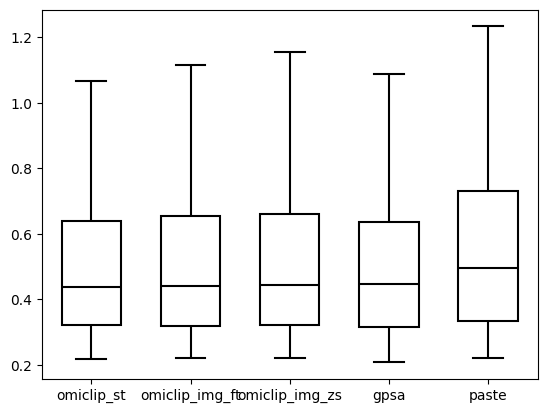

In [303]:
sns.boxplot(all_mse, showfliers=False,
                       width=0.6,
                linecolor = 'black',
                linewidth=1.5, 
           color='white')

In [293]:
wilcoxon(paste_mse.loc[shared_genes_he_gpsa,'mse'], omiclip_mse_img_zs.loc[shared_genes_he_gpsa,'mse'], alternative='greater')

WilcoxonResult(statistic=0.0, pvalue=1.0)

In [294]:
wilcoxon(gpsa_mse.loc[shared_genes_he_gpsa,'mse'], omiclip_mse_img_zs.loc[shared_genes_he_gpsa,'mse'], alternative='greater')

WilcoxonResult(statistic=0.0, pvalue=1.0)

In [295]:
wilcoxon(omiclip_mse_img_zs.loc[shared_genes_he_gpsa,'mse'], omiclip_mse_st.loc[shared_genes_he_gpsa,'mse'], alternative='greater')

WilcoxonResult(statistic=3696.0, pvalue=0.003341902473848393)

In [296]:
ranksums(paste_mse.loc[shared_genes_he_gpsa,'mse'], omiclip_mse_img_zs.loc[shared_genes_he_gpsa,'mse'], alternative='greater')

RanksumsResult(statistic=-7.0915802103772325, pvalue=0.9999999999993371)

In [297]:
ranksums(gpsa_mse.loc[shared_genes_he_gpsa,'mse'], omiclip_mse_img_zs.loc[shared_genes_he_gpsa,'mse'], alternative='greater')

RanksumsResult(statistic=-8.023091851525615, pvalue=0.9999999999999994)

In [298]:
ranksums(omiclip_mse_img_zs.loc[shared_genes_he_gpsa,'mse'], omiclip_mse_st.loc[shared_genes_he_gpsa,'mse'], alternative='greater')

RanksumsResult(statistic=0.05598026689593647, pvalue=0.4776787636210748)